# Contents

- [1 Data Cleaning](#data_cleaning)
  - [1.1 Drop $0 Opps](#drop_values)
  - [1.2 Opportunity Frequency Analysis](#opp_frequency_analysis)
  - [1.3 Drop Accounts with > 10 Opps & Drop Renewals](#drop_more_values)
- [2 EDA](#eda)
- [3 Data Preprocessing](#preprocessing)
  - [3.1 Feature Engineering](#feature_engineering)
    - [3.1.1 Marketing Touchpoints Timing](#touchpoints)
    - [3.1.2 Marketing Touchpoints Per Opp](#touchpoints_per_opp)
    - [3.1.3 Leads Engaged Per Opp](#leads_engaged_per_opp)
    - [3.1.4 Outcome Target Variable](#outcome)
    - [3.1.5 Bucketed Matrix & Segment Creation](#segments)
    - [3.1.6 Verticals](#verticals)
    - [3.1.7 Program Mix](#program_mix)
    - [3.1.8 Drop Duplicate Columns](#duplicate_columns)
  - [3.2 Define Preprocessor and Pipeline](#preprocessor_pipeline)
  - [3.3 Train/Test Split](#train_test_split)
  - [3.4 Apply Pipeline: Scaling, Encoding, and Model Training](#scaling_encoding)
- [4 Modeling](#modeling)
  - [4.1 Metrics](#metrics)
  - [4.2 Models](#models)
      - [4.2.1 Logistic Regression](#logistic_regression)
      - [4.2.2 Random Forest](#random_forest)
      - [4.2.3 Gradient Boosting](#gbm)
      - [4.2.4 Support Vector Machines (SVM)](#svm)
  - [4.3 Visualizing Feature Importances](#feature_importances)
    - [4.3.1 Hyperparameter Tuning](#hyperparameter_tuning)
    - [4.3.2 Model Training](#model_training)
    - [4.3.3 Adjusting the Classification Threshold](#classification_threshold)
    - [4.3.4 Perform Cross Validation](#cross_validation)
    - [4.3.5 Visualizing Feature Importances](#feature_importances)
    - [4.3.6 Conversion Rates by Persona](#conversion_rates)
  - [4.4 Build Segment Models](#segment_models)
    - [4.4.1 Testing Two Different Models to Reduce Overfitting](#testing_models)
  - [4.5 Segment Outcome Analysis](#segment_outcome_analysis)
    - [4.5.1 Examine Feature Importances](#examine_feature_importances)
    - [4.5.2 Program Mix Outcomes Per Segment](#program_mix_per_segment)
    - [4.5.3 Leads Attended & Distinct Touchpoints Analysis](#touchpoints_analysis)
    - [4.5.4 Segment Confidence Scores for Data Quantity](#confidence_scores)
    - [4.5.5 Vertical Analysis](#vertical_analysis)
  - [4.6 All-In-One Recommendation Generator](#rec_generator)
  - [4.7 Summary](#summary)

*NOTE: **All data within this Jupyter Notebook is synthetic data generated by AI; the fake data insights are for demonstration purposes only, used within a broader Marketing Decision Intelligence System tool I built within Streamlit**.*

# 1 Data Cleaning <a id="data_cleaning"></a>

In [32]:
%pip install matplotlib seaborn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import numpy as np
import os
import pickle
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

In [2]:
# File for programs with successdates
data_path = '/Users/joshuabe/Downloads/Predictive_Recommendations_Model_Streamlit/attribution_high_value_opps_synthetic.xlsx'
df = pd.read_excel(data_path, sheet_name='Sheet1')

In [3]:
df.head()

,row_num,opportunity_id,opportunity_name,createddate,closedate,successdate,membershipdate,amount_usd,type,stagename,...,solution,progression_status,industry,lead_id,persona,program_name,channel,title,account_id,account_name
0,1,22915,Opportunity 22915,2024-06-06,2024-07-12,2024-02-27,2024-01-28,47105.962350,Existing Customer,6,...,Product 5,Attended,Government,10949,"C-Level (Other – CEO, CFO, COO, etc.)",23-Q2-Pay Per Click 1,Pay Per Click,President,8318,Account 8318
1,2,3426,Opportunity 3426,2024-10-19,2024-11-19,2024-07-11,2024-06-07,24626.203379,Existing Customer,7,...,Product 2,Visited Booth,Engineering,21057,"C-Level (Other – CEO, CFO, COO, etc.)",24-Q1-Test Drive 11,Event,CFO,5318,Account 5318
2,3,30121,Opportunity 30121,2024-05-19,2024-08-11,2024-02-09,2024-01-08,65958.110917,Existing Customer,3,...,Product 1,Visited Booth,Finance & Banking,14293,"C-Level (CIO, CISO, CSO, CTO)",24-Q2-Contact request 7,Content Syndication,CSO,8816,Account 8816
3,4,5089,Opportunity 5089,2023-06-21,2023-08-07,2023-03-13,2023-01-18,41513.761672,New Customer,5,...,Product 3,Visited Booth,Hospitality,8553,"C-Level (CIO, CISO, CSO, CTO)",24-Q2-Pay Per Click 1,Tradeshow,CSO,2759,Account 2759
4,5,49138,Opportunity 49138,2024-04-03,2024-06-03,2023-12-25,2023-12-08,62629.804538,Existing Customer,1,...,Product 4,Attended,Engineering,7330,SOC – Security Operations Center,24-Q1-Web 13,Content Syndication,SOC Analyst,8206,Account 8206


## 1.1 Drop Null Values and $0 Opps <a id="drop_values"></a>

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 24 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   row_num               100000 non-null  int64         
 1   opportunity_id        100000 non-null  int64         
 2   opportunity_name      100000 non-null  object        
 3   createddate           100000 non-null  datetime64[ns]
 4   closedate             100000 non-null  datetime64[ns]
 5   successdate           100000 non-null  datetime64[ns]
 6   membershipdate        100000 non-null  datetime64[ns]
 7   amount_usd            100000 non-null  float64       
 8   type                  100000 non-null  object        
 9   stagename             100000 non-null  int64         
 10  type_sf               100000 non-null  object        
 11  region                100000 non-null  object        
 12  potential_arr_matrix  100000 non-null  object        
 13  

In [5]:
df.isna().sum()

row_num                 0
opportunity_id          0
opportunity_name        0
createddate             0
closedate               0
successdate             0
membershipdate          0
amount_usd              0
type                    0
stagename               0
type_sf                 0
region                  0
potential_arr_matrix    0
program_id              0
solution                0
progression_status      0
industry                0
lead_id                 0
persona                 0
program_name            0
channel                 0
title                   0
account_id              0
account_name            0
dtype: int64

In [6]:
# Drop all rows where either the 'title' or 'industry' is missing
df = df.dropna(subset=['title', 'industry'])

In [7]:
df.isna().sum()

row_num                 0
opportunity_id          0
opportunity_name        0
createddate             0
closedate               0
successdate             0
membershipdate          0
amount_usd              0
type                    0
stagename               0
type_sf                 0
region                  0
potential_arr_matrix    0
program_id              0
solution                0
progression_status      0
industry                0
lead_id                 0
persona                 0
program_name            0
channel                 0
title                   0
account_id              0
account_name            0
dtype: int64

In [8]:
df.shape

(100000, 24)

In [9]:
df['potential_arr_matrix'] = df['potential_arr_matrix'].fillna('Prospect')

We need to **refine the attribution model by defining a time window of six months from the created date of opportunities**. This will help ensure that only the marketing influence that's most relevant to our goal output of opening opps is included. 

In [10]:
df.dtypes.value_counts()

object            13
int64              6
datetime64[ns]     4
float64            1
Name: count, dtype: int64

In [11]:
# Filter to include rows where SuccessDate is within 6 months prior to CreatedDate
df = df[((df['createddate'] - df['successdate']).dt.days <= 180) & ((df['createddate'] - df['successdate']).dt.days >= 0)]

print(df)

       row_num  opportunity_id   opportunity_name createddate  closedate  \
0            1           22915  Opportunity 22915  2024-06-06 2024-07-12   
1            2            3426   Opportunity 3426  2024-10-19 2024-11-19   
2            3           30121  Opportunity 30121  2024-05-19 2024-08-11   
3            4            5089   Opportunity 5089  2023-06-21 2023-08-07   
4            5           49138  Opportunity 49138  2024-04-03 2024-06-03   
...        ...             ...                ...         ...        ...   
99995    99996            3718   Opportunity 3718  2023-09-30 2024-01-06   
99996    99997           32206  Opportunity 32206  2024-03-28 2024-05-24   
99997    99998           46719  Opportunity 46719  2025-01-31 2025-05-08   
99998    99999           49172  Opportunity 49172  2024-03-20 2024-07-05   
99999   100000           31142  Opportunity 31142  2023-12-23 2024-02-28   

      successdate membershipdate    amount_usd               type  stagename  \
0      

**We'll now drop $0 opps**. 

In [12]:
count_amount_usd_zero = df[df['amount_usd'] == 0].shape[0]
count_amount_usd_greater_than_zero = df[df['amount_usd'] > 0].shape[0]

print("Number of rows where amount_usd is 0:", count_amount_usd_zero)
print("Number of rows where amount_usd is greater than 0:", count_amount_usd_greater_than_zero)

Number of rows where amount_usd is 0: 620
Number of rows where amount_usd is greater than 0: 99380


In [13]:
df = df[(df['amount_usd'] != 0)]

In [14]:
df.shape

(99380, 24)

## 1.2 Opportunity Frequency Analysis <a id="opp_frequency_analysis"></a>

**Opportunity Frequency Analysis**: To perform an opportunity frequency analysis, we'll examine how frequently opportunities are closed for each account and potentially how these closed dates are spaced over time. This analysis can help determine the distribution of opportunities and assist in identifying suitable thresholds for filtering the data.

In [15]:
# Deduplicate data by account_id and opp_id to ensure unique opportunities
df_unique_opps = df.drop_duplicates(subset=['account_id', 'opportunity_id'])

# Sort data by account_id and createddate
df_unique_opps = df_unique_opps.sort_values(by=['account_id', 'createddate'])

# Calculate the difference in days between consecutive opportunities within the same account
df_unique_opps['days_between_opps'] = df_unique_opps.groupby('account_id')['createddate'].diff().dt.days

In [16]:
# Group by Account and count unique OpportunityIDs
account_opps_count = df_unique_opps.groupby('account_id')['opportunity_id'].nunique()

# Filter accounts with more than one unique opportunity and less than 5 unique opportunities
accounts_with_multiple_opps = account_opps_count[
    (account_opps_count > 1) & (account_opps_count < 5)
].index

# Filter the DataFrame to include only these accounts
df_filtered = df_unique_opps[df_unique_opps['account_id'].isin(accounts_with_multiple_opps)]

Let's see what the results are for accounts with > 1 and < 10 unique opps. 

In [17]:
# Deduplicate data by account_id and opp_id to ensure unique opportunities
df_unique_opps = df.drop_duplicates(subset=['account_id', 'opportunity_id'])

# Sort data by account_id and closedate
df_unique_opps = df_unique_opps.sort_values(by=['account_id', 'createddate'])

# Calculate the difference in days between consecutive opportunities within the same account
df_unique_opps['days_between_opps'] = df_unique_opps.groupby('account_id')['createddate'].diff().dt.days

In [18]:
# Group by Account and count unique OpportunityIDs
account_opps_count = df_unique_opps.groupby('account_id')['opportunity_id'].nunique()

# Filter accounts with more than one unique opportunity and less than 10 unique opportunities
accounts_with_multiple_opps = account_opps_count[
    (account_opps_count > 1) & (account_opps_count < 10)
].index

# Filter the DataFrame to include only these accounts
df_filtered = df_unique_opps[df_unique_opps['account_id'].isin(accounts_with_multiple_opps)]

mean      123.892260
median     91.000000
std       112.869823
Name: days_between_opps, dtype: float64


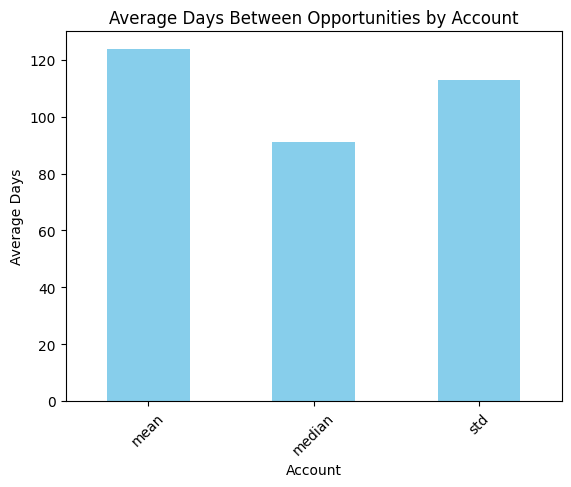

In [19]:
# Aggregate statistics for opportunity frequency per account
opportunity_stats = df_filtered['days_between_opps'].agg(['mean', 'median', 'std'])

print(opportunity_stats)

# Plotting
opportunity_stats.plot(kind='bar', color='skyblue')
plt.title('Average Days Between Opportunities by Account')
plt.xlabel('Account')
plt.ylabel('Average Days')
plt.xticks(rotation=45)
plt.show()

**Expanding the filter to include accounts with less than 10 unique opportunities is a logical step, especially given the consistency in the results (avg of 3.5 months vs 4.5 months) and the significant increase in the dataset size**.

Benefits of including accounts with less than 10 opps include: 
1. **Increased Data Volume**: 
2. **Maintained Statistical Consistency**: 
3. **Broader Representation**: 

There will inevitably be some overlap in having the same marketing influence for different opps, but that's acceptable since **by assuming shared influence, we acknowledge that a single campaign can affect multiple opportunities**, which is especially valid in scenarios where campaigns are near in time to multiple closed opps, and for broad campagaigns targeting entire markets or industries rather than individual leads. 

We'll check the distribution of accounts with different numbers of opportunities to ensure it’s balanced.

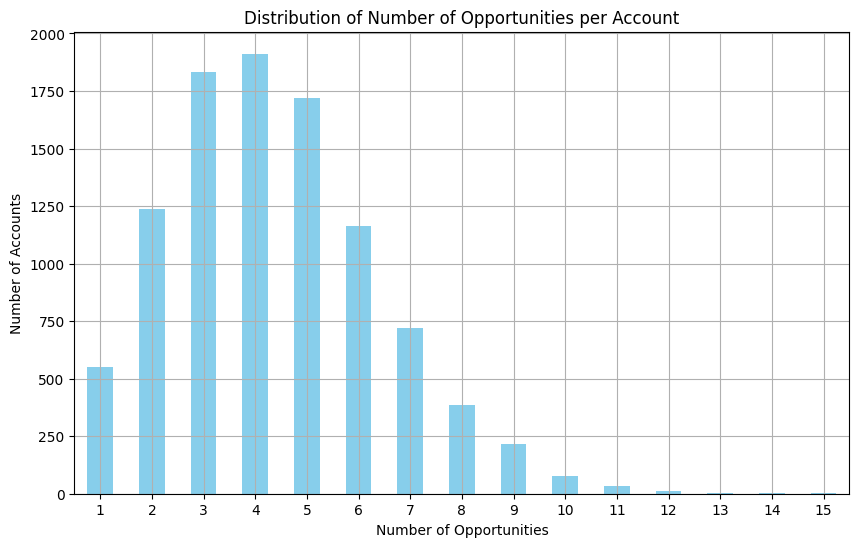

opportunity_id
1      550
2     1237
3     1832
4     1912
5     1718
6     1163
7      719
8      386
9      216
10      79
11      32
12      13
13       3
14       1
15       2
Name: count, dtype: int64


In [20]:
# Generate a frequency distribution of opportunity counts
opportunity_distribution = account_opps_count.value_counts().sort_index()

# Plot the distribution
plt.figure(figsize=(10, 6))
opportunity_distribution.plot(kind='bar', color='skyblue')
plt.title('Distribution of Number of Opportunities per Account')
plt.xlabel('Number of Opportunities')
plt.ylabel('Number of Accounts')
plt.xticks(rotation=0)
plt.grid(True)
plt.show()

# Print the distribution
print(opportunity_distribution)

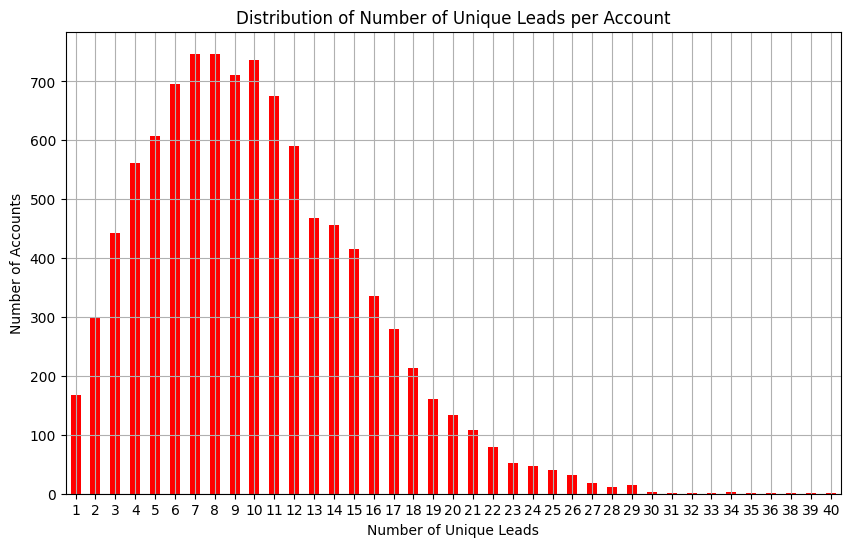

lead_id
1     168
2     300
3     443
4     562
5     608
6     696
7     746
8     747
9     711
10    736
11    676
12    591
13    468
14    456
15    415
16    335
17    279
18    213
19    160
20    134
21    109
22     79
23     52
24     47
25     41
26     31
27     18
28     11
29     14
30      3
31      1
32      2
33      2
34      3
35      1
36      2
38      1
39      1
40      1
Name: count, dtype: int64


In [21]:
# Group by Account and count unique LeadIDs
account_leads_count = df.groupby('account_id')['lead_id'].nunique()

# Generate a frequency distribution of lead counts
lead_distribution = account_leads_count.value_counts().sort_index()

# Plot the distribution
plt.figure(figsize=(10, 6))
lead_distribution.plot(kind='bar', color='red')
plt.title('Distribution of Number of Unique Leads per Account')
plt.xlabel('Number of Unique Leads')
plt.ylabel('Number of Accounts')
plt.xticks(rotation=0)
plt.grid(True)
plt.show()

# Print the distribution
print(lead_distribution)

In [22]:
df.shape

(99380, 24)

## 1.3 Drop Accounts with > 10 Opps & Drop Renewals <a id="drop_more_values"></a>

**We'll now filter the df to only include accounts with less than 10 unique opps**. 

In [23]:
# Filter accounts with less than 10 unique opportunities
accounts_with_less_than_ten_opps = account_opps_count[account_opps_count < 10
].index

# Filter the DataFrame to include only these accounts
df = df[(df['account_id'].isin(accounts_with_less_than_ten_opps))]

In [24]:
df.shape

(96193, 24)

And we'll drop renewals. 

In [25]:
df['type'].value_counts()

type
Existing Customer    48186
New Customer         48007
Name: count, dtype: int64

In [26]:
# Filter out rows where 'type' column is 'Existing Customer - Renewal'
df = df[df['type'] != 'Existing Customer - Renewal']

In [27]:
df.shape

(96193, 24)

# 2 EDA <a id="eda"></a>

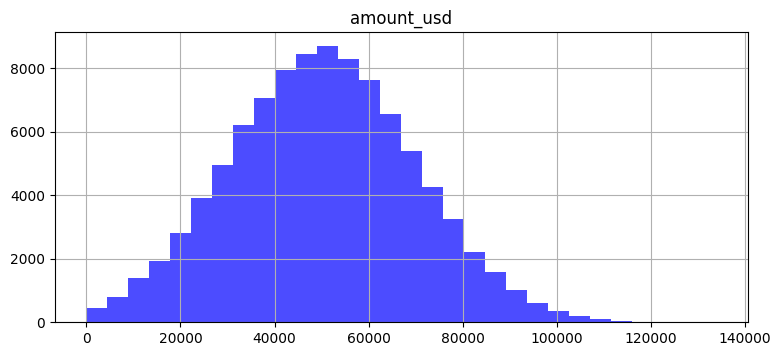

In [28]:
# Histograms of Numerical Features: 

# Selecting the numerical features for histograms
features = ['amount_usd']

# Creating histograms for selected features
plt.figure(figsize=(15, 10))

for i, feature in enumerate(features):
    plt.subplot(3, 2, i + 1)  # Create subplots in a 3x2 layout
    plt.hist(df[feature], bins=30, alpha=0.7, color='blue')
    plt.title(feature)
    plt.grid(True)

plt.tight_layout()
plt.show()

In [29]:
df.describe(percentiles=[.25, .5, .75, .9]).T

,count,mean,min,25%,50%,75%,90%,max,std
row_num,96193.0,49993.057582,1.0,24973.0,50004.0,74988.0,90006.8,99999.0,28877.968468
opportunity_id,96193.0,24951.856985,1.0,12473.0,25058.0,37399.0,44943.8,50000.0,14401.303408
createddate,96193,2024-04-09 16:13:25.979644928,2023-04-11 00:00:00,2023-10-11 00:00:00,2024-04-09 00:00:00,2024-10-09 00:00:00,2025-01-27 00:00:00,2025-04-09 00:00:00,NaN
closedate,96193,2024-06-23 05:50:43.793207296,2023-05-11 00:00:00,2023-12-24 00:00:00,2024-06-22 00:00:00,2024-12-23 00:00:00,2025-04-11 00:00:00,2025-08-06 00:00:00,NaN
successdate,96193,2023-12-31 16:13:25.979644928,2023-01-01 00:00:00,2023-07-03 00:00:00,2023-12-31 00:00:00,2024-07-01 00:00:00,2024-10-19 00:00:00,2024-12-30 00:00:00,NaN
membershipdate,96193,2023-12-02 04:16:24.271204864,2022-11-03 00:00:00,2023-06-03 00:00:00,2023-12-01 00:00:00,2024-06-01 00:00:00,2024-09-19 00:00:00,2024-12-30 00:00:00,NaN
amount_usd,96193.0,50328.329608,1.5407,36729.933171,50170.628973,63517.307433,75639.75321,133883.548108,19489.123133
stagename,96193.0,5.497801,1.0,3.0,6.0,8.0,10.0,10.0,2.877535
program_id,96193.0,64.392357,1.0,32.0,64.0,96.0,116.0,128.0,36.964532
lead_id,96193.0,12507.218956,1.0,6271.0,12465.0,18794.0,22517.0,25000.0,7221.907567


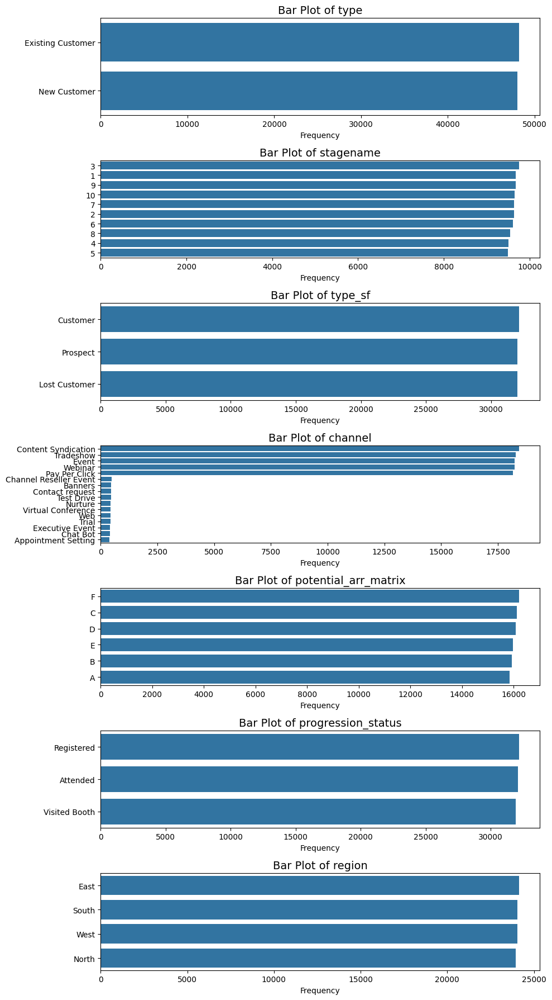

In [30]:
# Defining the categorical columns
categorical_columns = ['type', 'stagename', 'type_sf', 
                       'channel', 'potential_arr_matrix', 'progression_status', 'region']

# Creating a figure with subplots for bar plots
fig, axes = plt.subplots(nrows=len(categorical_columns), figsize=(10, 18))

# Plotting bar plots for each categorical feature
for i, col in enumerate(categorical_columns):
    sns.countplot(y=df[col], order=df[col].value_counts().index, ax=axes[i])
    axes[i].set_title(f'Bar Plot of {col}', fontsize=14)
    axes[i].set_xlabel('Frequency')
    axes[i].set_ylabel('')

# Adjust layout
plt.tight_layout()
plt.show()

In [31]:
# Drop rows where Channel is 'Email Blast' or 'Email Series'
df = df[~df['channel'].isin(['Email Blast', 'Email Series'])]

In [32]:
# Filter out rows where 'Channel' column is 'List Purchase'
df = df[df['channel'] != 'List Purchase']

In [33]:
unique_channel = df['channel'].unique()
print(unique_channel)

['Pay Per Click' 'Event' 'Content Syndication' 'Tradeshow' 'Webinar'
 'Banners' 'Nurture' 'Contact request' 'Channel Reseller Event' 'Web'
 'Virtual Conference' 'Test Drive' 'Trial' 'Chat Bot' 'Executive Event'
 'Appointment Setting']


Let's generate a **strip plot** to see which, if any, categorical variables correlate to the output of opp amount.

/var/folders/f1/45chrzq12pg_3pbz7ttrc5v00000gn/T/ipykernel_15911/1156673795.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])


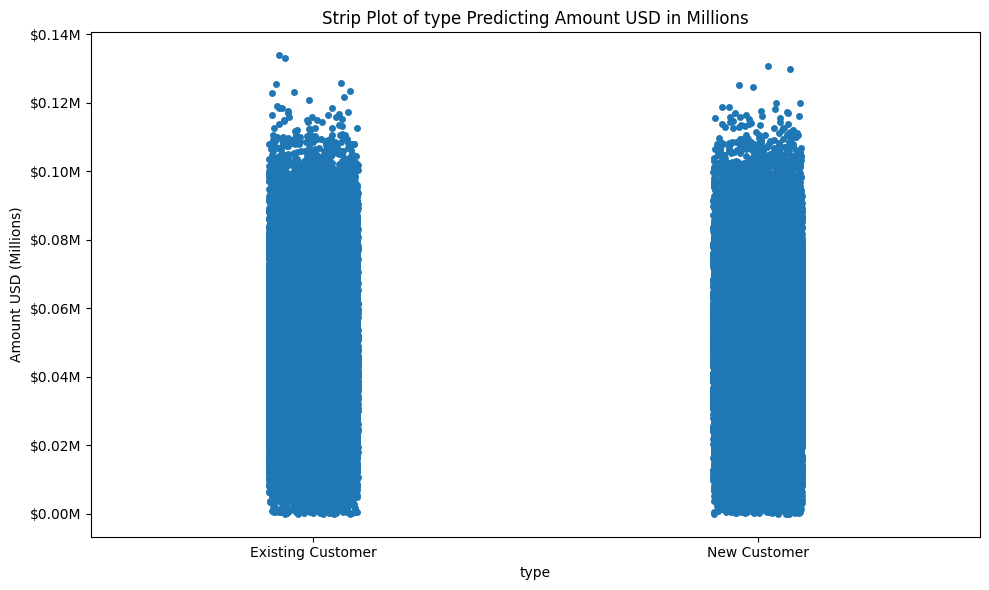

/var/folders/f1/45chrzq12pg_3pbz7ttrc5v00000gn/T/ipykernel_15911/1156673795.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])


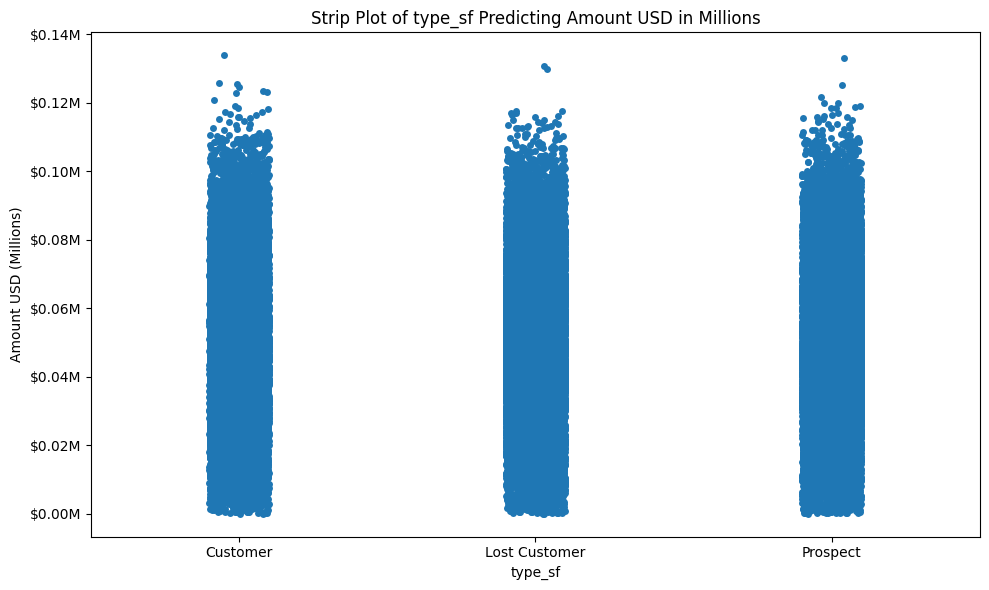

/var/folders/f1/45chrzq12pg_3pbz7ttrc5v00000gn/T/ipykernel_15911/1156673795.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])


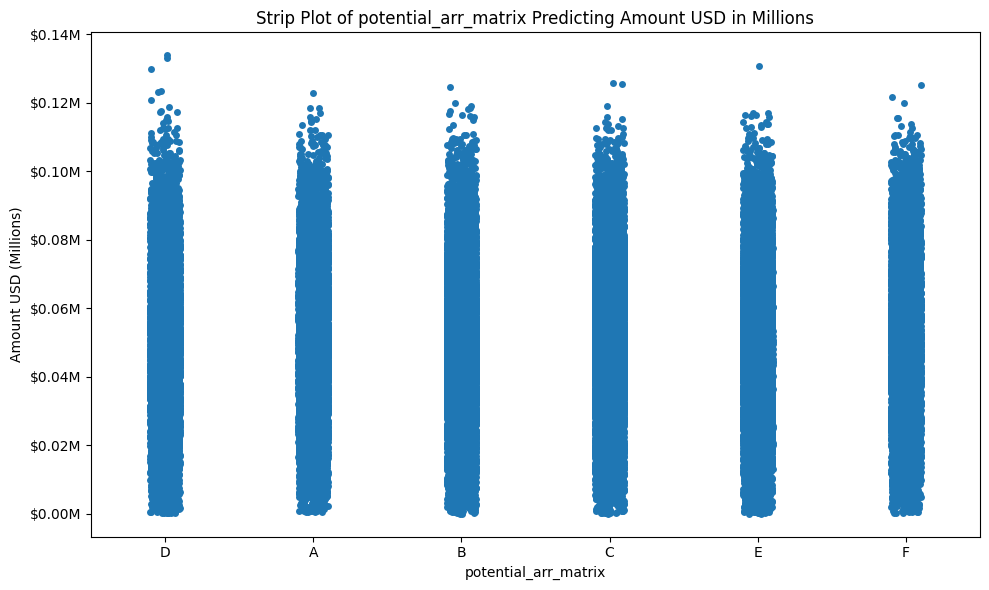

/var/folders/f1/45chrzq12pg_3pbz7ttrc5v00000gn/T/ipykernel_15911/1156673795.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])


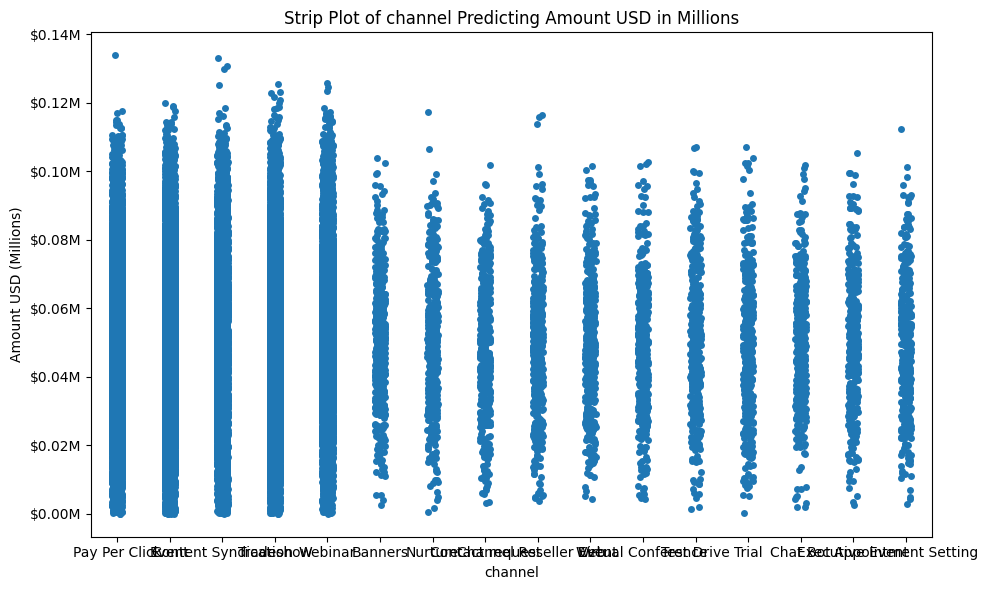

/var/folders/f1/45chrzq12pg_3pbz7ttrc5v00000gn/T/ipykernel_15911/1156673795.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])


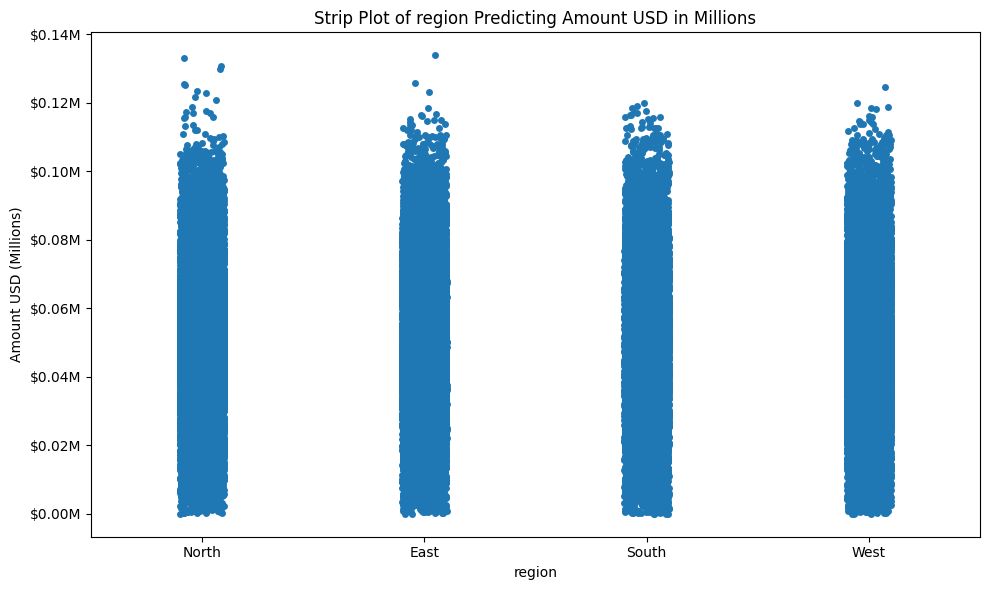

/var/folders/f1/45chrzq12pg_3pbz7ttrc5v00000gn/T/ipykernel_15911/1156673795.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])


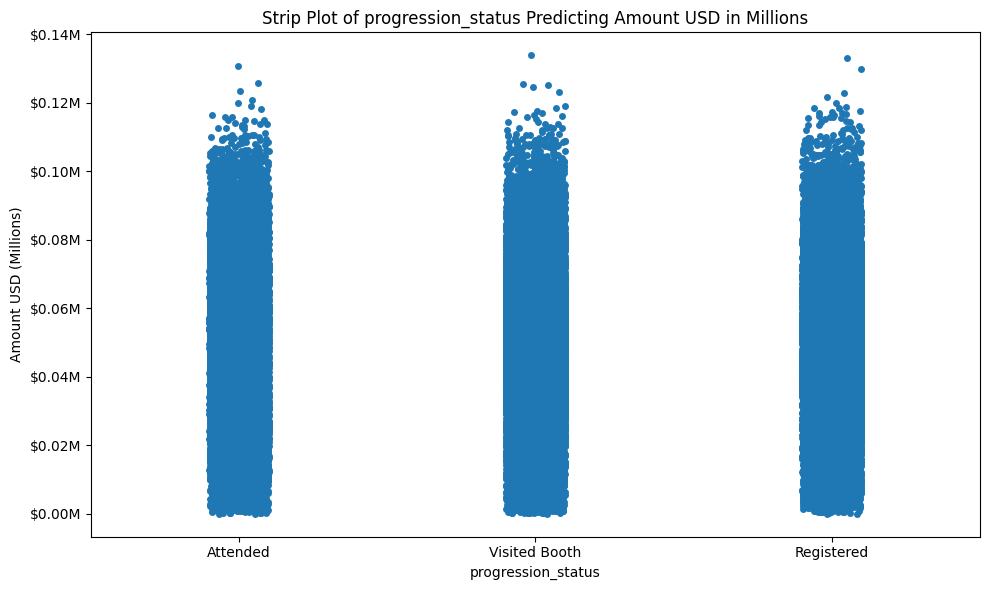

In [34]:
categorical_cols = df[['type', 'type_sf', 'potential_arr_matrix', 'channel', 'region', 'progression_status']]

# Loop through each categorical column and create a strip plot
for col in categorical_cols:
    plt.figure(figsize=(10, 6))
    sns.stripplot(x=col, y='amount_usd', data=df, jitter=True)
    
    # Adjusting the y-axis to display amounts in millions
    plt.gca().set_yticklabels(['${:,.2f}M'.format(y/1e6) for y in plt.gca().get_yticks()])
    
    plt.title(f'Strip Plot of {col} Predicting Amount USD in Millions')
    plt.xlabel(col)
    plt.ylabel('Amount USD (Millions)')
    plt.tight_layout()  # Adjust layout to make room for plot elements
    plt.show()

In [35]:
df.shape

(96193, 24)

# 3 Data Preprocessing <a id="preprocessing"></a>

In [36]:
%pip install scipy

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [37]:
%pip install scikit-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [38]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import matplotlib.ticker as tick
import sklearn.model_selection

from sklearn import neighbors, datasets, preprocessing
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.preprocessing import Normalizer
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, learning_curve

## 3.1 Feature Engineering <a id="feature_engineering"></a>

### 3.1.1 Marketing Touchpoints Timing <a id="touchpoints"></a>

First, we'll engineer a separate feature for each Channel + Opp Open Timing (ex: Webinar 1-2 months prior to open, Webinar 3-4 months prior to open, Event 5-6 month prior to open, Event 3-4 months prior to open, etc.). We'll do this for the **top channels for up to 6 months prior to opp opening**. 

In [39]:
df['channel'].value_counts()

channel
Content Syndication       18431
Tradeshow                 18295
Event                     18251
Webinar                   18236
Pay Per Click             18177
Channel Reseller Event      474
Banners                     464
Contact request             460
Test Drive                  448
Nurture                     440
Virtual Conference          440
Web                         434
Trial                       432
Executive Event             414
Chat Bot                    410
Appointment Setting         387
Name: count, dtype: int64

In [43]:
# Define list of channels
channels = ['Content Syndication', 'Event', 'Webinar', 'Tradeshow', 'Pay Per Click']

In [44]:
# Calculate the month difference between the success date and the opportunity created date
df['month_diff'] = ((df['createddate'] - df['successdate']) / pd.Timedelta(days=30)).apply(lambda x: int(x) if pd.notnull(x) else np.nan)

# Instead of filtering out rows here, carry this column for further processing
# Ensure that only activities up to 6 months before creation are considered in further steps, without removing rows
df['filter_month_diff'] = (df['month_diff'] > 0) & (df['month_diff'] <= 6)

# Define bucket ranges
buckets = [(1, 2), (3, 4), (5, 6)]
bucket_labels = ['1-2M', '3-4M', '5-6M']

# Initialize a dictionary to store the new columns
new_columns = {}

# Loop through channels and bucket ranges
for channel in channels:
    for (start, end), label in zip(buckets, bucket_labels):
        feature_name = f'{channel}_{label}_Before_Open'
        # Create the new column as a series indicating presence within the bucket range
        mask = (df['channel'] == channel) & (df['filter_month_diff']) & (df['month_diff'] >= start) & (df['month_diff'] <= end)
        new_columns[feature_name] = mask.astype(int)  # Safely convert boolean mask to integer

# Concatenate all new columns with the original DataFrame
df = pd.concat([df, pd.DataFrame(new_columns, index=df.index)], axis=1)

In [45]:
df.head()

,row_num,opportunity_id,opportunity_name,createddate,closedate,successdate,membershipdate,amount_usd,type,stagename,...,Event_5-6M_Before_Open,Webinar_1-2M_Before_Open,Webinar_3-4M_Before_Open,Webinar_5-6M_Before_Open,Tradeshow_1-2M_Before_Open,Tradeshow_3-4M_Before_Open,Tradeshow_5-6M_Before_Open,Pay Per Click_1-2M_Before_Open,Pay Per Click_3-4M_Before_Open,Pay Per Click_5-6M_Before_Open
0,1,22915,Opportunity 22915,2024-06-06,2024-07-12,2024-02-27,2024-01-28,47105.962350,Existing Customer,6,...,0,0,0,0,0,0,0,0,1,0
1,2,3426,Opportunity 3426,2024-10-19,2024-11-19,2024-07-11,2024-06-07,24626.203379,Existing Customer,7,...,0,0,0,0,0,0,0,0,0,0
2,3,30121,Opportunity 30121,2024-05-19,2024-08-11,2024-02-09,2024-01-08,65958.110917,Existing Customer,3,...,0,0,0,0,0,0,0,0,0,0
3,4,5089,Opportunity 5089,2023-06-21,2023-08-07,2023-03-13,2023-01-18,41513.761672,New Customer,5,...,0,0,0,0,0,1,0,0,0,0
4,5,49138,Opportunity 49138,2024-04-03,2024-06-03,2023-12-25,2023-12-08,62629.804538,Existing Customer,1,...,0,0,0,0,0,0,0,0,0,0


In [46]:
# Aggregate features at an opportunity level without dropping rows with NaN in 'month_diff'
features = [f'{ch}_{rng}_Before_Open' for ch in channels for rng in bucket_labels]
aggregated_features = df.groupby('opportunity_id')[features].sum().reset_index()

print(aggregated_features)

       opportunity_id  Content Syndication_1-2M_Before_Open  \
0                   1                                     0   
1                   2                                     0   
2                   3                                     0   
3                   4                                     0   
4                   5                                     0   
...               ...                                   ...   
41796           49993                                     0   
41797           49995                                     0   
41798           49997                                     0   
41799           49999                                     0   
41800           50000                                     0   

       Content Syndication_3-4M_Before_Open  \
0                                         1   
1                                         1   
2                                         0   
3                                         0   
4       

Let's count the distinct opportunity_ids for each of these touchpoint features where the features value = 1. 

In [47]:
# List of the feature columns to count distinct opportunity IDs
feature_columns = [f'{channel}_{label}_Before_Open' for channel in channels for label in bucket_labels]

# Initialize an empty dictionary to store the counts for each feature
distinct_opps_per_feature = {}

# Loop through each feature, filter for rows where the feature equals 1, and count distinct opportunity IDs
for feature in feature_columns:
    count = df[df[feature] == 1]['opportunity_id'].nunique()
    distinct_opps_per_feature[feature] = count

# Convert the dictionary to a DataFrame for better visualization
distinct_opps_df = pd.DataFrame(list(distinct_opps_per_feature.items()), columns=['Feature', 'Distinct_Opps_Count'])

# Display the DataFrame
print(distinct_opps_df.sort_values(by='Distinct_Opps_Count', ascending=False))

                                 Feature  Distinct_Opps_Count
1   Content Syndication_3-4M_Before_Open                15362
4                 Event_3-4M_Before_Open                15238
10            Tradeshow_3-4M_Before_Open                15228
13        Pay Per Click_3-4M_Before_Open                15219
7               Webinar_3-4M_Before_Open                15181
0   Content Syndication_1-2M_Before_Open                    0
2   Content Syndication_5-6M_Before_Open                    0
3                 Event_1-2M_Before_Open                    0
5                 Event_5-6M_Before_Open                    0
6               Webinar_1-2M_Before_Open                    0
8               Webinar_5-6M_Before_Open                    0
9             Tradeshow_1-2M_Before_Open                    0
11            Tradeshow_5-6M_Before_Open                    0
12        Pay Per Click_1-2M_Before_Open                    0
14        Pay Per Click_5-6M_Before_Open                    0


In [48]:
df.shape

(96193, 41)

### 3.1.2 Marketing Touchpoints Per Opp <a id="touchpoints_per_opp"></a>

Now let's engineer a feature for showing the number of marketing touchpoints per opp. 

To do this, I'll need to count the distinct combos of program success date and channel (since you can have multiple marketing channels occurring on the same day, and thus they'd have the same program success date, so you can't just count distinct success dates otherwise this would show as 1 touchpoint rather than 2). This needs to be rolled up to the opp level (opportunityid). 

In [49]:
# Ensure successdate is datetime
df['successdate'] = pd.to_datetime(df['successdate'], errors='coerce')

# Create touchpointid
df['touchpointid'] = df.apply(
    lambda x: f"{x['successdate'].strftime('%Y-%m-%d')} | {x['channel']}"
    if pd.notna(x['successdate']) else 'No Date',
    axis=1
)

# Count distinct touchpoints
distinct_touchpoints = (
    df.groupby('opportunity_id')['touchpointid']
    .apply(lambda x: x[x != 'No Date'].nunique())
    .reset_index(name='distinct_touchpoints')
)

# Merge
df = pd.merge(df, distinct_touchpoints, on='opportunity_id', how='left')
df['distinct_touchpoints'] = df['distinct_touchpoints'].fillna(0)

In [50]:
df.distinct_touchpoints.unique()

array([ 2,  4,  1,  5,  3,  7,  6,  8,  9, 10])

In [51]:
df.stagename.unique()

array([ 6,  7,  3,  5,  1,  2,  9, 10,  8,  4])

In [52]:
# Filter for high value opportunities (greater than $50k)
high_value_df = df[df['amount_usd'] > 50000]

# Calculate average number of touchpoints for high value opps
avg_touchpoints_high_value = high_value_df['distinct_touchpoints'].mean()
print(f"Average Number of Touchpoints for High Value Opportunities (> $50k): {avg_touchpoints_high_value}")

# Filter for low value opportunities (less than or equal to $50k)
low_value_df = df[df['amount_usd'] <= 50000]

# Calculate average number of touchpoints for low value opps
avg_touchpoints_low_value = low_value_df['distinct_touchpoints'].mean()
print(f"Average Number of Touchpoints for Low Value Opportunities (<= $50k): {avg_touchpoints_low_value}")

Average Number of Touchpoints for High Value Opportunities (> $50k): 2.9877338619749723
Average Number of Touchpoints for Low Value Opportunities (<= $50k): 2.98009085770511


In [53]:
df.shape

(96193, 43)

**Feature to Engineer: leads (lead_id) engaged per opp (opportunity_id) within an account (account_id)**. This might be a feature I should engineer, since I've previously found that the more leads that we have engaging within a specific account, the more likely that account is to open an opp. 


### 3.1.3 Leads Engaged Per Opp <a id="leads_engaged_per_opp"></a>

In [54]:
# Ensure 'successdate' is not null only for the calculation
df['leads_engaged_per_opp'] = df[df['successdate'].notna()].groupby('opportunity_id')['lead_id'].transform(lambda x: x.nunique())

# Replace NaN with 0 in case some opportunities have no successful leads
df['leads_engaged_per_opp'].fillna(0)

0        2
1        2
2        2
3        4
4        1
        ..
96188    2
96189    3
96190    5
96191    1
96192    4
Name: leads_engaged_per_opp, Length: 96193, dtype: int64

**Leads Attended Per Opp**: 

In [55]:
# Filter the DataFrame to include only rows where 'progression_status' contains "Visited Booth" or "Attended"
filtered_df = df[df['progression_status'].str.contains("Visited Booth|Attended", na=False)]

# Group by 'opportunity_id' and count distinct 'lead_id'
leads_attended_counts = filtered_df.groupby('opportunity_id')['lead_id'].nunique().reset_index(name='leads_attended_per_opp')

# Merge this count back to the original DataFrame to attach each opportunity with the calculated metric
df = pd.merge(df, leads_attended_counts, on='opportunity_id', how='left')

# Fill NaN with 0 in case some opportunities have no attended leads
df['leads_attended_per_opp'] = df['leads_attended_per_opp'].fillna(0)

# Print the DataFrame to verify the results
print(df[['opportunity_id', 'leads_attended_per_opp']].head())

   opportunity_id  leads_attended_per_opp
0           22915                     2.0
1            3426                     2.0
2           30121                     2.0
3            5089                     1.0
4           49138                     1.0


In [56]:
print("Mean of Leads Attended Per Opp", df['leads_attended_per_opp'].mean())
print("Median of Leads Attended Per Opp", df['leads_attended_per_opp'].median())

Mean of Leads Attended Per Opp 1.989271568617259
Median of Leads Attended Per Opp 2.0


In [58]:
# Count total unique opps in dataset
df['opportunity_id'].nunique()

41801

### 3.1.4 Outcome Target Variable <a id="outcome"></a>

In [59]:
df_opps_over_50k = df[df['amount_usd'] > 50000]
print("Total Opps w/ Amount > $50k:", df_opps_over_50k['opportunity_id'].nunique())
print("Total Accounts w/ Opp Amount > $50k:", df_opps_over_50k['account_id'].nunique())

df_opps_under_50k = df[df['amount_usd'] <= 50000]
print("Total Opps w/ Amount <= $50k:", df_opps_under_50k['opportunity_id'].nunique())
print("Total Accounts w/ Opp Amount <= $50k:", df_opps_under_50k['account_id'].nunique())

df_accounts_no_opps = df[df['createddate'].isna()]
print("Total Accounts With No Opps:", df_accounts_no_opps['account_id'].nunique())

Total Opps w/ Amount > $50k: 30564
Total Accounts w/ Opp Amount > $50k: 9445
Total Opps w/ Amount <= $50k: 30477
Total Accounts w/ Opp Amount <= $50k: 9425
Total Accounts With No Opps: 0


We also need to **engineer a binary feature showing: one class for high value opps (> $50k), the other for opps <= 50k amount_usd (label = low value opps)**. 

**This newly created outcome feature can be used as a target variable in a classification model to predict the likelihood of opening a high value opp.**

In [60]:
df['outcome'] = (df['amount_usd'] > 50000).astype(int)

In [61]:
df['outcome'].dtype

dtype('int64')

In [62]:
# Convert 'outcome' from int64 to categorical using .loc to ensure the operation is performed on the actual DataFrame
df.loc[:, 'outcome'] = df['outcome'].astype('category')

### 3.1.5 Bucketed Matrix & Segment Creation <a id="segments"></a>

In [63]:
# Define the values to replace and their new value
replacements = {
    'CISO': 'C-Level (CIO, CISO, CSO, CTO)',
    'Director': 'Senior Management (Directors, VPs)',
    'Vice President': 'Senior Management (Directors, VPs)',
    'SOC - Security Operations Center': 'IT/Security'
}

# Replace the values in the 'column_name' column
df['persona'] = df['persona'].replace(replacements)

# Verify the changes
print(df['persona'].value_counts())

persona
Technical (Architect, Engineer, Analyst, Specialist, Developer)    13826
C-Level (CIO, CISO, CSO, CTO)                                      13825
Other                                                              13816
Senior Management (Directors, VPs)                                 13792
IT/Security                                                        13760
SOC – Security Operations Center                                   13616
C-Level (Other – CEO, CFO, COO, etc.)                              13558
Name: count, dtype: int64


We'll create a **new feature that buckets potential_arr_matrix into two categories based on high potential (ACE) vs low potential (BDF)**. Then, we'll combine this new feature with region and persona to create a unified interaction feature. 

In [64]:
# Mapping potential_arr_matrix to two categories
matrix_map = {
    'A': 'High Potential',
    'C': 'High Potential',
    'E': 'High Potential',
    'B': 'Low Potential',
    'D': 'Low Potential',
    'F': 'Low Potential'
}

df['bucketed_matrix'] = df['potential_arr_matrix'].map(matrix_map)

# Check to ensure the mapping went as planned
print(df[['potential_arr_matrix', 'bucketed_matrix']])

      potential_arr_matrix bucketed_matrix
0                        D   Low Potential
1                        A  High Potential
2                        A  High Potential
3                        A  High Potential
4                        B   Low Potential
...                    ...             ...
96188                    F   Low Potential
96189                    B   Low Potential
96190                    E  High Potential
96191                    A  High Potential
96192                    A  High Potential

[96193 rows x 2 columns]


In [65]:
type_map = {
    'Customer': 'Customer',
    'Lost Customer': 'Prospect',
    'Prospect': 'Prospect'
}

df['account_type'] = df['type_sf'].map(type_map)

# Check to ensure the mapping went as planned
print(df[['type_sf', 'account_type']])

             type_sf account_type
0           Customer     Customer
1           Customer     Customer
2      Lost Customer     Prospect
3      Lost Customer     Prospect
4      Lost Customer     Prospect
...              ...          ...
96188  Lost Customer     Prospect
96189  Lost Customer     Prospect
96190  Lost Customer     Prospect
96191       Customer     Customer
96192       Customer     Customer

[96193 rows x 2 columns]


In [66]:
# Replace NaN in bucketed_matrix with '' only when account_type is 'Prospect'
df['bucketed_matrix_cleaned'] = np.where(
    df['account_type'] == 'Prospect',
    '',
    df['bucketed_matrix'].fillna('')  # Optional: handle any remaining nulls for non-Prospects
)

# Create the combined feature
df['account_type_matrix'] = df['account_type'] + '_' + df['bucketed_matrix_cleaned']

# Create the combined feature with region
df['region_type'] = df['region'] + '_' + df['account_type_matrix']

# Drop the helper column after creation
df.drop('bucketed_matrix_cleaned', axis=1, inplace=True)

# View result
print(df[['region', 'account_type_matrix', 'region_type']])

      region      account_type_matrix                    region_type
0      North   Customer_Low Potential   North_Customer_Low Potential
1       East  Customer_High Potential   East_Customer_High Potential
2      South                Prospect_                South_Prospect_
3       West                Prospect_                 West_Prospect_
4      North                Prospect_                North_Prospect_
...      ...                      ...                            ...
96188  North                Prospect_                North_Prospect_
96189   West                Prospect_                 West_Prospect_
96190   East                Prospect_                 East_Prospect_
96191  South  Customer_High Potential  South_Customer_High Potential
96192  North  Customer_High Potential  North_Customer_High Potential

[96193 rows x 3 columns]


In [67]:
# Count the number of rows for each category in 'region_type'
counts = df['region_type'].value_counts()

# Sort the counts in descending order
sorted_counts = counts.sort_values(ascending=False)

# Display the sorted counts
print(sorted_counts)

region_type
East_Prospect_                   16140
West_Prospect_                   15981
South_Prospect_                  15972
North_Prospect_                  15954
West_Customer_Low Potential       4077
South_Customer_Low Potential      4064
East_Customer_Low Potential       4024
South_Customer_High Potential     4018
North_Customer_High Potential     4003
North_Customer_Low Potential      4000
West_Customer_High Potential      3989
East_Customer_High Potential      3971
Name: count, dtype: int64


### 3.1.6 Verticals <a id="verticals"></a>

We'll create a **new feature called 'vertical' that buckets the 'industry' field into broader categories**, which involves mapping each specific industry to one of our defined verticals. Due to the complexity of matching potentially hundreds of unique industry descriptions to a limited number of verticals, employing a fuzzy matching approach is practical. 

In [68]:
pip install fuzzywuzzy

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [69]:
import pandas as pd
from fuzzywuzzy import process

verticals = [
    "Technology & IT", "Insurance", "Finance & Banking",
    "Education", "Government", "Healthcare", "Manufacturing", "Retail", "Consulting", "Electronics", 
    "Transportation", "Media", "Entertainment", "Energy and Utilities", "Chemicals", 
    "Biotechnology", "Engineering", "Machinery", "Construction", "Not for Profit", "Hospitality", "Food & Beverage", 
    "Communications", "Agriculture", "Shipping", "Other"
]

# Function to match industry to vertical
def match_to_vertical(industry, verticals):
    # Returns the vertical that has the highest similarity score to the industry
    return process.extractOne(industry, verticals)[0]

df['vertical'] = df['industry'].apply(lambda x: match_to_vertical(x, verticals))

# Check some of the mappings
print(df[['industry', 'vertical']].sample(50))

                   industry              vertical
73361        Not for Profit        Not for Profit
74367        Communications        Communications
39020                 Media                 Media
10366          Construction          Construction
93458             Chemicals             Chemicals
12232        Communications        Communications
74021            Consulting            Consulting
22065            Healthcare            Healthcare
20105                 Other                 Other
12718           Agriculture           Agriculture
77547            Government            Government
36208           Hospitality           Hospitality
35125            Healthcare            Healthcare
3866          Entertainment         Entertainment
33922             Chemicals             Chemicals
48856             Insurance             Insurance
64616             Machinery             Machinery
4044         Transportation        Transportation
1819             Consulting            Consulting


In [70]:
null_count = df.isnull().sum()
print(null_count.sort_values(ascending=True))

row_num                                 0
Content Syndication_3-4M_Before_Open    0
Content Syndication_5-6M_Before_Open    0
Event_1-2M_Before_Open                  0
Event_3-4M_Before_Open                  0
Event_5-6M_Before_Open                  0
Webinar_1-2M_Before_Open                0
Webinar_3-4M_Before_Open                0
Webinar_5-6M_Before_Open                0
Tradeshow_1-2M_Before_Open              0
Tradeshow_3-4M_Before_Open              0
Content Syndication_1-2M_Before_Open    0
Tradeshow_5-6M_Before_Open              0
Pay Per Click_3-4M_Before_Open          0
Pay Per Click_5-6M_Before_Open          0
touchpointid                            0
distinct_touchpoints                    0
leads_engaged_per_opp                   0
leads_attended_per_opp                  0
outcome                                 0
bucketed_matrix                         0
account_type                            0
account_type_matrix                     0
Pay Per Click_1-2M_Before_Open    

In [71]:
df.dtypes.value_counts()

int64             25
object            19
datetime64[ns]     4
float64            2
bool               1
Name: count, dtype: int64

In [72]:
df.shape

(96193, 51)

### 3.1.7 Program Mix <a id="program_mix"></a>

We'll quantify the **program_mix for each opp** (e.g. 1 event, 1 tradeshow, 3+ Content Syndication, 3+ Pay Per Click, 2 webinar). 

In [73]:
# Define the list of channels
channels = ['Content Syndication', 'Event', 'Webinar', 'Tradeshow', 'Pay Per Click']

# Ensure program_id is handled correctly for aggregation
df['program_id'] = df['program_id'].astype(str)

# Count distinct program_ids by channel and opportunity
program_counts = df.groupby(['opportunity_id', 'channel'])['program_id'].nunique().unstack(fill_value=0)

# Define bins and labels
bins = [0, 1, 2, 3, np.inf]  # Bins for 0, 1, 2, 3+
labels = ['0', '1', '2', '3+']

# Apply the bucketing for each channel
for channel in channels:
    program_counts[channel] = pd.cut(program_counts[channel], bins=bins, labels=labels, right=False)

# Create a 'program_mix' column that concatenates all bucket labels
def mix_formatter(row):
    parts = []
    for channel in channels:
        if row[channel] != '0':  # Exclude '0' counts
            parts.append(f"{row[channel]} {channel}")
    return ' & '.join(parts) if parts else 'No programs'

program_counts['program_mix'] = program_counts.apply(mix_formatter, axis=1)

# Merge the program_mix back to the main DataFrame, ensuring alignment on opportunity_id
df = pd.merge(df, program_counts[['program_mix']], on='opportunity_id', how='left')

# Print the result for verification
print(df[['opportunity_id', 'program_mix']].head())

   opportunity_id                              program_mix
0           22915                          1 Pay Per Click
1            3426                                  1 Event
2           30121  1 Content Syndication & 1 Pay Per Click
3            5089                   1 Event & 3+ Tradeshow
4           49138                    1 Content Syndication


In [74]:
df.groupby('program_mix')['opportunity_id'].nunique().sort_values(ascending=False)

program_mix
1 Pay Per Click                                                                 2849
1 Content Syndication                                                           2785
1 Tradeshow                                                                     2763
1 Webinar                                                                       2752
1 Event                                                                         2748
                                                                                ... 
1 Event & 2 Webinar & 3+ Tradeshow                                                 1
1 Event & 2 Webinar & 3+ Tradeshow & 1 Pay Per Click                               1
1 Event & 2 Webinar & 3+ Tradeshow & 2 Pay Per Click                               1
1 Event & 3+ Webinar & 2 Pay Per Click                                             1
3+ Content Syndication & 1 Event & 1 Webinar & 1 Tradeshow & 1 Pay Per Click       1
Name: opportunity_id, Length: 438, dtype: int64

In [77]:
leads_per_opp = df.groupby('opportunity_id')['lead_id'].nunique()
programs_per_opp = df.groupby('opportunity_id')['program_id'].nunique()

print("Avg Leads Per Opp:", leads_per_opp.mean())
print("Avg # of Programs Per Opp:", programs_per_opp.mean())

Avg Leads Per Opp: 2.301165043898471
Avg # of Programs Per Opp: 2.2828640463146814


In [78]:
df['distinct_touchpoints'].median()

np.float64(3.0)

### 3.1.8 Drop Duplicate Columns <a id="duplicate_columns"></a>

In [79]:
df['opportunity_id'].nunique()

41801

In [80]:
print(df.columns.tolist())

['row_num', 'opportunity_id', 'opportunity_name', 'createddate', 'closedate', 'successdate', 'membershipdate', 'amount_usd', 'type', 'stagename', 'type_sf', 'region', 'potential_arr_matrix', 'program_id', 'solution', 'progression_status', 'industry', 'lead_id', 'persona', 'program_name', 'channel', 'title', 'account_id', 'account_name', 'month_diff', 'filter_month_diff', 'Content Syndication_1-2M_Before_Open', 'Content Syndication_3-4M_Before_Open', 'Content Syndication_5-6M_Before_Open', 'Event_1-2M_Before_Open', 'Event_3-4M_Before_Open', 'Event_5-6M_Before_Open', 'Webinar_1-2M_Before_Open', 'Webinar_3-4M_Before_Open', 'Webinar_5-6M_Before_Open', 'Tradeshow_1-2M_Before_Open', 'Tradeshow_3-4M_Before_Open', 'Tradeshow_5-6M_Before_Open', 'Pay Per Click_1-2M_Before_Open', 'Pay Per Click_3-4M_Before_Open', 'Pay Per Click_5-6M_Before_Open', 'touchpointid', 'distinct_touchpoints', 'leads_engaged_per_opp', 'leads_attended_per_opp', 'outcome', 'bucketed_matrix', 'account_type', 'account_type_m

In [81]:
from collections import Counter

# Count all column names
column_counts = Counter(df.columns)

# Print duplicate column names
duplicates = {column: count for column, count in column_counts.items() if count > 1}
print(duplicates)

{}


In [82]:
# Drop duplicate columns
df = df.loc[:, ~df.columns.duplicated()]

In [83]:
# Find duplicated column names
duplicated_columns = df.columns[df.columns.duplicated()]
print("Duplicated columns:", duplicated_columns)

Duplicated columns: Index([], dtype='object')


In [84]:
df = df.dropna(subset=['leads_attended_per_opp'])

In [85]:
df.shape

(96193, 52)

In [86]:
df['opportunity_id'].nunique()

41801

## 3.2 Define Preprocessor and Pipeline <a id="preprocessor_pipeline"></a>

In [87]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

# Define categorical columns and numeric columns (top 4 occurring channels for numeric cols)
categorical_cols = ['solution', 'region', 'persona', 'vertical', 'program_mix']
                    # NOTE: excluding 'type' since this is a lagging indicator (e.g. 'Renewal')
numeric_cols = ['leads_engaged_per_opp', 'leads_attended_per_opp', 'distinct_touchpoints',
                'Event_1-2M_Before_Open', 'Event_3-4M_Before_Open', 'Event_5-6M_Before_Open', 'Webinar_1-2M_Before_Open', 
                'Webinar_3-4M_Before_Open', 'Webinar_5-6M_Before_Open', 'Pay Per Click_1-2M_Before_Open', 
                'Pay Per Click_3-4M_Before_Open', 'Pay Per Click_5-6M_Before_Open', 'Tradeshow_1-2M_Before_Open', 
                'Tradeshow_3-4M_Before_Open', 'Tradeshow_5-6M_Before_Open']       
             # NOTE: excluding 'leads_engaged_per_opp' b/c opps are dominated with engaged and non-opps are dominated w/ no engaged               

# Create transformers for scaling and encoding
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),        # Scaling numeric features
        ('cat', OneHotEncoder(), categorical_cols)      # Encoding categorical features
    ])


# Incorporate the preprocessor and a classifier into a pipeline
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(random_state=42, max_iter=5000, solver='sag', C=1.0))
])

## 3.3 Train/Test Split <a id="train_test_split"></a>

In [88]:
# Combine categorical and numeric variables into one dataframe
df2 = df[categorical_cols + numeric_cols]

In [89]:
df2.head()

,solution,region,persona,vertical,program_mix,leads_engaged_per_opp,leads_attended_per_opp,distinct_touchpoints,Event_1-2M_Before_Open,Event_3-4M_Before_Open,Event_5-6M_Before_Open,Webinar_1-2M_Before_Open,Webinar_3-4M_Before_Open,Webinar_5-6M_Before_Open,Pay Per Click_1-2M_Before_Open,Pay Per Click_3-4M_Before_Open,Pay Per Click_5-6M_Before_Open,Tradeshow_1-2M_Before_Open,Tradeshow_3-4M_Before_Open,Tradeshow_5-6M_Before_Open
0,Product 5,North,"C-Level (Other – CEO, CFO, COO, etc.)",Government,1 Pay Per Click,2,2.0,2,0,0,0,0,0,0,0,1,0,0,0,0
1,Product 2,East,"C-Level (Other – CEO, CFO, COO, etc.)",Engineering,1 Event,2,2.0,2,0,1,0,0,0,0,0,0,0,0,0,0
2,Product 1,South,"C-Level (CIO, CISO, CSO, CTO)",Finance & Banking,1 Content Syndication & 1 Pay Per Click,2,2.0,2,0,0,0,0,0,0,0,0,0,0,0,0
3,Product 3,West,"C-Level (CIO, CISO, CSO, CTO)",Hospitality,1 Event & 3+ Tradeshow,4,1.0,4,0,0,0,0,0,0,0,0,0,0,1,0
4,Product 4,North,SOC – Security Operations Center,Engineering,1 Content Syndication,1,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0


In [90]:
X = df2  # Features
y = df['outcome'] # Target variable

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

## 3.4 Apply Pipeline: Scaling, Encoding, and Model Training <a id="scaling_encoding"></a>

In [91]:
# Fit the pipeline on the training data
pipeline.fit(X_train, y_train)

# Evaluate the model on the training dataset
train_accuracy = pipeline.score(X_train, y_train)

# Evaluate the model on the testing dataset
test_accuracy = pipeline.score(X_test, y_test)

# Output the results
print("Training Accuracy:", train_accuracy)
print("Testing Accuracy:", test_accuracy)

Training Accuracy: 0.5226368999662135
Testing Accuracy: 0.49706325692603565


We're opting for the top 4 channels feature set for several reasons: 
1. **Simplicity**: The simpler model (Top 4 Channels) is generally preferable when performance is similar across more complex models. It's easier to understand, maintain, and is less prone to overfitting.
2. **Interpretability**: With fewer features, it's often easier to explain the influence of each feature on the model's predictions, which can be important for strategic business decisions and communicating results to stakeholders.

*Additional Note: the accuracy for the model with persona data is ever so slightly superior compared to the prior data where persona field was excluded. It is FAR superior when including both persona AND vertical.* 

In [92]:
df['stagename'].value_counts()

stagename
3     9751
1     9680
9     9673
10    9654
7     9641
2     9633
6     9613
8     9550
4     9501
5     9497
Name: count, dtype: int64

In [93]:
df['outcome'].value_counts()

outcome
1    48426
0    47767
Name: count, dtype: int64

Balanced classes

In [94]:
df2.shape

(96193, 20)

# 4 Modeling <a id="modeling"></a>

In [95]:
pip install xgboost

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [96]:
pip install featuretools

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [97]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import os
import seaborn as sns
import scipy.stats as stats
import matplotlib.ticker as tick
import sklearn.model_selection

from operator import itemgetter
from sklearn.experimental import enable_iterative_imputer 
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import (GradientBoostingRegressor, GradientBoostingClassifier)
from sklearn.ensemble import (RandomForestRegressor, RandomForestClassifier) 
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb

import featuretools as ft
from sklearn import neighbors, datasets, preprocessing
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, recall_score, precision_score, f1_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer
from sklearn.metrics import classification_report
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, learning_curve

class style:
   BOLD = '\033[1m'
   END = '\033[0m'

## 4.1 Metrics <a id="metrics"></a>

Our metrics will be: 
- **Accuracy**: Measures the overall correctness of the model but can be misleading if the data is imbalanced.
- **Precision and Recall**: Minimize false positives (precision) and false negatives (recall).
- **F1 Score**: Harmonic mean of precision and recall. It's a balanced metric that is useful when you need a trade-off between precision and recall.
- **ROC-AUC**: Measures the ability of your model to discriminate between classes. A higher AUC value indicates a better performing model.
- **Confusion Matrix**: Provides a summary of prediction results on a classification problem. Great for visualizing the performance of an algorithm.
     

These metrics will provide a comprehensive view of the model's performance, considering both the accuracy and the robustness in handling class imbalance. 

## 4.2 Models <a id="models"></a>

We'll try four different models and evaluate the performance of each to find the best one. We'll also perform cross-validation to evaluate how well a model is likely to perform on unseen data by using different subsets of the training data for both training and validation.

### 4.2.1 Logistic Regression <a id="logistic_regression"></a>

Logistic regression is ideal for our initial attempt due to its simplicity and efficiency. We'll then compare the performance of simpler vs more complex models incrementally.

In [98]:
# Fit the pipeline on the training data
pipeline.fit(X_train, y_train)

# Predict on the test data
y_pred_log_reg = pipeline.predict(X_test)

# Evaluate the model
log_reg_accuracy = accuracy_score(y_test, y_pred_log_reg)
log_reg_conf_matrix = confusion_matrix(y_test, y_pred_log_reg)
log_reg_roc_auc = roc_auc_score(y_test, pipeline.predict_proba(X_test)[:, 1])
log_precision = precision_score(y_test, y_pred_log_reg)
log_recall = recall_score(y_test, y_pred_log_reg)
log_f1_score = f1_score(y_test, y_pred_log_reg)

print("Logistic Regression Accuracy:", log_reg_accuracy)
print("Precision:", log_precision)
print("Recall:", log_recall)
print("F1 Score:", log_f1_score)
print("Confusion Matrix:\n", log_reg_conf_matrix)
print("ROC-AUC:", log_reg_roc_auc)

Logistic Regression Accuracy: 0.49706325692603565
Precision: 0.5013023255813953
Recall: 0.5553380049464138
F1 Score: 0.5269384961376747
Confusion Matrix:
 [[4174 5361]
 [4315 5389]]
ROC-AUC: 0.49258984126256766


### 4.2.2 Random Forest <a id="random_forest"></a>

In [99]:
# Apply the preprocessor defined earlier to transform the data
X_train_transformed = preprocessor.transform(X_train)
X_test_transformed = preprocessor.transform(X_test)

# Initialize the Random Forest model
random_forest = RandomForestClassifier(random_state=42, n_estimators=100)

# Fit the model on the transformed training data
random_forest.fit(X_train_transformed, y_train)

# Predict on the transformed test data
y_pred_rf = random_forest.predict(X_test_transformed)

# Evaluate the model
rf_accuracy = accuracy_score(y_test, y_pred_rf)
rf_conf_matrix = confusion_matrix(y_test, y_pred_rf)
rf_roc_auc = roc_auc_score(y_test, random_forest.predict_proba(X_test_transformed)[:, 1])
rf_precision = precision_score(y_test, y_pred_rf)
rf_recall = recall_score(y_test, y_pred_rf)
rf_f1_score = f1_score(y_test, y_pred_rf)

print("Random Forest Accuracy:", rf_accuracy)
print("Precision:", rf_precision)
print("Recall:", rf_recall)
print("F1 Score:", rf_f1_score)
print("Confusion Matrix:\n", rf_conf_matrix)
print("ROC-AUC:", rf_roc_auc)

Random Forest Accuracy: 0.4928530588907947
Precision: 0.4972745037539854
Recall: 0.49824814509480625
F1 Score: 0.49776084830390693
Confusion Matrix:
 [[4647 4888]
 [4869 4835]]
ROC-AUC: 0.4912821725486568


### 4.2.3 Gradient Boosting <a id="gbm"></a>

In [100]:
# Apply the preprocessor defined earlier to transform the data
X_train_transformed = preprocessor.transform(X_train)
X_test_transformed = preprocessor.transform(X_test)

# Initialize the Gradient Boosting Classifier
gradient_boosting = GradientBoostingClassifier(random_state=42, n_estimators=100)

# Fit the model on the transformed training data
gradient_boosting.fit(X_train_transformed, y_train)

# Predict on the transformed test data
y_pred_gb = gradient_boosting.predict(X_test_transformed)

# Evaluate the model
gb_accuracy = accuracy_score(y_test, y_pred_gb)
gb_conf_matrix = confusion_matrix(y_test, y_pred_gb)
gb_roc_auc = roc_auc_score(y_test, gradient_boosting.predict_proba(X_test_transformed)[:, 1])
gb_precision = precision_score(y_test, y_pred_gb)
gb_recall = recall_score(y_test, y_pred_gb)
gb_f1_score = f1_score(y_test, y_pred_gb)

print("Gradient Boosting Accuracy:", gb_accuracy)
print("Precision:", gb_precision)
print("Recall:", gb_recall)
print("F1 Score:", gb_f1_score)
print("Confusion Matrix:\n", gb_conf_matrix)
print("ROC-AUC:", gb_roc_auc)

Gradient Boosting Accuracy: 0.5035084983627007
Precision: 0.5048156127233557
Recall: 0.8210016488046167
F1 Score: 0.6252059954484815
Confusion Matrix:
 [[1720 7815]
 [1737 7967]]
ROC-AUC: 0.49452382552932295


### 4.2.4 Support Vector Machines (SVM) <a id="svm"></a>

In [101]:
# Since SVM does not naturally support predict_proba, we need an alternative to get ROC-AUC if required
# We can use CalibratedClassifierCV to calibrate probabilities
from sklearn.calibration import CalibratedClassifierCV

# Apply the preprocessor defined earlier to transform the data
X_train_transformed = preprocessor.transform(X_train)
X_test_transformed = preprocessor.transform(X_test)

# Initialize the SVM model
svm_model = SVC(random_state=42, probability=True)  # Enable probability estimates

# Calibrate model to provide probabilities
calibrated_svc = CalibratedClassifierCV(svm_model)

# Fit the model on the transformed training data
calibrated_svc.fit(X_train_transformed, y_train)

# Predict on the transformed test data
y_pred_svc = calibrated_svc.predict(X_test_transformed)

# Evaluate the model
svm_accuracy = accuracy_score(y_test, y_pred_svc)
svm_conf_matrix = confusion_matrix(y_test, y_pred_svc)
svm_roc_auc = roc_auc_score(y_test, calibrated_svc.predict_proba(X_test_transformed)[:, 1])
svm_precision = precision_score(y_test, y_pred_svc)
svm_recall = recall_score(y_test, y_pred_svc)
svm_f1_score = f1_score(y_test, y_pred_svc)

print("SVM Accuracy:", svm_accuracy)
print("Precision:", svm_precision)
print("Recall:", svm_recall)
print("F1 Score:", svm_f1_score)
print("Confusion Matrix:\n", svm_conf_matrix)
print("ROC-AUC:", svm_roc_auc)

KeyboardInterrupt: 

## 4.3 Model Tuning <a id="tuning"></a>

**Reason to focus on Recall as the performance metric**: **The cost of false negatives is HIGHER than the cost of false positives.**
- Explanation: If I think that spending 10k on this marketing campaign(s) will open a 50k opp, and the opp ends up not being created (false positive), we lose 10k. But if I don't think that the opp will be opened at all, and thus decide not to spend 10k on the marketing campaign, and the 50k opp WOULD HAVE opened otherwise (false negative), we lose 40k (50k Rev - 10k spend).
- Thus, the model would need to display 4 times as many false positives as false negatives for the cost of both to be equal in that scenario. 

By quantifying the difference in costs between false negatives (not investing in a campaign that would have succeeded) and false positives (investing in a campaign that does not yield results), we can effectively prioritize minimizing false negatives since the financial impact is significantly higher.

If the marketing department is given a fixed budget for each quarter, **we're less concerned with saving money, and more focused on achieving higher returns from the money we are already spending.**

Given this scenario, the model should prioritize reducing false negatives (recall) over reducing false positives (precision). 

We'll implement a couple of techniques to do this: 
1. **Cost-Sensitive Learning**: Integrate the cost of misclassification directly into the learning process. Some algorithms allow for setting different weights for classes, which can help in emphasizing the importance of correctly predicting the positive class.
2. **Adjust Classification Threshold**: Lowering the classification threshold for predicting the positive class can increase recall. This means the model will be more likely to predict opportunities as high value, reducing the chance of missing actual high value opportunities (false negatives).

### 4.3.1 Hyperparameter Tuning <a id="hyperparameter_tuning"></a>

In [102]:
df['outcome'].value_counts()

outcome
1    48426
0    47767
Name: count, dtype: int64

In [103]:
pip install --upgrade scikit-learn imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [104]:
%pip install --upgrade scikit-learn==1.6.1

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


Let's find the optimal hyperparameters with grid search. 

In [105]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from imblearn.pipeline import Pipeline as ImblearnPipeline

# Create transformers for scaling and encoding
# Create transformers for scaling and encoding
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),                           # Scaling numeric features
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols)  # Encoding categorical features
    ])

# Define the pipeline, and initialize the classifier with balanced class weights
pipeline = ImblearnPipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(class_weight='balanced', random_state=42))
])

# Define the parameter grid correctly with prefixes based on pipeline steps
param_grid = {
    'classifier__n_estimators': [100, 200],  
    'classifier__max_depth': [10, 20, None],
    'classifier__min_samples_split': [2, 5],
    'classifier__min_samples_leaf': [1, 2]
}

# Setup the grid search
grid_search = GridSearchCV(pipeline, param_grid=param_grid, cv=5, scoring='recall', n_jobs=-1)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         StandardScaler(),
                                                                         ['leads_engaged_per_opp',
                                                                          'leads_attended_per_opp',
                                                                          'distinct_touchpoints',
                                                                          'Event_1-2M_Before_Open',
                                                                          'Event_3-4M_Before_Open',
                                                                          'Event_5-6M_Before_Open',
                                                                          'Webinar_1-2M_Before_Open',
                                                                          'Webinar_3-4M_Before_Open',
                                                                          'Webinar_5-6M_Before_Open',
                                                                          'Pay '...
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['solution',
                                                                          'region',
                                                                          'persona',
                                                                          'vertical',
                                                                          'program_mix'])])),
                                       ('classifier',
                                        RandomForestClassifier(class_weight='balanced',
                                                               random_state=42))]),
             n_jobs=-1,
             param_grid={'classifier__max_depth': [10, 20, None],
                         'classifier__min_samples_leaf': [1, 2],
                         'classifier__min_samples_split': [2, 5],
                         'classifier__n_estimators': [100, 200]},
             scoring='recall')

### 4.3.2 Model Training <a id="model_training"></a>

In [106]:
# Extract best parameters from grid search
best_params = grid_search.best_params_
print("Best parameters:", best_params)

# Update the pipeline with the best parameters 
pipeline.set_params(**{k: v for k, v in best_params.items() if k.startswith('classifier__')})

# Refit the final model on the balanced dataset
pipeline.fit(X_train, y_train)

Best parameters: {'classifier__max_depth': 20, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 100}


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['leads_engaged_per_opp',
                                                   'leads_attended_per_opp',
                                                   'distinct_touchpoints',
                                                   'Event_1-2M_Before_Open',
                                                   'Event_3-4M_Before_Open',
                                                   'Event_5-6M_Before_Open',
                                                   'Webinar_1-2M_Before_Open',
                                                   'Webinar_3-4M_Before_Open',
                                                   'Webinar_5-6M_Before_Open',
                                                   'Pay Per '
                                                   'Click_1-2M_Before_Open',
                                                   'Pay Per '
                                                   'Click_3-4M_Before_Open',
                                                   'Pay Per '
                                                   'Click_5-6M_Before_Open',
                                                   'Tradeshow_1-2M_Before_Open',
                                                   'Tradeshow_3-4M_Before_Open',
                                                   'Tradeshow_5-6M_Before_Open']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['solution', 'region',
                                                   'persona', 'vertical',
                                                   'program_mix'])])),
                ('classifier',
                 RandomForestClassifier(class_weight='balanced', max_depth=20,
                                        random_state=42))])

In [107]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# Predict probabilities
probabilities = pipeline.predict_proba(X_test)[:, 1]

# Convert probabilities to binary predictions based on the default threshold of 0.5
y_pred_default = (probabilities >= 0.5).astype(int)

# Evaluate performance using default predictions
default_accuracy = accuracy_score(y_test, y_pred_default)
default_precision = precision_score(y_test, y_pred_default)
default_recall = recall_score(y_test, y_pred_default)
default_f1 = f1_score(y_test, y_pred_default)
default_conf_matrix = confusion_matrix(y_test, y_pred_default)

print("Default Metrics:")
print("Accuracy:", default_accuracy)
print("Precision:", default_precision)
print("Recall:", default_recall)
print("F1 Score:", default_f1)
print("Confusion Matrix:\n", default_conf_matrix)

Default Metrics:
Accuracy: 0.4969593014189927
Precision: 0.5012338648443432
Recall: 0.5442085737840066
F1 Score: 0.5218379446640317
Confusion Matrix:
 [[4280 5255]
 [4423 5281]]


### 4.3.3 Adjusting the Classification Threshold <a id="classification_threshold"></a>

In [108]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_recall_curve

# Predict probabilities
probabilities = pipeline.predict_proba(X_test)[:, 1]

# Get precision, recall, and thresholds
precision, recall, thresholds = precision_recall_curve(y_test, probabilities)

# Define desired recall
desired_recall = 0.98

# Find the threshold that gives the desired recall
closest_recall_index = np.argmin(np.abs(recall - desired_recall))
chosen_threshold = thresholds[closest_recall_index]

# Apply threshold to positive class probabilities to create new predictions
y_pred_adjusted = (probabilities >= chosen_threshold).astype(int)

# Evaluate performance
adjusted_accuracy = accuracy_score(y_test, y_pred_adjusted)
adjusted_precision = precision_score(y_test, y_pred_adjusted)
adjusted_recall = recall_score(y_test, y_pred_adjusted)
adjusted_f1 = f1_score(y_test, y_pred_adjusted)
adjusted_conf_matrix = confusion_matrix(y_test, y_pred_adjusted)

print("Adjusted Metrics:")
print("Accuracy:", adjusted_accuracy)
print("Precision:", adjusted_precision)
print("Recall:", adjusted_recall)
print("F1 Score:", adjusted_f1)
print("Confusion Matrix:\n", adjusted_conf_matrix)

Adjusted Metrics:
Accuracy: 0.5028327875669214
Precision: 0.5036809491022721
Recall: 0.9800082440230833
F1 Score: 0.6653839426272521
Confusion Matrix:
 [[ 164 9371]
 [ 194 9510]]


### 4.3.4  Perform Cross Validation <a id="cross_validation"></a>

In [109]:
from sklearn.model_selection import StratifiedKFold, cross_validate

# Define Stratified K-Fold to ensure each fold respects the proportion of each class
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Then use it in cross_validate
scores = cross_validate(pipeline, X, y, cv=cv, 
                        scoring=['accuracy', 'precision', 'recall', 'f1'],
                        return_train_score=False)
print(scores)

{'fit_time': array([4.77432013, 4.26165414, 5.17032123, 4.25754714, 4.547755  ]), 'score_time': array([0.0992589 , 0.09342098, 0.21025896, 0.09234405, 0.09493804]), 'test_accuracy': array([0.49961017, 0.49373668, 0.49779095, 0.50499012, 0.50441834]), 'test_precision': array([0.50293939, 0.49715997, 0.50113636, 0.50815382, 0.50736801]), 'test_recall': array([0.51233867, 0.49705731, 0.54635556, 0.52121838, 0.5368095 ]), 'test_f1': array([0.50759552, 0.49710863, 0.52276993, 0.51460319, 0.52167369])}


Our model's cross-validation results show very good performance metrics across the board. The model's performance is consistent across different folds. This **consistency suggests that the model is stable and generalizes well across different subsets of the data**.

### 4.3.5  Visualizing Feature Importances <a id="feature_importances"></a>

In [110]:
# Extract Feature Names from 'ColumnTransformer' (necessary since you encoded and scaled the features)
def get_feature_names(column_transformer):
    """Get feature names from all transformers in the ColumnTransformer."""
    new_feature_names = []
    
    # Loop through each transformer in the ColumnTransformer
    for transformer in column_transformer.transformers_:
        original_feature_names = transformer[2]  # The column names that the transformer processes
        if transformer[1] == 'passthrough':
            new_feature_names.extend(original_feature_names)
        elif hasattr(transformer[1], 'get_feature_names_out'):
            # If the transformer has a `get_feature_names_out` method, use it
            names = transformer[1].get_feature_names_out(original_feature_names)
            new_feature_names.extend(names)
        else:
            # If no method is available, assume the output is the same as the input
            new_feature_names.extend(original_feature_names)
    
    return new_feature_names

# Assuming 'preprocessor' is your ColumnTransformer
processed_feature_names = get_feature_names(preprocessor)

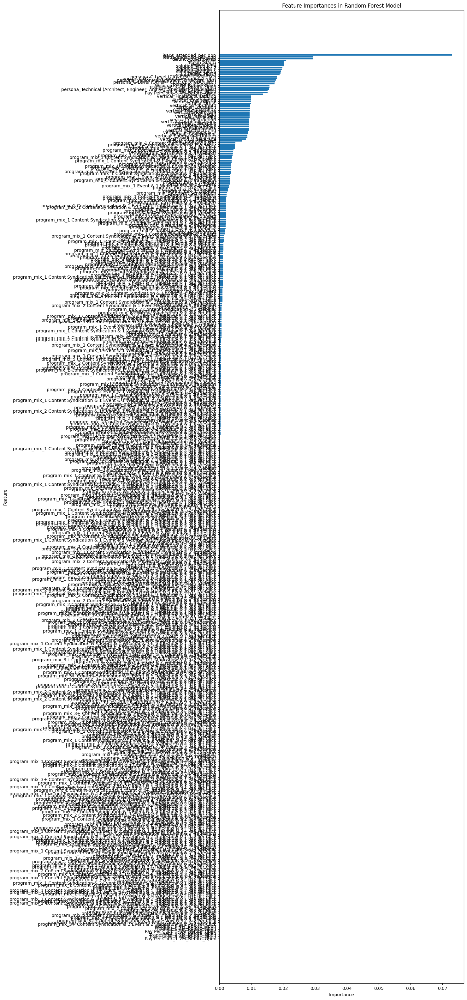

In [111]:
# Find feature importances from the fitted model
importances = random_forest.feature_importances_
sorted_indices = np.argsort(importances)[::-1]

# Get the processed feature names from the function
feature_names = get_feature_names(preprocessor)

plt.figure(figsize=(10, 40))  # Adjust the figure size to accommodate all features
plt.title('Feature Importances in Random Forest Model')
plt.barh(range(len(sorted_indices)), importances[sorted_indices], align='center')
plt.yticks(range(len(sorted_indices)), [feature_names[i] for i in sorted_indices])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.gca().invert_yaxis()  # Invert the axis to show the most important at the top
plt.show()

In [112]:
# Calculate the Pearson correlation coefficient between 'distinct_touchpoints' and 'leads_engaged_per_opp'
correlation = df['distinct_touchpoints'].corr(df['leads_engaged_per_opp'])

# Print the correlation value
print("Correlation between distinct touchpoints and leads ENGAGED per opportunity:", correlation)

# Calculate the Pearson correlation coefficient between 'distinct_touchpoints' and 'leads_attended_per_opp'
correlation = df['distinct_touchpoints'].corr(df['leads_attended_per_opp'])

# Print the correlation value
print("Correlation between distinct touchpoints and leads ATTENDED per opportunity:", correlation)

Correlation between distinct touchpoints and leads ENGAGED per opportunity: 0.9997120934188037
Correlation between distinct touchpoints and leads ATTENDED per opportunity: 0.7579514980559414


I was concerned I might need to drop one of the variables from the model due to multicollinearity, especially since they are both highly important features. **Considering leads engaged per opp is extremely correlated to distinct touchpoints,** while leads attended is only weakly correlated, we will leave leads attended per opp while **dropping leads engaged per opp in our segmentation modeling stage.**

Let's **get counts of and percentages of distinct opps that are high value (> 50k) and group them by different buckets of distinct_touchpoints**. 

In [113]:
# Filter DataFrame for opps with amount_usd > 50000
high_value_opps = df[df['amount_usd'] > 50000].copy()

# Define buckets
bins = [1, 3, 5, 7, float('inf')]
labels = ['1-2', '3-4', '5-6', '7+']

# Categorize data based on distinct touchpoints
high_value_opps['touchpoint_basket'] = pd.cut(high_value_opps['distinct_touchpoints'], bins=bins, labels=labels, right=False)

# Count the number of opportunities in each bin
touchpoint_counts_high = high_value_opps.groupby('touchpoint_basket')['opportunity_id'].nunique().reset_index(name='count')

# Calculate percentages
touchpoint_counts_high['percent'] = (touchpoint_counts_high['count'] / touchpoint_counts_high['count'].sum()) * 100

# Display the results
print("Counts and Percentages of High Value Opps:")
print(touchpoint_counts_high)

Counts and Percentages of High Value Opps:
  touchpoint_basket  count    percent
0               1-2  16412  53.697160
1               3-4  11730  38.378484
2               5-6   2208   7.224185
3                7+    214   0.700170


**Let's do the same but for low value opps (<= 50k).**

In [114]:
# Filter DataFrame for opps with amount_usd <= 50000
low_value_opps = df[df['amount_usd'] <= 50000].copy()

# Define buckets
bins = [1, 3, 5, 7, float('inf')]
labels = ['1-2', '3-4', '5-6', '7+']

# Categorize data based on distinct touchpoints
low_value_opps['touchpoint_basket'] = pd.cut(low_value_opps['distinct_touchpoints'], bins=bins, labels=labels, right=False)

# Count the number of opportunities in each bin
touchpoint_counts_low = low_value_opps.groupby('touchpoint_basket')['opportunity_id'].nunique().reset_index(name='count')

# Calculate percentages
touchpoint_counts_low['percent'] = (touchpoint_counts_low['count'] / touchpoint_counts_low['count'].sum()) * 100

# Display the results
print("Counts and Percentages of Low Value Opps:")
print(touchpoint_counts_low)

Counts and Percentages of Low Value Opps:
  touchpoint_basket  count    percent
0               1-2  16447  53.965285
1               3-4  11613  38.104144
2               5-6   2203   7.228402
3                7+    214   0.702169


In [115]:
# Group by account_id and count distinct opportunity_ids
program_mix_opportunity_counts = df.groupby('program_mix')['opportunity_id'].nunique()
program_mix_opportunity_counts.sort_values(ascending=False)

program_mix
1 Pay Per Click                                                                 2849
1 Content Syndication                                                           2785
1 Tradeshow                                                                     2763
1 Webinar                                                                       2752
1 Event                                                                         2748
                                                                                ... 
1 Event & 2 Webinar & 3+ Tradeshow                                                 1
1 Event & 2 Webinar & 3+ Tradeshow & 1 Pay Per Click                               1
1 Event & 2 Webinar & 3+ Tradeshow & 2 Pay Per Click                               1
1 Event & 3+ Webinar & 2 Pay Per Click                                             1
3+ Content Syndication & 1 Event & 1 Webinar & 1 Tradeshow & 1 Pay Per Click       1
Name: opportunity_id, Length: 438, dtype: int64

In [116]:
df.shape

(96193, 52)

In [117]:
df['opportunity_id'].nunique()

41801

### 4.3.6 Conversion Rates by Persona <a id="conversion_rates"></a>

In [118]:
# Adjust the bins for 'leads_engaged_per_opp' and 'leads_attended_per_opp'
df['engaged_bin'] = pd.cut(df['leads_engaged_per_opp'], bins=[1, 3, 5, np.inf], right=False, labels=['1-2', '3-4', '5+'])
df['attended_bin'] = pd.cut(df['leads_attended_per_opp'], bins=[1, 2, 3, np.inf], right=False, labels=['1', '2', '3+'])

# Ensure 'outcome' is an integer if it's binary
df['outcome2'] = df['outcome'].astype(int)

# Calculate conversion rates by bins
conversion_rates = df.groupby(['engaged_bin', 'attended_bin'])['outcome2'].mean().unstack()
print(conversion_rates)

attended_bin         1         2        3+
engaged_bin                               
1-2           0.500318  0.503025       NaN
3-4           0.497570  0.509091  0.508128
5+            0.482456  0.488360  0.503959


Number of unique opportunities for each attended-engaged bin combo:

In [119]:
df.groupby(['engaged_bin', 'attended_bin'])['opportunity_id'].nunique().unstack()

attended_bin,1,2,3+
engaged_bin,,,
1-2,14610,5785,0
3-4,2394,5115,5105
5+,68,372,2049


Let's **calculate conversion rates by persona, engaged bins and attended bins** to see which personas correlate the most to our outcome. 

In [120]:
def re_bucket_persona(persona):
    # Define the mappings
    persona_mapping = {
        'IT/Security': 'Technical',
        'Technical (Architect, Engineer, Analyst, Specialist, Developer)': 'Technical',  
        'C-Level (CIO, CISO, CSO, CTO)': 'Exec Decision Makers',
        'C-Level (Other - CEO, CFO, COO, etc.)': 'Exec Decision Makers',
        'Senior Management (Directors, VPs)': 'Exec Decision Makers',
        'Other': 'Technical'
    }
    
    # Map the persona using the mapping dictionary
    return persona_mapping.get(persona, 'Other')  # Default to 'Other' if not matched

# Apply the function to the 'persona' column
df['bucketed_persona'] = df['persona'].apply(re_bucket_persona)

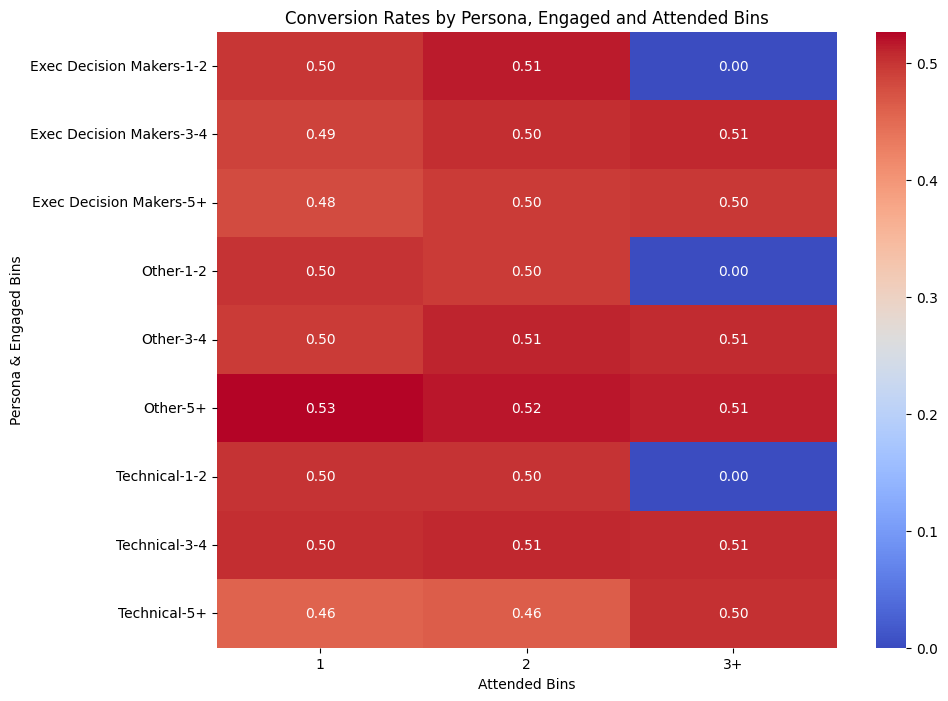

In [121]:
# Calculate conversion rates by persona, engaged bins, and attended bins
conversion_rates = df.groupby(['bucketed_persona', 'engaged_bin', 'attended_bin'])['outcome2'].mean().unstack().fillna(0)

plt.figure(figsize=(10, 8))
sns.heatmap(conversion_rates, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Conversion Rates by Persona, Engaged and Attended Bins')
plt.ylabel('Persona & Engaged Bins')
plt.xlabel('Attended Bins')
plt.show()

## 4.4 Build Segment Models <a id="segment_models"></a>

Instead of building entirely separate models for each combination, **we can segment the dataset and build a model for each segment**. This segmentation effectively reduces the feature space complexity, allowing the model to focus more on the nuances of touchpoints within each segment. 

We will automate the segmentation and model training processes using for loops and functions in order to dynamically generate, train, and evaluate models for each segment without redundant code. 

In [122]:
df.groupby('region_type')['opportunity_id'].count().sort_values(ascending=False)

region_type
East_Prospect_                   16140
West_Prospect_                   15981
South_Prospect_                  15972
North_Prospect_                  15954
West_Customer_Low Potential       4077
South_Customer_Low Potential      4064
East_Customer_Low Potential       4024
South_Customer_High Potential     4018
North_Customer_High Potential     4003
North_Customer_Low Potential      4000
West_Customer_High Potential      3989
East_Customer_High Potential      3971
Name: opportunity_id, dtype: int64

### 4.4.1 Testing Two Different Models to Reduce Overfitting <a id="testing_models"></a>

First, we'll try using GBM since this model type is known for being robust to overfitting. We'll be reducing our model's complexity for both models to further help with the overfitting issue, which entails modifying the hyperparameters. 

### Gradient Boosting Attempt: 

In [123]:
%pip install imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [149]:
# Preprocessing
categorical_features = ['solution', 'region', 'persona', 'vertical', 'program_mix']
                    # NOTE: excluding 'type' since this is a lagging indicator (e.g. 'Renewal')
numeric_features = ['leads_attended_per_opp', 'distinct_touchpoints']      

# Combine categorical and numeric variables into one dataframe
df2 = df[categorical_features + numeric_features]

In [150]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import cross_validate, StratifiedKFold, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.feature_selection import SelectFromModel
import numpy as np

def train_and_evaluate_segment(data, features, target, segment_key):
    X = data[features]
    y = data[target].astype(int)

    # Define preprocessor for numeric and categorical data
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', StandardScaler(), numeric_features),
            ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features),
        ])

     # Define the pipeline 
    pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('feature_selection', SelectFromModel(
        GradientBoostingClassifier(n_estimators=100, random_state=42),
        max_features=30
        )),
    ('classifier', GradientBoostingClassifier(
        random_state=42,
        n_estimators=20,       # Reduced number of trees
        learning_rate=0.01,    # Lower learning rate
        subsample=0.8,         # Subsampling to prevent overfitting
        max_depth=2            # Shallow trees to avoid overfitting
        ))
    ])

    # Setup GridSearchCV to find the best parameters and model
    param_grid = {
        'classifier__n_estimators': [100, 200],
        'classifier__learning_rate': [0.01, 0.1, 0.2],
        'classifier__subsample': [0.5, 0.7, 1.0],
        'classifier__max_depth': [3, 5, 7]
    }
    grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='recall', verbose=1, n_jobs=-1)
    grid_search.fit(X, y)
    
    best_pipeline = grid_search.best_estimator_

    # Cross-validation to evaluate the best model
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_validate(best_pipeline, X, y, cv=cv, scoring=['recall', 'precision', 'accuracy', 'f1'], return_train_score=False)
    
    # Fit the best model on the entire dataset for use in production or further analysis
    best_pipeline.fit(X, y)

    # Save probabilities for this segment
    probabilities = best_pipeline.predict_proba(X)[:, 1]
    np.save(f'probabilities-meta_{segment_key}.npy', probabilities)

    return scores

In [151]:
# Iterate over each region_type segment and apply function
results = {}

for segment_key in df['region_type'].unique():
    segment_data = df[df['region_type'] == segment_key]

    if not segment_data.empty:
        # Perform training and evaluation
        results[segment_key] = train_and_evaluate_segment(
            segment_data, 
            df2.columns, 
            'outcome', 
            segment_key
        )

# Optionally, print or process the results dictionary
for key, value in results.items():
    print(f"Segment: {key}, Scores: {value}")

Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Fitting 5 folds for each of 54 candidates, totalling 270 fits
Segment: North_Customer_Low Potential, Scores: {'fit_time': array([0.19396091, 0.18932891, 0.19388199, 0.19396305, 0.19088101]), 'score_time': array([0.00775099, 0.00715327, 0.00678611, 0.00698996, 0.00695872]), 'test_recall': array([0.59798995, 0.66666667

In [152]:
# Extract processed feature names
processed_feature_names = get_feature_names(pipeline.named_steps['preprocessor'])

# Output the names to check
print("Processed feature names:", processed_feature_names)

Processed feature names: ['leads_engaged_per_opp', 'leads_attended_per_opp', 'distinct_touchpoints', 'Event_1-2M_Before_Open', 'Event_3-4M_Before_Open', 'Event_5-6M_Before_Open', 'Webinar_1-2M_Before_Open', 'Webinar_3-4M_Before_Open', 'Webinar_5-6M_Before_Open', 'Pay Per Click_1-2M_Before_Open', 'Pay Per Click_3-4M_Before_Open', 'Pay Per Click_5-6M_Before_Open', 'Tradeshow_1-2M_Before_Open', 'Tradeshow_3-4M_Before_Open', 'Tradeshow_5-6M_Before_Open', 'solution_Product 1', 'solution_Product 2', 'solution_Product 3', 'solution_Product 4', 'solution_Product 5', 'region_East', 'region_North', 'region_South', 'region_West', 'persona_C-Level (CIO, CISO, CSO, CTO)', 'persona_C-Level (Other – CEO, CFO, COO, etc.)', 'persona_IT/Security', 'persona_Other', 'persona_SOC – Security Operations Center', 'persona_Senior Management (Directors, VPs)', 'persona_Technical (Architect, Engineer, Analyst, Specialist, Developer)', 'vertical_Agriculture', 'vertical_Biotechnology', 'vertical_Chemicals', 'verti

### Random Forest Attempt: 

In [153]:
from sklearn.model_selection import StratifiedKFold, cross_validate
from sklearn.metrics import recall_score, precision_score, accuracy_score, f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.feature_selection import SelectFromModel
import numpy as np

def train_and_evaluate_segment(data, features, target, segment_key):
    X = data[features]
    y = data[target].astype(int)

    # Define preprocessor for numeric and categorical data
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', StandardScaler(), numeric_features),
            ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features),
        ])

    # Define the pipeline adjusted for better recall
    pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('feature_selection', SelectFromModel(
        RandomForestClassifier(n_estimators=100, random_state=42),
        max_features=30
        )),
    ('classifier', RandomForestClassifier(
        n_estimators=100,         # Increased number of trees
        max_depth=None,           # Allow full tree growth
        min_samples_split=2,      # Easier to split
        min_samples_leaf=1,       # Smaller leaves allowed
        random_state=42
        ))
    ])

    # Cross-validation to evaluate model
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_validate(pipeline, X, y, cv=cv, scoring=['recall', 'precision', 'accuracy', 'f1'], return_train_score=False)
    
    # Fit the model on the entire dataset for use in production or further analysis
    pipeline.fit(X, y)

    # Save probabilities for this segment
    probabilities = pipeline.predict_proba(X)[:, 1]
    np.save(f'probabilities-meta_{segment_key}.npy', probabilities)

    # Return scores and feature importances
    return scores

In [154]:
# Iterate over each region_type segment and apply function
results = {}

for segment_key in df['region_type'].unique():
    segment_data = df[df['region_type'] == segment_key]

    if not segment_data.empty:
        # Perform training and evaluation
        results[segment_key] = train_and_evaluate_segment(
            segment_data, 
            df2.columns, 
            'outcome', 
            segment_key
        )

# Optionally, print or process the results dictionary
for key, value in results.items():
    print(f"Segment: {key}, Scores: {value}")

Segment: North_Customer_Low Potential, Scores: {'fit_time': array([0.83854413, 0.83282089, 0.82700419, 0.83744001, 0.85491395]), 'score_time': array([0.02581286, 0.02512288, 0.02499509, 0.02608204, 0.02521706]), 'test_recall': array([0.51256281, 0.50125313, 0.51879699, 0.54135338, 0.50626566]), 'test_precision': array([0.51908397, 0.50632911, 0.50121065, 0.52173913, 0.49753695]), 'test_accuracy': array([0.52125, 0.5075 , 0.5025 , 0.52375, 0.49875]), 'test_f1': array([0.51580278, 0.50377834, 0.50985222, 0.53136531, 0.50186335])}
Segment: East_Customer_High Potential, Scores: {'fit_time': array([0.83288503, 0.82526994, 0.83161879, 0.83045578, 0.83876204]), 'score_time': array([0.02573085, 0.02514696, 0.02510214, 0.02403021, 0.02623081]), 'test_recall': array([0.46633416, 0.485     , 0.51122195, 0.5286783 , 0.49127182]), 'test_precision': array([0.5       , 0.50918635, 0.52030457, 0.50717703, 0.49004975]), 'test_accuracy': array([0.49559748, 0.50503778, 0.51511335, 0.50251889, 0.48488665]

Similar results to GBM, with slightly better recall across the board for all but the same three overfitted or unreliable segments. 

Random Forest is generalizing relatively well across most segments. 

Considering **Random Forest had consistently higher recall metrics** across segments compared to GBM, and only three segments overfitting with none underfitting, **we are choosing the Gradient Boosting Model (GBM)**. 

The fact that F1 scores remain high in the upper 80s and 90s across all folds indicates that **the model maintains a strong balance between precision and recall, which is critical for robust performance. Overall, this model strikes a better balance between complexity and effectiveness**, making it more suitable for operational use where trust and understandability are key.

## 4.5 Segment Outcome Analysis <a id="segment_outcome_analysis"></a>



### 4.5.1 Examine Feature Importances <a id="examine_feature_importances"></a>

We'll now examine the feature importances for each segment. 

In [155]:
# Train, evaluate, and plot feature importances per segment
def train_and_evaluate_segment(data, features, target, segment_key):
    X = data[features]
    y = data[target].astype(int)

    # Preprocessing
    preprocessor = ColumnTransformer(transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])

    # Pipeline
    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('classifier', RandomForestClassifier(
            n_estimators=15,
            max_depth=4,
            min_samples_split=8,
            min_samples_leaf=8,
            random_state=42
        ))
    ])

    # Cross-validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_validate(
        pipeline, X, y, cv=cv,
        scoring=['recall', 'precision', 'accuracy', 'f1'],
        return_train_score=False
    )

    # Fit full model
    pipeline.fit(X, y)

    # Feature importances
    feature_importances = pipeline.named_steps['classifier'].feature_importances_
    processed_feature_names = get_feature_names(preprocessor)

    # Plot
    plot_feature_importances(feature_importances, processed_feature_names, segment_key)

    # Save probabilities (optional)
    probabilities = pipeline.predict_proba(X)[:, 1]
    np.save(f'probabilities-meta_{segment_key}.npy', probabilities)

    return scores, dict(zip(processed_feature_names, feature_importances))


# Helper: Extract feature names
def get_feature_names(column_transformer):
    output_features = []
    for name, transformer, columns in column_transformer.transformers_:
        if hasattr(transformer, 'get_feature_names_out'):
            feature_names = transformer.get_feature_names_out(columns)
            output_features.extend(feature_names)
        else:
            output_features.extend(columns)
    return output_features


# Helper: Plot feature importances
def plot_feature_importances(importances, feature_names, segment_key):
    sorted_indices = np.argsort(importances)[::-1]
    plt.figure(figsize=(10, 8))
    plt.barh(range(len(importances)), importances[sorted_indices], align='center')
    plt.yticks(range(len(importances)), [feature_names[i] for i in sorted_indices])
    plt.xlabel('Importance')
    plt.title(f'Feature Importances for {segment_key}')
    plt.gca().invert_yaxis()
    plt.show()


Processing segment: North_Customer_Low Potential


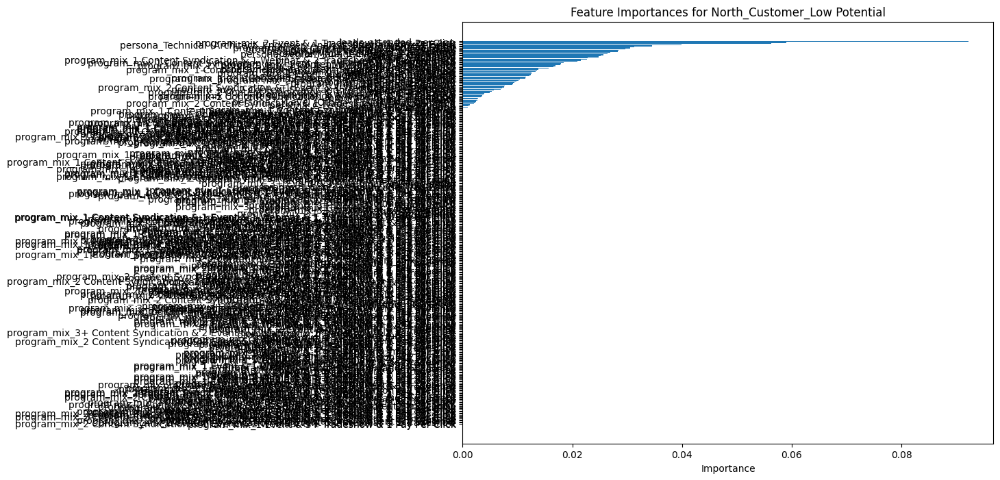

Processing segment: East_Customer_High Potential


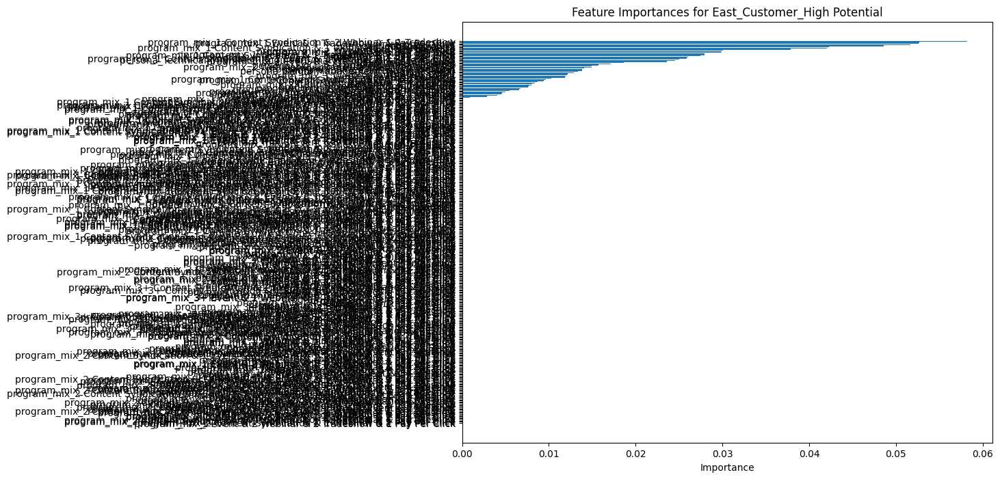

Processing segment: South_Prospect_


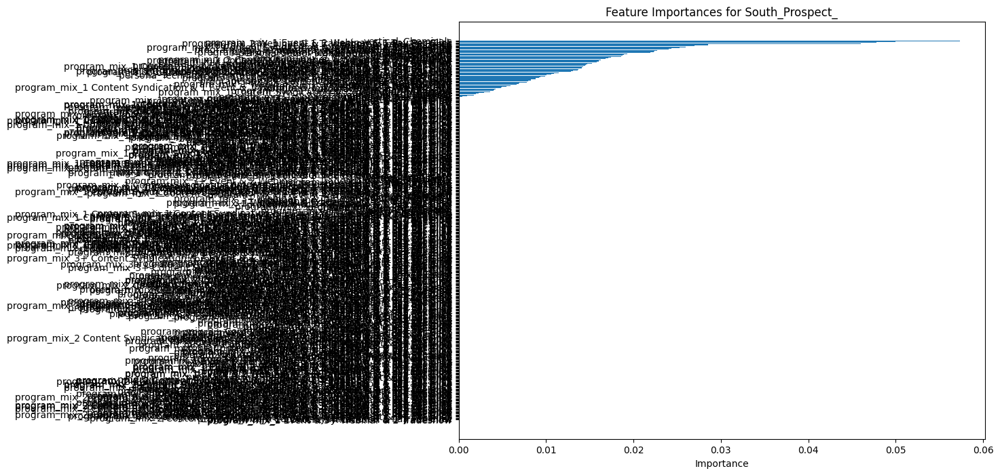

Processing segment: West_Prospect_


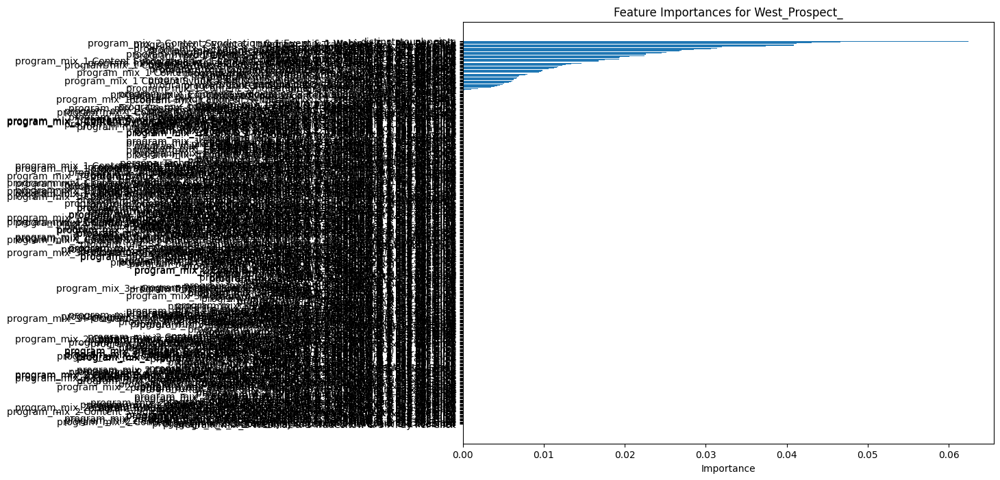

Processing segment: North_Prospect_


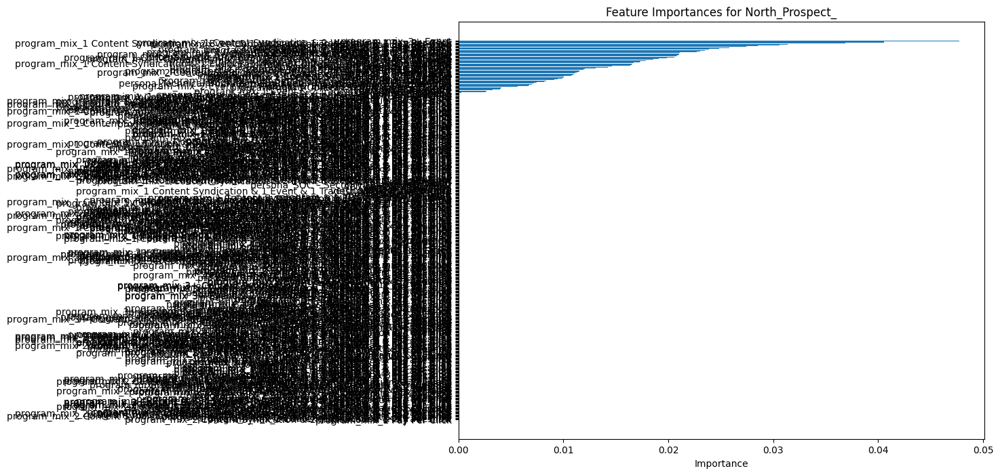

Processing segment: North_Customer_High Potential


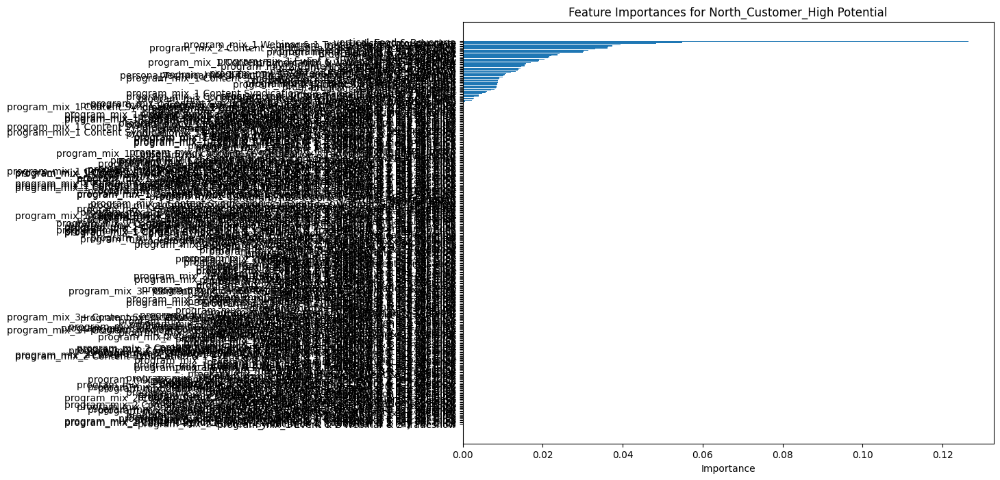

Processing segment: West_Customer_Low Potential


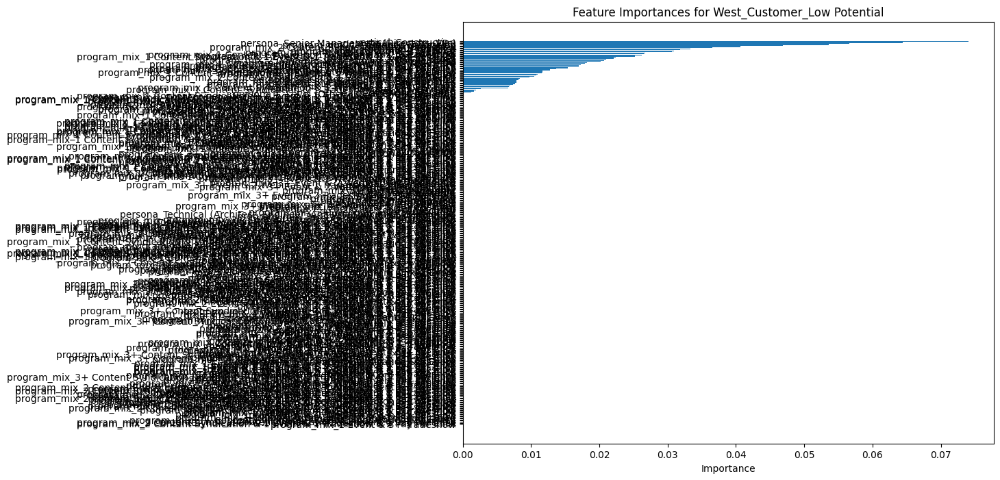

Processing segment: East_Prospect_


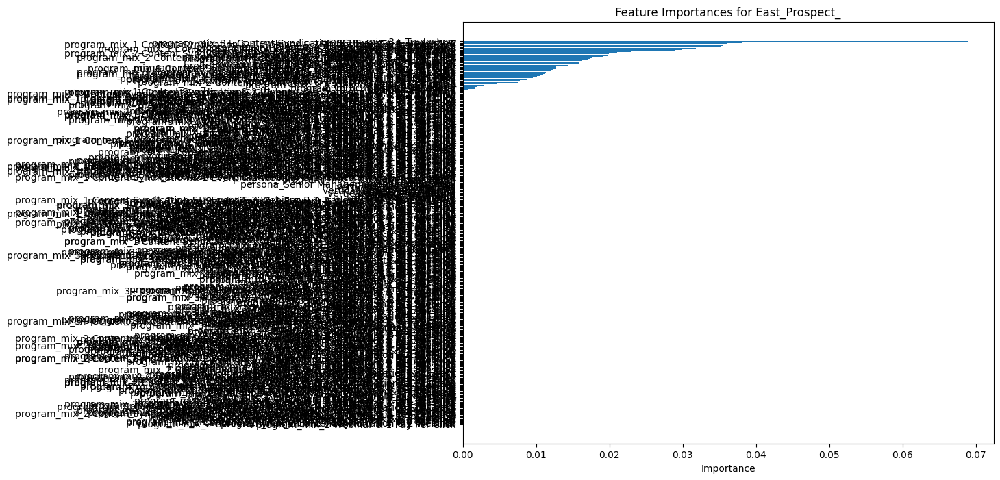

Processing segment: South_Customer_Low Potential


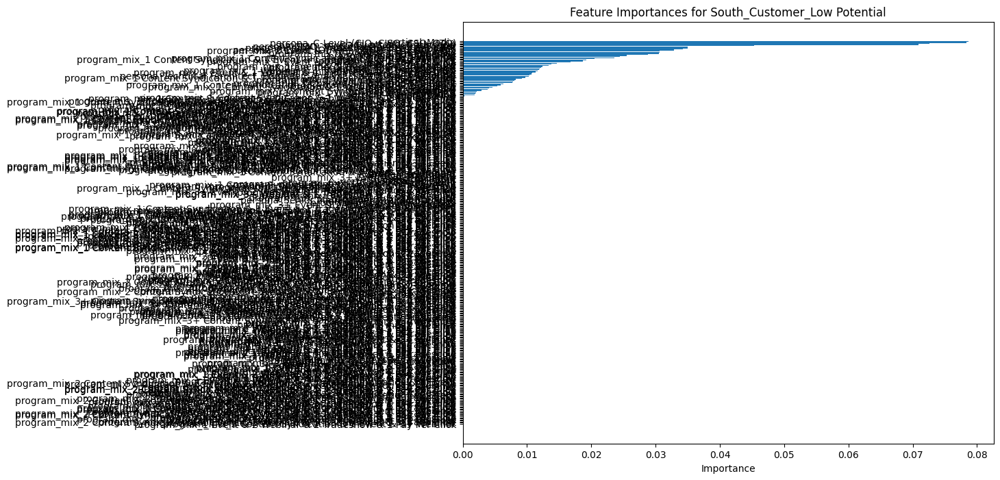

Processing segment: South_Customer_High Potential


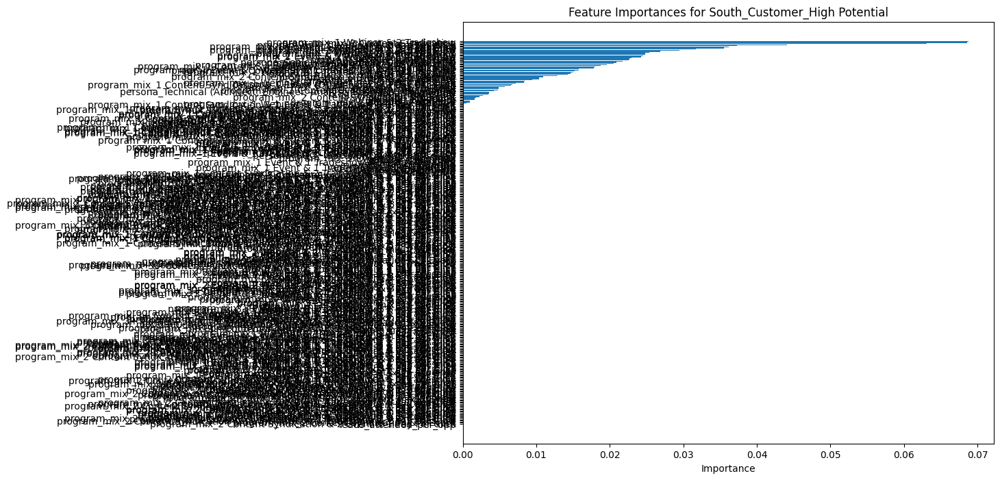

Processing segment: East_Customer_Low Potential


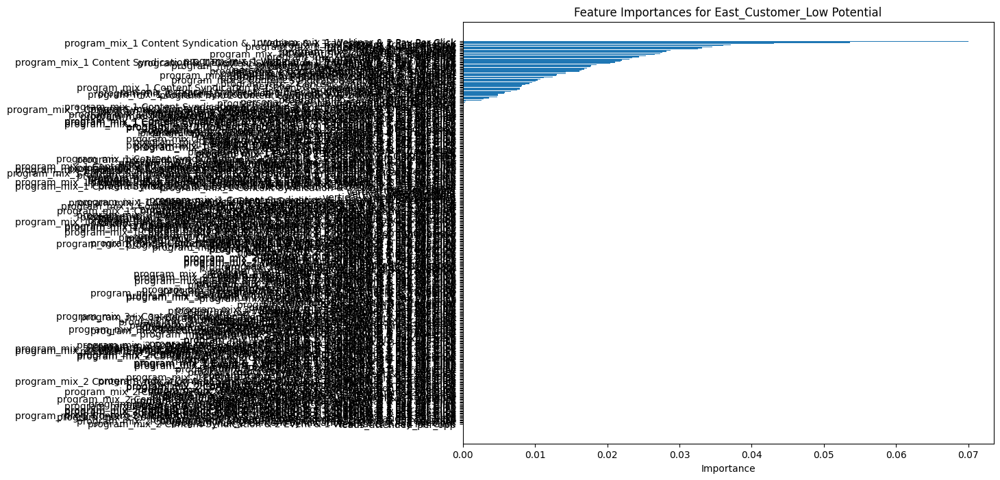

Processing segment: West_Customer_High Potential


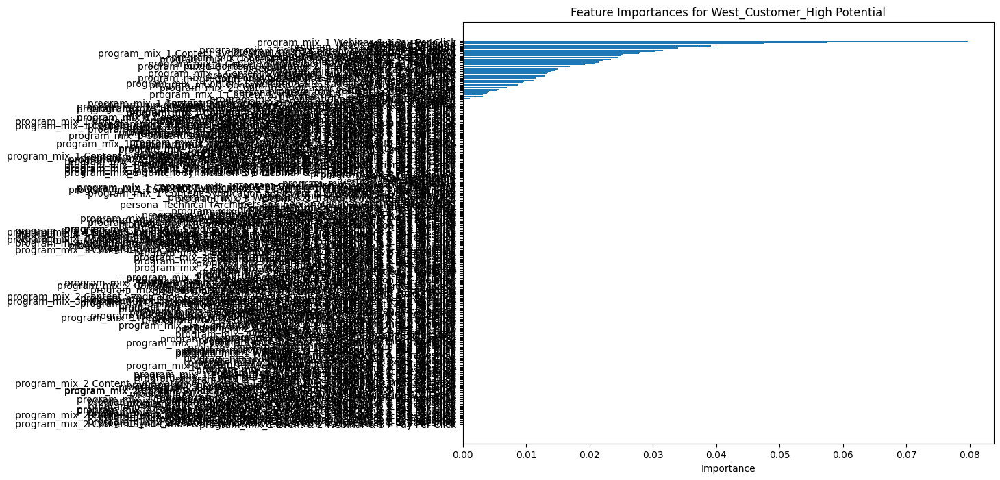

In [156]:
# ✅ Loop through each region_type segment
results = {}
for segment_key in df['region_type'].unique():
    segment_data = df[df['region_type'] == segment_key]
    if not segment_data.empty:
        print(f"Processing segment: {segment_key}")
        results[segment_key] = train_and_evaluate_segment(segment_data, df2.columns, 'outcome', segment_key)

This is good, but let's try visualizing the different program mix outcomes per segment. 

### 4.5.2 Program Mix Outcomes Per Segment <a id="program_mix_per_segment"></a>

*NOTE: I'm defining the **most successful mix as the one with the combo of highest success rate & opp count**. We are balancing Mean Outcome (shows conversion quality) and Opportunity Count (shows statistical reliability). We used weighted scoring by normalizing the success rate b/t 0-1, and normalizing the opp count using log(count) scaling (to reduce skew from very large counts). We then calculated a composite score (70% weight for conversion quality, 30% weight for sample size), and generated a final recommended mix by selecting the combo of channel counts present in the top scoring program_mixes.* 

In [157]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from numpy import log1p

recommended_program_mix_dict = {}

all_channels = ['Content Syndication', 'Event', 'Webinar', 'Tradeshow', 'Pay Per Click']

def generate_program_mix_recommendations(df):
    for segment_key in df['region_type'].unique():
        segment_data = df[df['region_type'] == segment_key]

        if segment_data.empty:
            continue

        print(f"\n📊 Segment: {segment_key}")

        # Group by program_mix
        outcome_means = segment_data.groupby('program_mix')['outcome'].mean().reset_index()
        counts = segment_data['program_mix'].value_counts().reset_index()
        counts.columns = ['program_mix', 'count']

        # Merge and score
        result = pd.merge(outcome_means, counts, on='program_mix')
        result['normalized_success'] = result['outcome'] / result['outcome'].max()
        result['normalized_count'] = log1p(result['count']) / log1p(result['count'].max())
        result['composite_score'] = (0.7 * result['normalized_success']) + (0.3 * result['normalized_count'])
        result.sort_values(by='composite_score', ascending=False, inplace=True)

        # 📊 Plotting
        plt.figure(figsize=(12, 6))
        sns.barplot(data=result, x='program_mix', y='count', color='lightblue')
        plt.xticks(rotation=45, ha='right')
        plt.ylabel('Opportunity Count')
        plt.title(f'Opportunity Count by Program Mix – {segment_key}')
        plt.tight_layout()
        plt.show()

        plt.figure(figsize=(12, 6))
        sns.lineplot(data=result, x='program_mix', y='outcome', marker='o', color='green')
        plt.xticks(rotation=45, ha='right')
        plt.ylabel('High-Value Opportunity Rate')
        plt.title(f'Success Rate by Program Mix – {segment_key}')
        plt.tight_layout()
        plt.show()

        # 📄 Display full table
        print("\nProgram Mix Outcomes Table:")
        print(result[['program_mix', 'outcome', 'count', 'composite_score']])

        # 🛠️ Build Recommended Mix (multi-channel)
        recommended_channels = {}

        for _, row in result.iterrows():
            mix = row['program_mix']
            for channel in all_channels:
                if (channel in mix) and (channel not in recommended_channels):
                    mix_parts = mix.split('&')
                    for part in mix_parts:
                        part = part.strip()
                        if channel in part:
                            recommended_channels[channel] = part
                            break
            if len(recommended_channels) == len(all_channels):
                break

        if recommended_channels:
            final_recommendation = ' & '.join([recommended_channels[channel] for channel in all_channels if channel in recommended_channels])
        else:
            final_recommendation = "N/A"

        recommended_program_mix_dict[segment_key] = final_recommendation

        print(f"\n✅ Recommended Program Mix for {segment_key}: {final_recommendation}")

    return recommended_program_mix_dict


📊 Segment: North_Customer_Low Potential


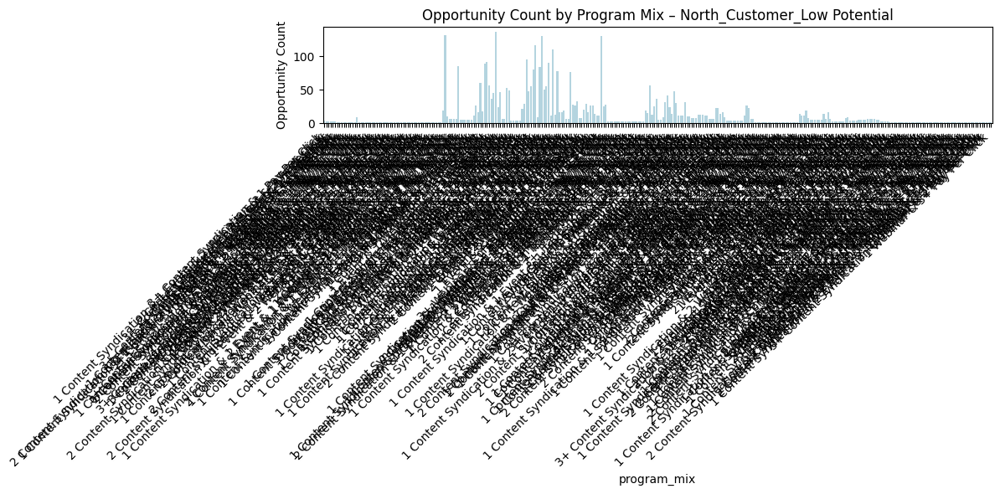

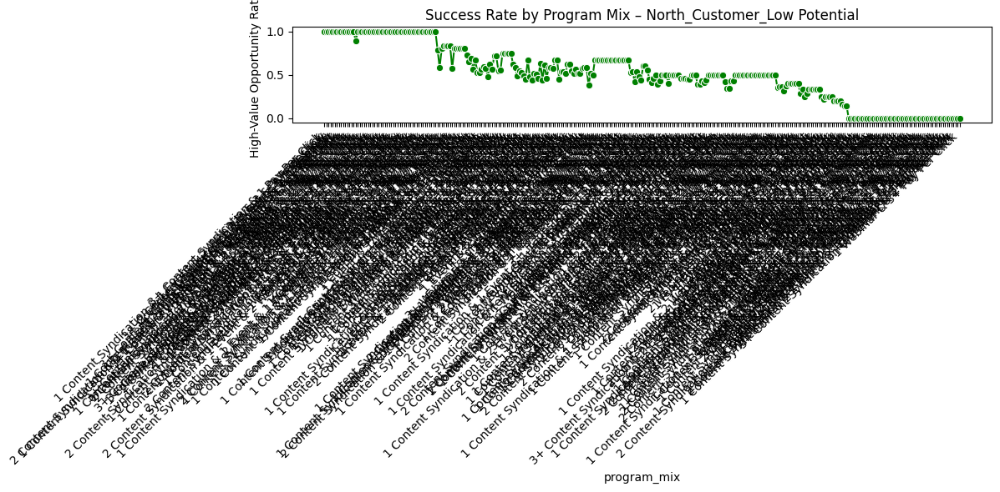


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
266           3+ Content Syndication & 1 Pay Per Click      1.0      4   
27   1 Content Syndication & 1 Event & 2 Webinar & ...      1.0      3   
230                              2 Event & 2 Tradeshow      1.0      3   
170        2 Content Syndication & 1 Event & 2 Webinar      1.0      3   
260     3+ Content Syndication & 1 Event & 1 Tradeshow      1.0      3   
..                                                 ...      ...    ...   
193  2 Content Syndication & 2 Event & 1 Webinar & ...      0.0      1   
256                           2 Webinar & 3+ Tradeshow      0.0      1   
63   1 Content Syndication & 2 Event & 2 Tradeshow ...      0.0      1   
264  3+ Content Syndication & 1 Event & 2 Pay Per C...      0.0      1   
152                       1 Webinar & 3+ Pay Per Click      0.0      1   

     composite_score  
266         0.797992  
27          0.784406  
230         0

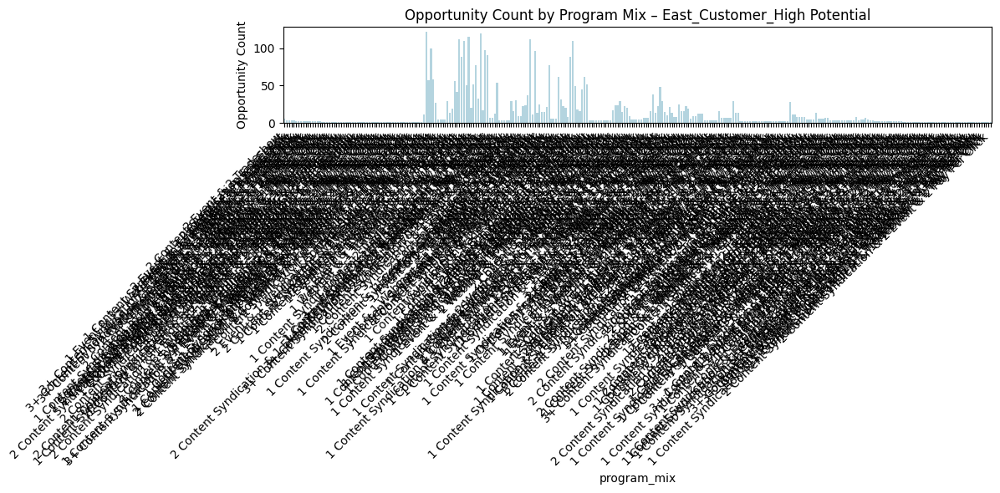

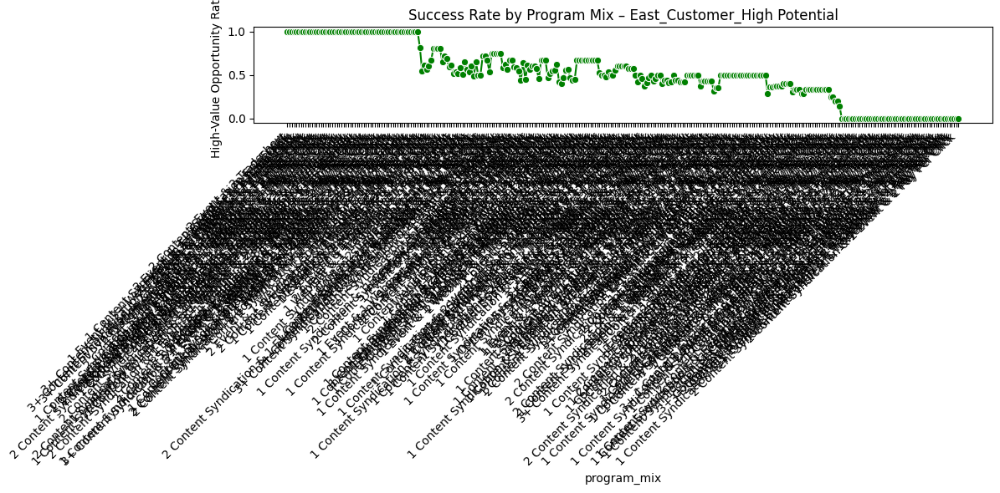


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
229                              2 Event & 2 Tradeshow      1.0      6   
191                    2 Content Syndication & 2 Event      1.0      4   
228                          2 Event & 2 Pay Per Click      1.0      3   
239                 2 Event & 3+ Webinar & 1 Tradeshow      1.0      3   
87      1 Content Syndication & 3+ Event & 1 Tradeshow      1.0      3   
..                                                 ...      ...    ...   
220            2 Event & 1 Tradeshow & 2 Pay Per Click      0.0      1   
15   1 Content Syndication & 1 Event & 1 Webinar & ...      0.0      1   
268  3+ Content Syndication & 1 Tradeshow & 2 Pay P...      0.0      1   
167  2 Content Syndication & 1 Event & 1 Webinar & ...      0.0      1   
199  2 Content Syndication & 2 Event & 2 Pay Per Click      0.0      1   

     composite_score  
229         0.821311  
191         0.800335  
228         0

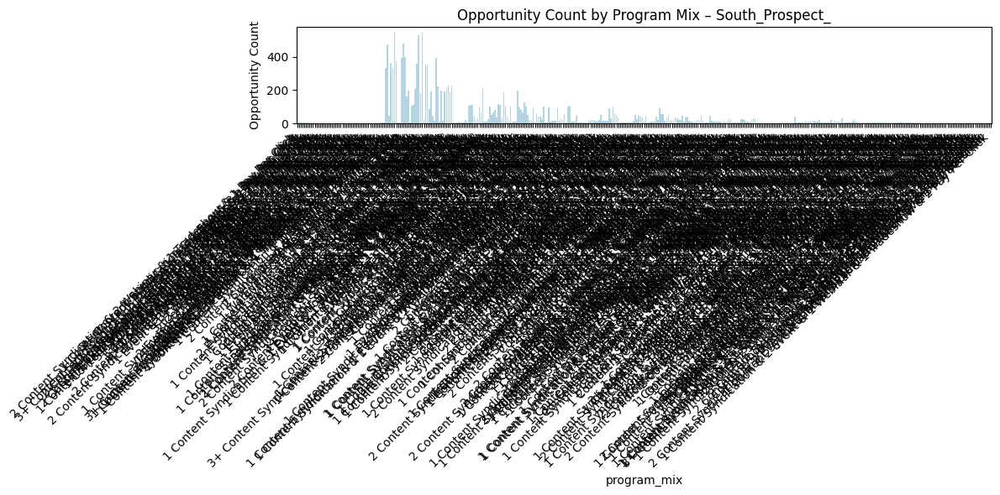

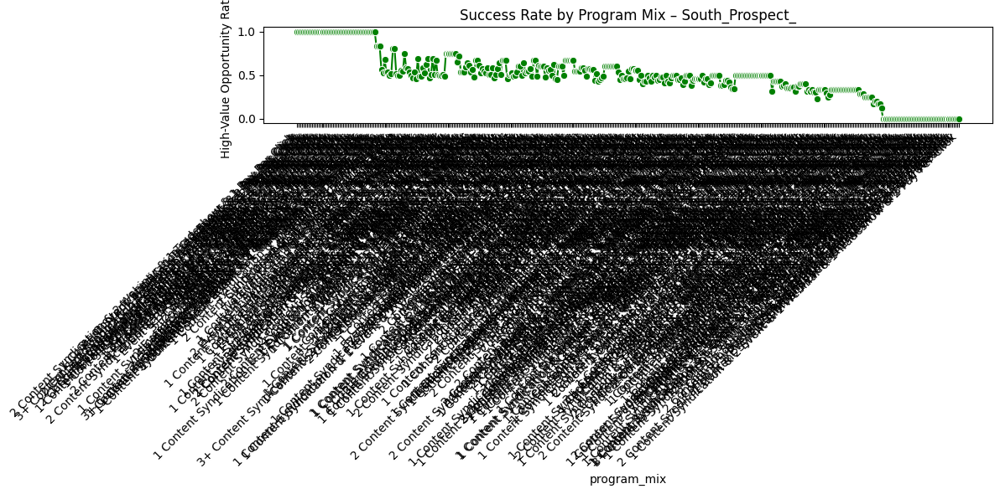


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
263  2 Content Syndication & 2 Webinar & 1 Tradesho...      1.0      7   
355  3+ Content Syndication & 2 Event & 1 Pay Per C...      1.0      5   
47   1 Content Syndication & 1 Tradeshow & 3+ Pay P...      1.0      4   
380                         3+ Event & 2 Pay Per Click      1.0      4   
309             2 Event & 3+ Webinar & 1 Pay Per Click      1.0      3   
..                                                 ...      ...    ...   
253        2 Content Syndication & 2 Event & 2 Webinar      0.0      1   
254  2 Content Syndication & 2 Event & 2 Webinar & ...      0.0      1   
272       2 Content Syndication & 3+ Event & 2 Webinar      0.0      1   
32   1 Content Syndication & 1 Event & 2 Webinar & ...      0.0      1   
71   1 Content Syndication & 2 Event & 1 Webinar & ...      0.0      1   

     composite_score  
263         0.798780  
355         0.785114  
47          0

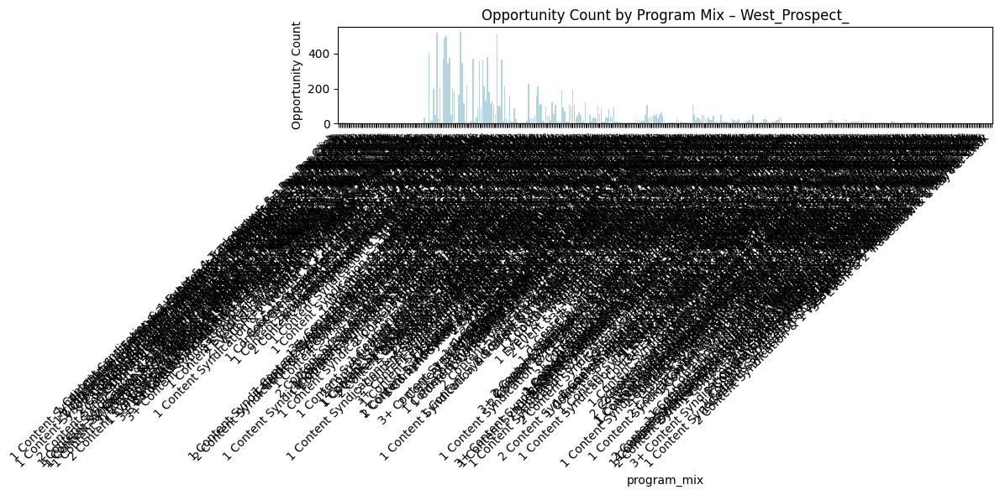

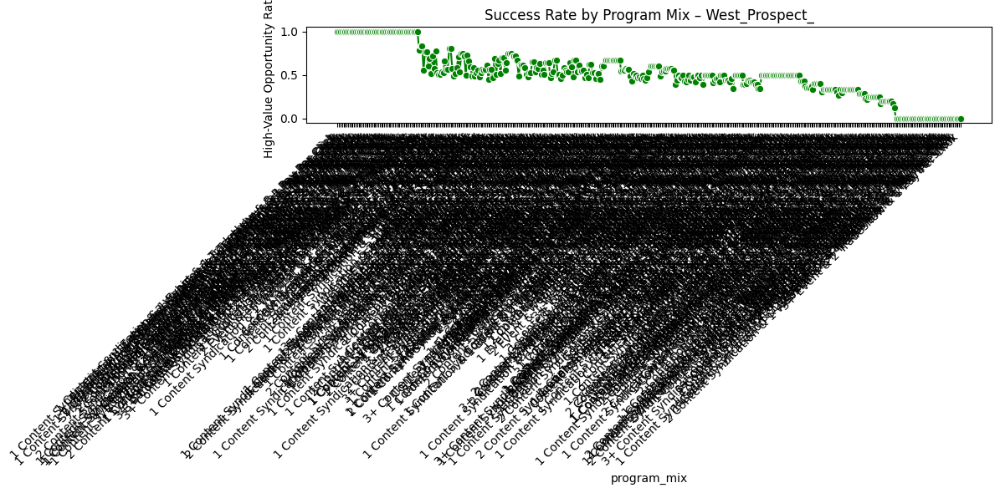


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
6    1 Content Syndication & 1 Event & 1 Tradeshow ...      1.0      7   
27   1 Content Syndication & 1 Event & 2 Webinar & ...      1.0      5   
342  3+ Content Syndication & 1 Event & 1 Webinar &...      1.0      4   
84   1 Content Syndication & 2 Event & 3+ Pay Per C...      1.0      4   
264    2 Content Syndication & 2 Webinar & 2 Tradeshow      1.0      3   
..                                                 ...      ...    ...   
35   1 Content Syndication & 1 Event & 3+ Tradeshow...      0.0      1   
175            1 Event & 3+ Webinar & 3+ Pay Per Click      0.0      1   
239  2 Content Syndication & 1 Webinar & 3+ Tradesh...      0.0      1   
390                             3+ Event & 2 Tradeshow      0.0      1   
391           3+ Event & 2 Tradeshow & 1 Pay Per Click      0.0      1   

     composite_score  
6           0.799539  
27          0.785768  
342         0

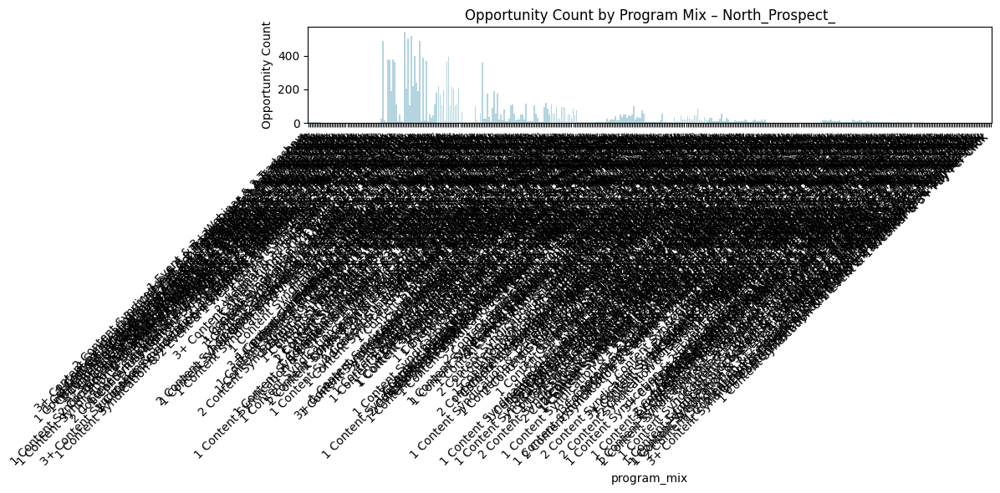

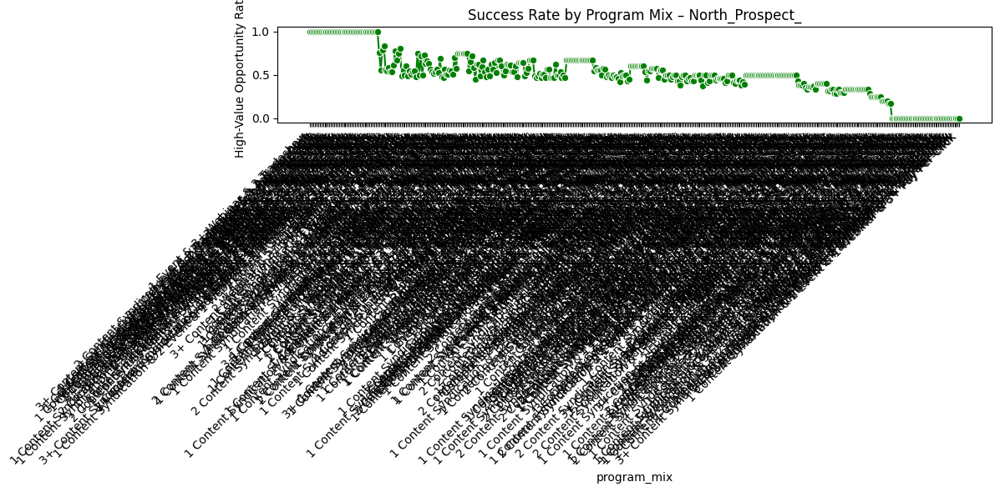


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
179                 1 Event & 3+ Webinar & 2 Tradeshow      1.0      6   
383                             3+ Event & 2 Tradeshow      1.0      4   
275  2 Content Syndication & 3+ Tradeshow & 1 Pay P...      1.0      4   
401         3+ Webinar & 2 Tradeshow & 1 Pay Per Click      1.0      4   
267                   2 Content Syndication & 3+ Event      1.0      3   
..                                                 ...      ...    ...   
42   1 Content Syndication & 1 Event & 3+ Webinar &...      0.0      1   
169             1 Event & 2 Webinar & 3+ Pay Per Click      0.0      1   
360  3+ Content Syndication & 2 Event & 1 Webinar &...      0.0      1   
97   1 Content Syndication & 2 Tradeshow & 3+ Pay P...      0.0      1   
75   1 Content Syndication & 2 Event & 1 Webinar & ...      0.0      1   

     composite_score  
179         0.792651  
383         0.776630  
275         0

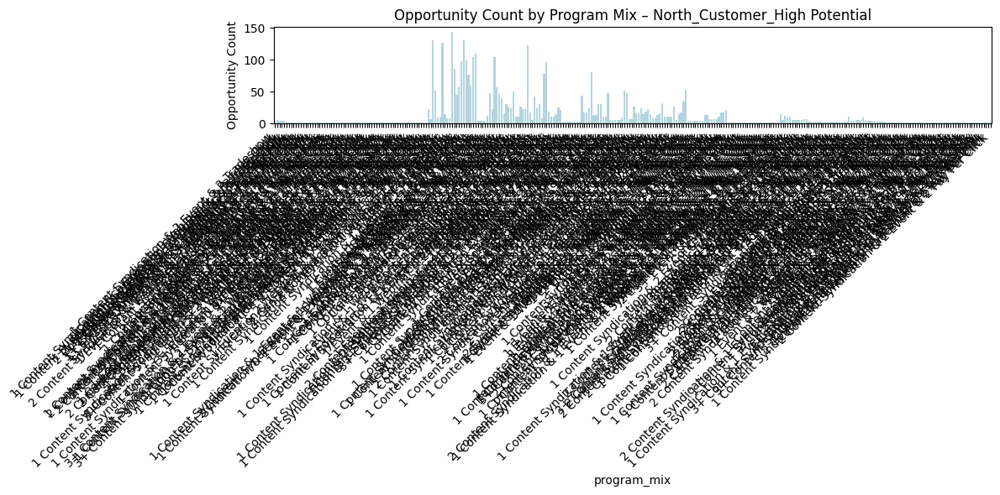

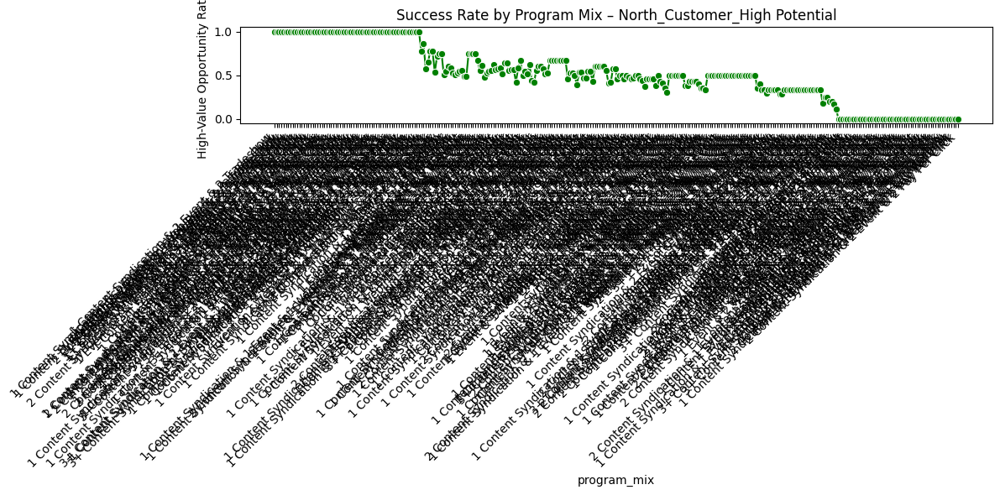


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
61       1 Content Syndication & 2 Event & 2 Tradeshow      1.0      6   
11   1 Content Syndication & 1 Event & 1 Webinar & ...      1.0      5   
212     2 Content Syndication & 3+ Event & 1 Tradeshow      1.0      4   
57   1 Content Syndication & 2 Event & 1 Webinar & ...      1.0      4   
101   1 Content Syndication & 3+ Webinar & 1 Tradeshow      1.0      4   
..                                                 ...      ...    ...   
86      1 Content Syndication & 3+ Event & 1 Tradeshow      0.0      1   
87        1 Content Syndication & 3+ Event & 1 Webinar      0.0      1   
192  2 Content Syndication & 1 Webinar & 2 Pay Per ...      0.0      1   
18   1 Content Syndication & 1 Event & 2 Tradeshow ...      0.0      1   
202  2 Content Syndication & 2 Event & 2 Pay Per Click      0.0      1   

     composite_score  
61          0.817300  
11          0.808008  
212         0

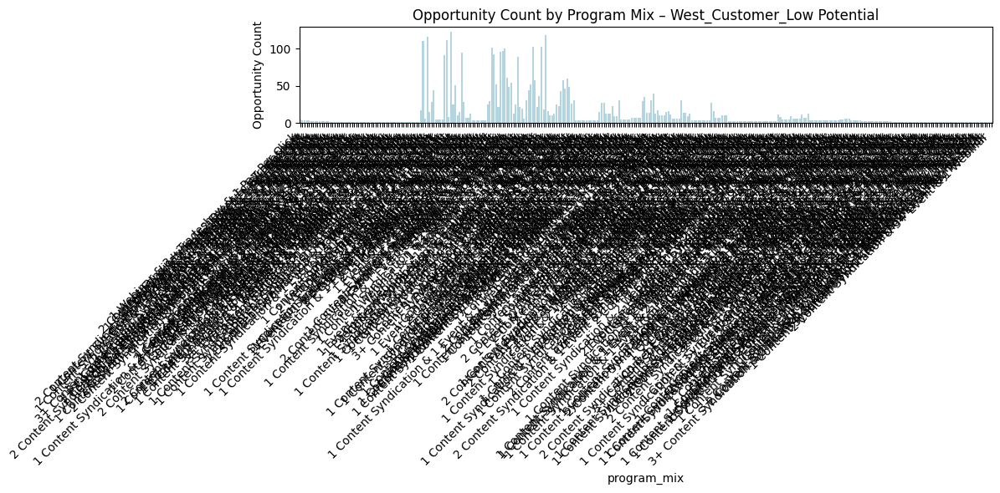

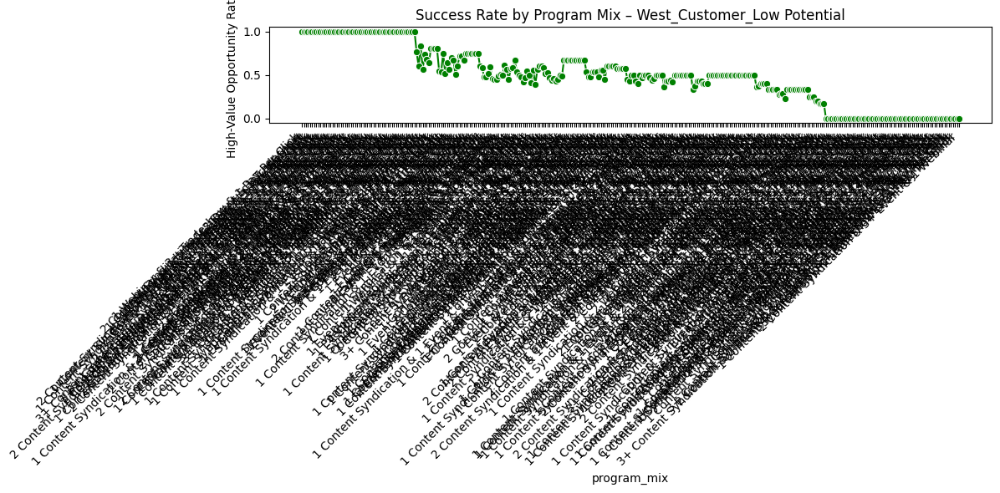


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
165         1 Webinar & 3+ Tradeshow & 1 Pay Per Click      1.0      5   
203      2 Content Syndication & 2 Event & 1 Tradeshow      1.0      4   
32        1 Content Syndication & 1 Event & 3+ Webinar      1.0      3   
264          2 Webinar & 2 Tradeshow & 1 Pay Per Click      1.0      3   
317         3+ Webinar & 1 Tradeshow & 1 Pay Per Click      1.0      3   
..                                                 ...      ...    ...   
204  2 Content Syndication & 2 Event & 1 Tradeshow ...      0.0      1   
287  3+ Content Syndication & 2 Event & 1 Webinar &...      0.0      1   
288       3+ Content Syndication & 2 Event & 2 Webinar      0.0      1   
39   1 Content Syndication & 1 Tradeshow & 3+ Pay P...      0.0      1   
217       2 Content Syndication & 3+ Event & 1 Webinar      0.0      1   

     composite_score  
165         0.811514  
203         0.800167  
32          0

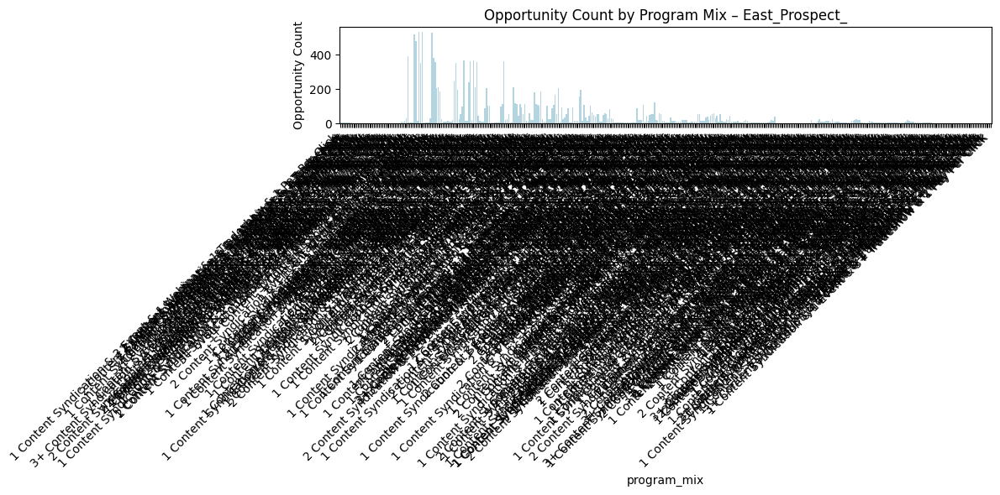

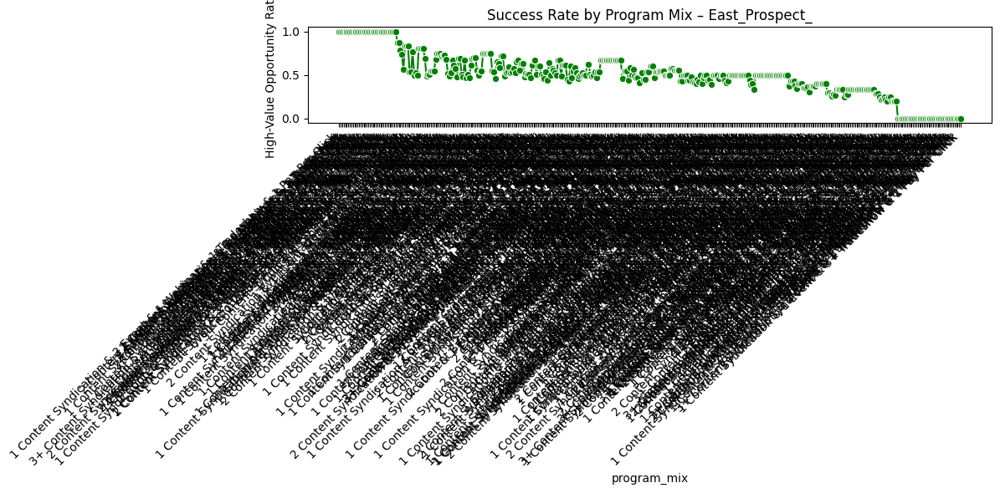


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
70   1 Content Syndication & 2 Event & 1 Webinar & ...      1.0      6   
275   2 Content Syndication & 3+ Webinar & 1 Tradeshow      1.0      4   
277   2 Content Syndication & 3+ Webinar & 2 Tradeshow      1.0      3   
269  2 Content Syndication & 3+ Event & 1 Webinar &...      1.0      3   
238  2 Content Syndication & 1 Webinar & 3+ Pay Per...      1.0      3   
..                                                 ...      ...    ...   
303             2 Event & 2 Webinar & 3+ Pay Per Click      0.0      1   
297           2 Event & 2 Tradeshow & 3+ Pay Per Click      0.0      1   
358  3+ Content Syndication & 2 Event & 1 Tradeshow...      0.0      1   
348  3+ Content Syndication & 1 Tradeshow & 2 Pay P...      0.0      1   
36   1 Content Syndication & 1 Event & 3+ Tradeshow...      0.0      1   

     composite_score  
70          0.792952  
275         0.776879  
277         0

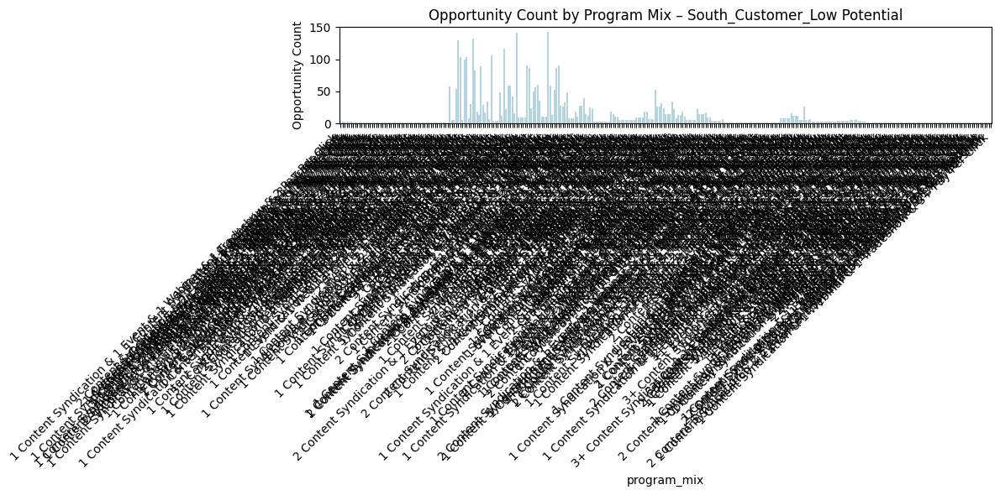

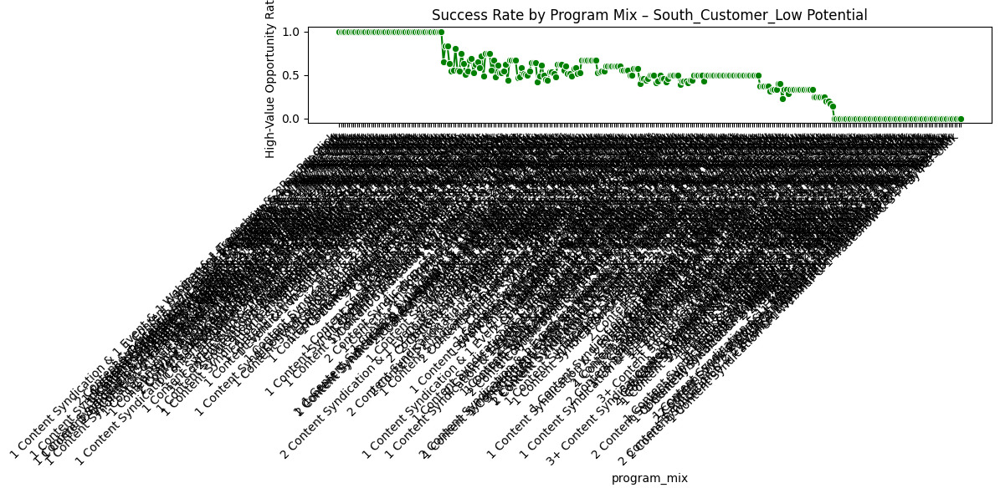


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
11   1 Content Syndication & 1 Event & 1 Webinar & ...      1.0      4   
98                1 Content Syndication & 3+ Tradeshow      1.0      3   
92   1 Content Syndication & 3+ Event & 1 Pay Per C...      1.0      3   
159                       1 Webinar & 3+ Pay Per Click      1.0      3   
251                     2 Tradeshow & 3+ Pay Per Click      1.0      3   
..                                                 ...      ...    ...   
214       2 Content Syndication & 3+ Event & 2 Webinar      0.0      1   
201  2 Content Syndication & 2 Event & 2 Webinar & ...      0.0      1   
199  2 Content Syndication & 2 Event & 1 Webinar & ...      0.0      1   
193   2 Content Syndication & 1 Webinar & 3+ Tradeshow      0.0      1   
45   1 Content Syndication & 1 Webinar & 1 Tradesho...      0.0      1   

     composite_score  
11          0.797153  
98          0.783683  
92          0

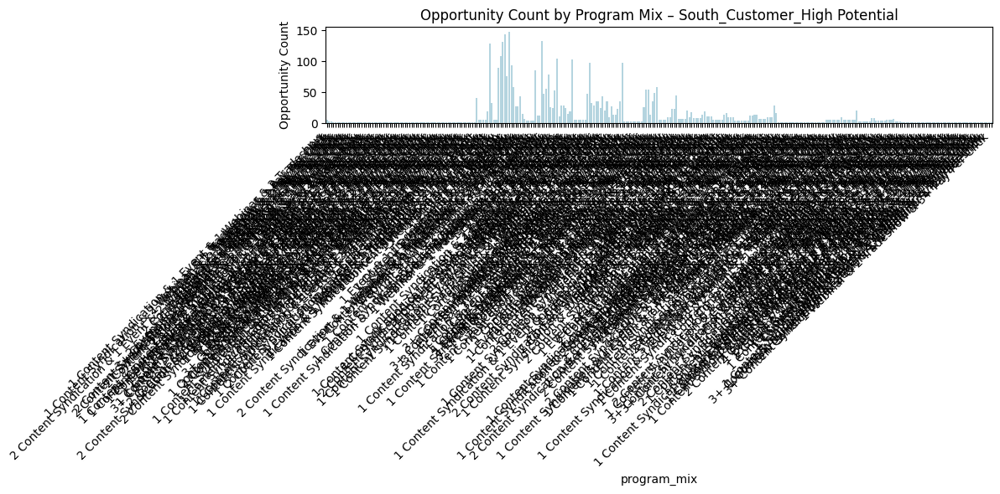

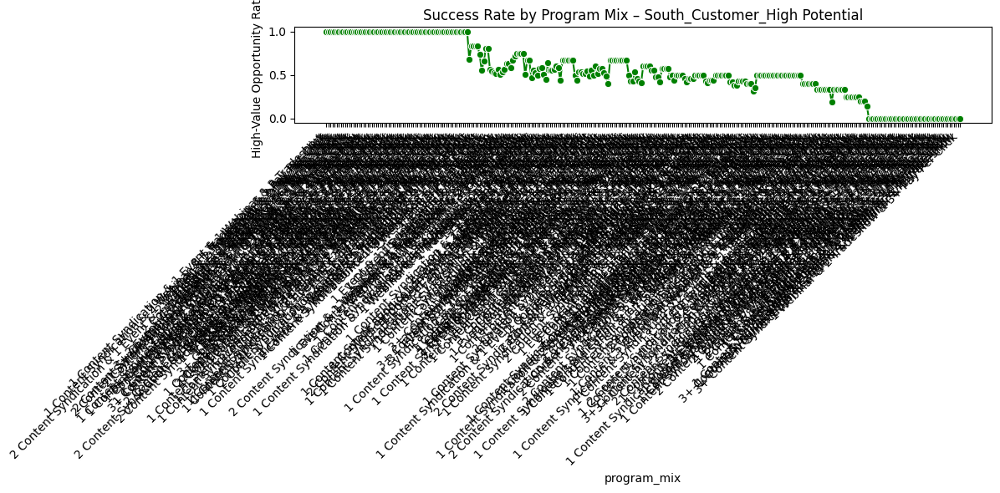


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
13   1 Content Syndication & 1 Event & 1 Webinar & ...      1.0      5   
296                     3+ Tradeshow & 1 Pay Per Click      1.0      3   
79   1 Content Syndication & 2 Webinar & 1 Tradesho...      1.0      3   
152          1 Webinar & 2 Tradeshow & 2 Pay Per Click      1.0      2   
288                         3+ Event & 2 Pay Per Click      1.0      2   
..                                                 ...      ...    ...   
262  3+ Content Syndication & 1 Event & 2 Webinar &...      0.0      1   
60   1 Content Syndication & 2 Event & 1 Webinar & ...      0.0      1   
269  3+ Content Syndication & 1 Webinar & 1 Pay Per...      0.0      1   
275  3+ Content Syndication & 2 Event & 1 Webinar &...      0.0      1   
153         1 Webinar & 2 Tradeshow & 3+ Pay Per Click      0.0      1   

     composite_score  
13          0.807421  
296         0.783112  
79          0

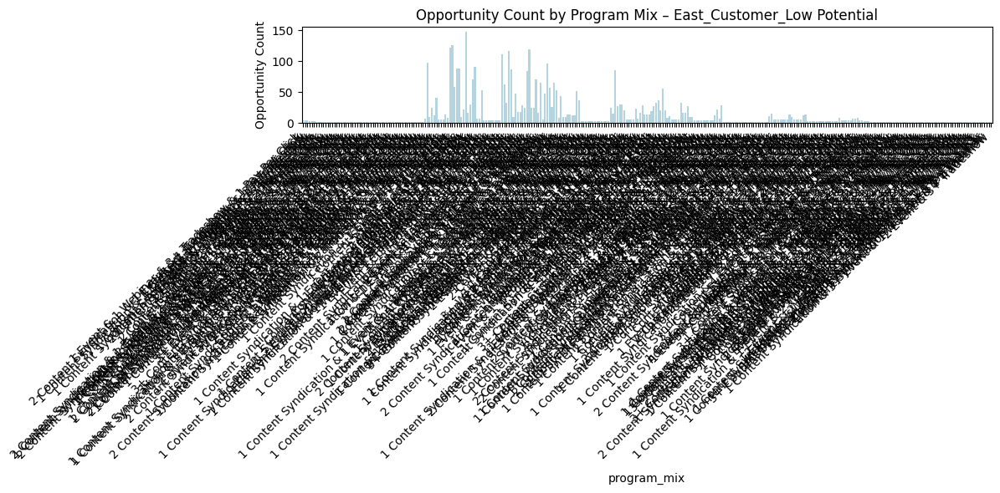

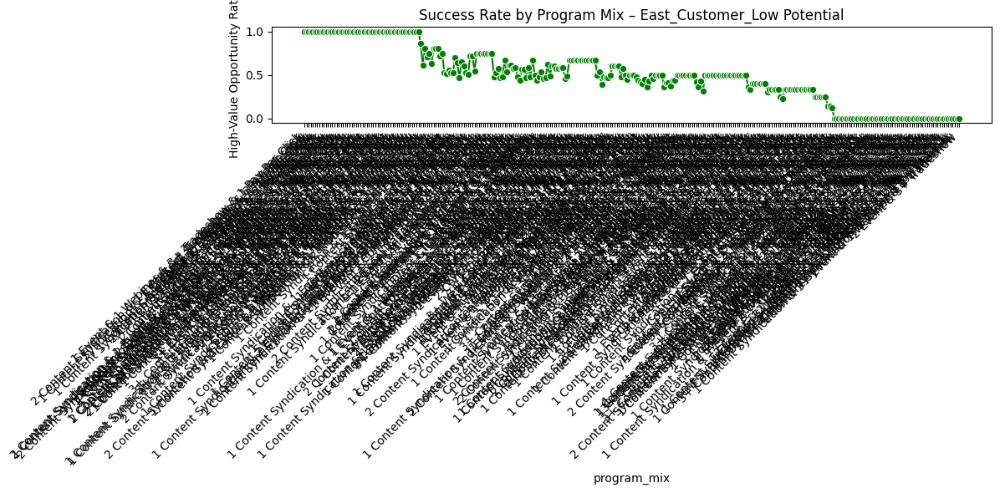


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
117  1 Event & 1 Webinar & 3+ Tradeshow & 1 Pay Per...      1.0      4   
160  2 Content Syndication & 1 Event & 1 Tradeshow ...      1.0      4   
93                1 Content Syndication & 3+ Tradeshow      1.0      4   
31   1 Content Syndication & 1 Event & 3+ Webinar &...      1.0      3   
199                2 Content Syndication & 2 Tradeshow      1.0      3   
..                                                 ...      ...    ...   
264  3+ Content Syndication & 1 Event & 1 Webinar &...      0.0      1   
265      3+ Content Syndication & 1 Event & 3+ Webinar      0.0      1   
66         1 Content Syndication & 2 Event & 2 Webinar      0.0      1   
89   1 Content Syndication & 3+ Event & 1 Webinar &...      0.0      1   
238                             2 Event & 3+ Tradeshow      0.0      1   

     composite_score  
117         0.796490  
160         0.796490  
93          0

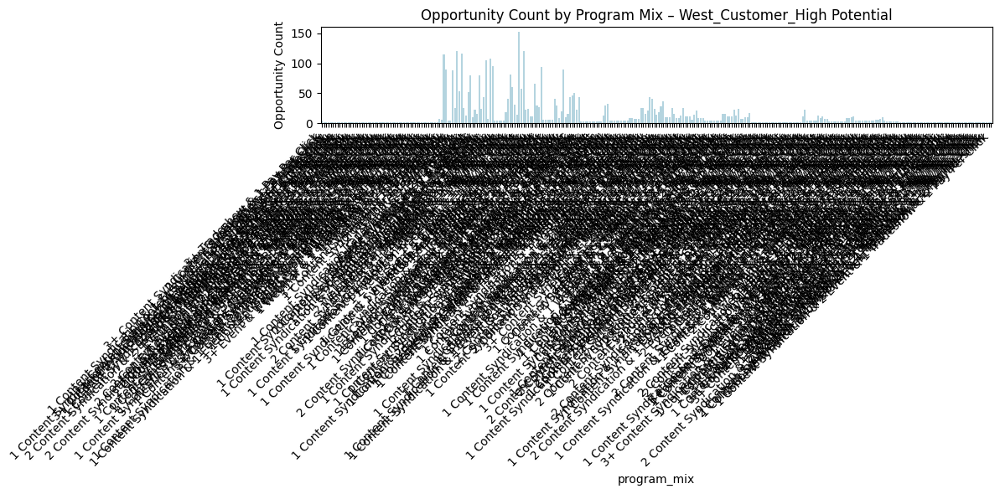

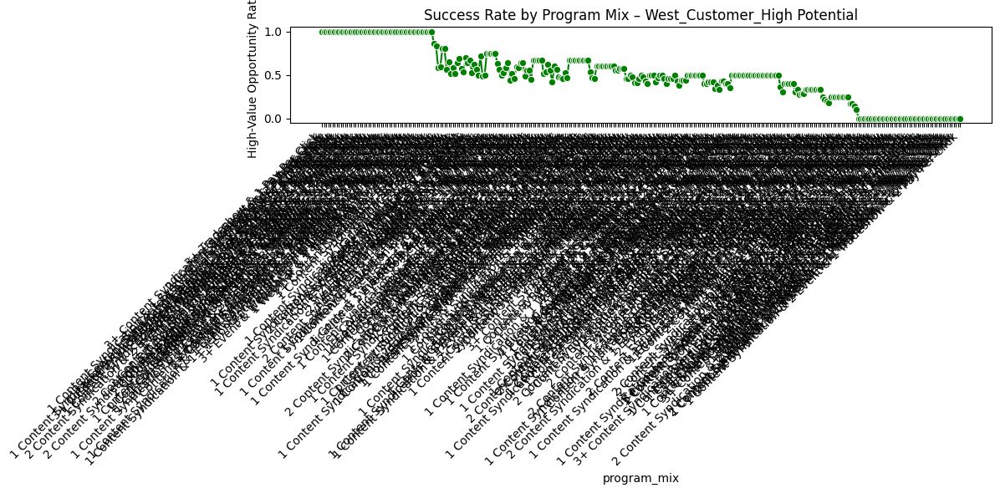


Program Mix Outcomes Table:
                                           program_mix  outcome  count  \
294                     3+ Tradeshow & 1 Pay Per Click      1.0      5   
273  3+ Content Syndication & 2 Event & 1 Pay Per C...      1.0      2   
199                2 Content Syndication & 2 Tradeshow      1.0      2   
251                           2 Webinar & 3+ Tradeshow      1.0      2   
6    1 Content Syndication & 1 Event & 1 Tradeshow ...      1.0      2   
..                                                 ...      ...    ...   
201  2 Content Syndication & 2 Tradeshow & 2 Pay Pe...      0.0      1   
205  2 Content Syndication & 2 Webinar & 1 Tradesho...      0.0      1   
43   1 Content Syndication & 1 Webinar & 1 Tradesho...      0.0      1   
211  2 Content Syndication & 3+ Event & 1 Webinar &...      0.0      1   
53   1 Content Syndication & 2 Event & 1 Tradeshow ...      0.0      1   

     composite_score  
294         0.806717  
273         0.765433  
199         0

In [158]:
recommended_program_mix_dict = generate_program_mix_recommendations(df)

### 4.5.3 Leads Attended & Distinct Touchpoints Analysis <a id="touchpoints_analysis"></a>

For finding the optimal distinct touchpoints and leads attended per segment, we'll focus on quality engagements that yield the highest mean outcome. 

Same weighted scoring using Composite Score as before. 

In [159]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from numpy import log1p

# Initialize output dictionaries
optimal_touchpoints_dict = {}
optimal_contacts_dict = {}

def analyze_touchpoints_and_leads(df):
    # Ensure outcome is numeric
    if df['outcome'].dtype.name == 'category':
        df['outcome'] = df['outcome'].cat.codes

    features_to_analyze = {
        'distinct_touchpoints': optimal_touchpoints_dict,
        'leads_attended_per_opp': optimal_contacts_dict
    }

    for segment_key in df['region_type'].unique():
        segment_data = df[df['region_type'] == segment_key]

        if segment_data.empty:
            continue

        print(f"\n📊 Segment: {segment_key}")

        for feature, result_dict in features_to_analyze.items():
            grouped = segment_data.groupby(feature)['outcome'].agg(['mean', 'count', 'std']).reset_index()

            # Normalize and calculate composite score
            grouped['normalized_success'] = grouped['mean'] / grouped['mean'].max()
            grouped['normalized_count'] = log1p(grouped['count']) / log1p(grouped['count'].max())
            grouped['composite_score'] = (0.7 * grouped['normalized_success']) + (0.3 * grouped['normalized_count'])
            grouped.sort_values(by='composite_score', ascending=False, inplace=True)

            # 📊 Plot opportunity counts
            plt.figure(figsize=(10, 5))
            plt.bar(grouped[feature], grouped['count'], color='lightblue')
            plt.xlabel(feature)
            plt.ylabel('Opportunity Count')
            plt.title(f'{feature} - Opportunity Count ({segment_key})')
            plt.tight_layout()
            plt.show()

            # 📈 Plot success rate
            plt.figure(figsize=(10, 5))
            plt.plot(grouped[feature], grouped['mean'], color='green', marker='o')
            plt.xlabel(feature)
            plt.ylabel('High-Value Opportunity Rate')
            plt.title(f'{feature} - Success Rate ({segment_key})')
            plt.tight_layout()
            plt.show()

            # 📄 Display table
            print(f"\nFeature: {feature} — {segment_key}")
            print(grouped[[feature, 'mean', 'count', 'composite_score']])

            # 🏆 Save optimal value
            best_value = grouped.iloc[0][feature]
            result_dict[segment_key] = best_value

            print(f"✅ Recommended {feature} for {segment_key}: {best_value}")

    return optimal_touchpoints_dict, optimal_contacts_dict


📊 Segment: North_Customer_Low Potential


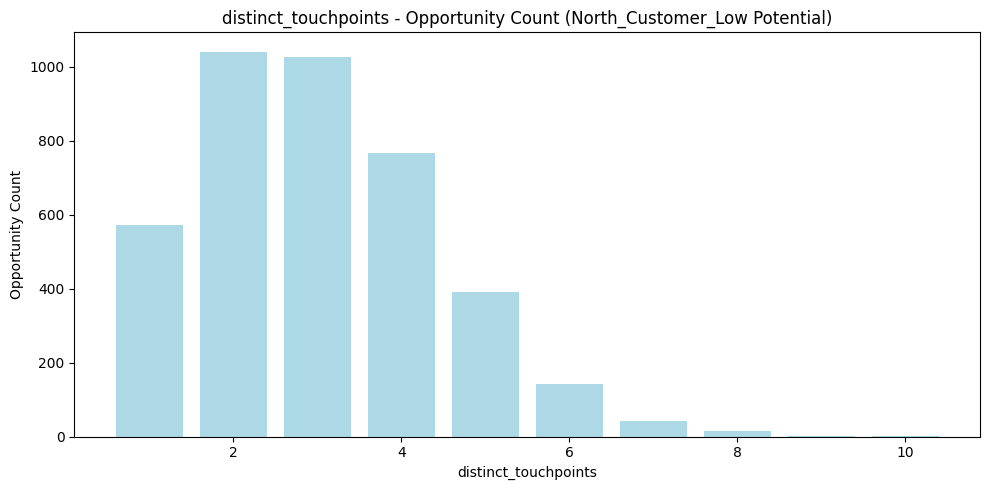

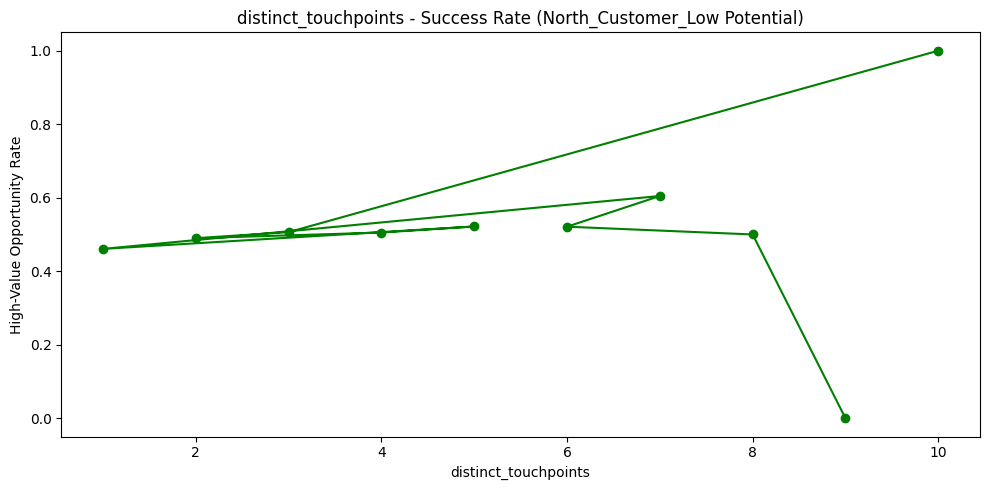


Feature: distinct_touchpoints — North_Customer_Low Potential
   distinct_touchpoints      mean  count  composite_score
9                    10  1.000000      2         0.747430
2                     3  0.506329   1027         0.653846
1                     2  0.489914   1041         0.642939
3                     4  0.505222    766         0.640427
4                     5  0.521739    391         0.623011
0                     1  0.460733    573         0.596771
6                     7  0.604651     43         0.586628
5                     6  0.521127    142         0.579046
7                     8  0.500000     14         0.466913
8                     9  0.000000      1         0.029925
✅ Recommended distinct_touchpoints for North_Customer_Low Potential: 10.0


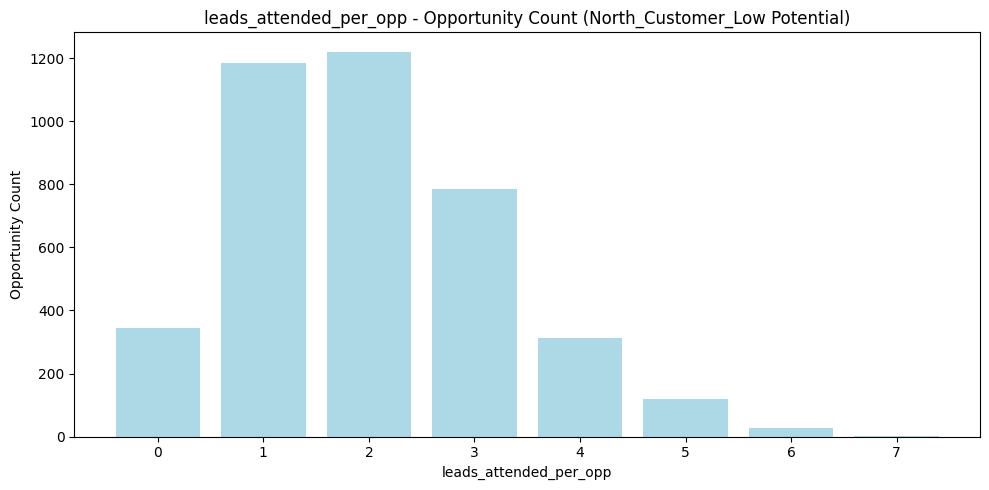

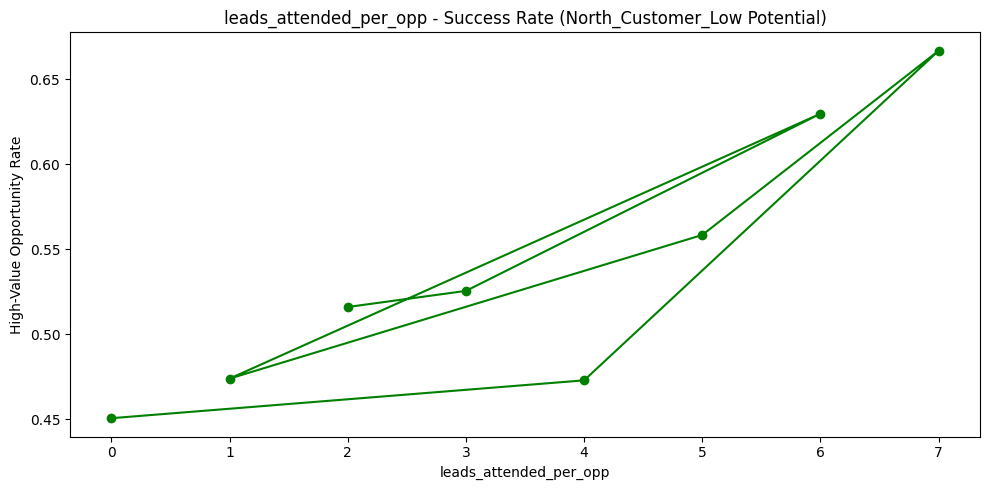


Feature: leads_attended_per_opp — North_Customer_Low Potential
   leads_attended_per_opp      mean  count  composite_score
2                     2.0  0.515971   1221         0.841769
3                     3.0  0.525445    786         0.833147
6                     6.0  0.629630     27         0.801745
1                     1.0  0.473862   1186         0.796328
5                     5.0  0.558333    120         0.788654
7                     7.0  0.666667      3         0.758508
4                     4.0  0.472843    313         0.739136
0                     0.0  0.450581    344         0.719734
✅ Recommended leads_attended_per_opp for North_Customer_Low Potential: 2.0

📊 Segment: East_Customer_High Potential


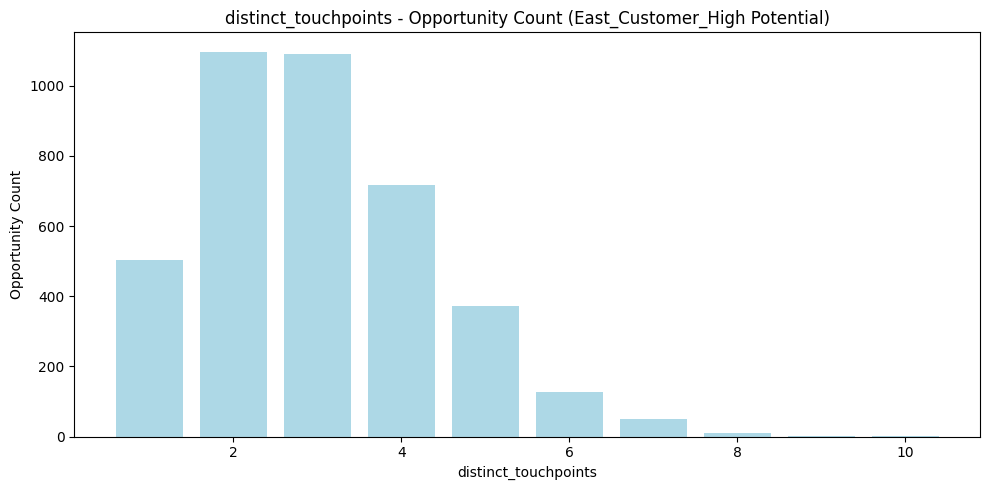

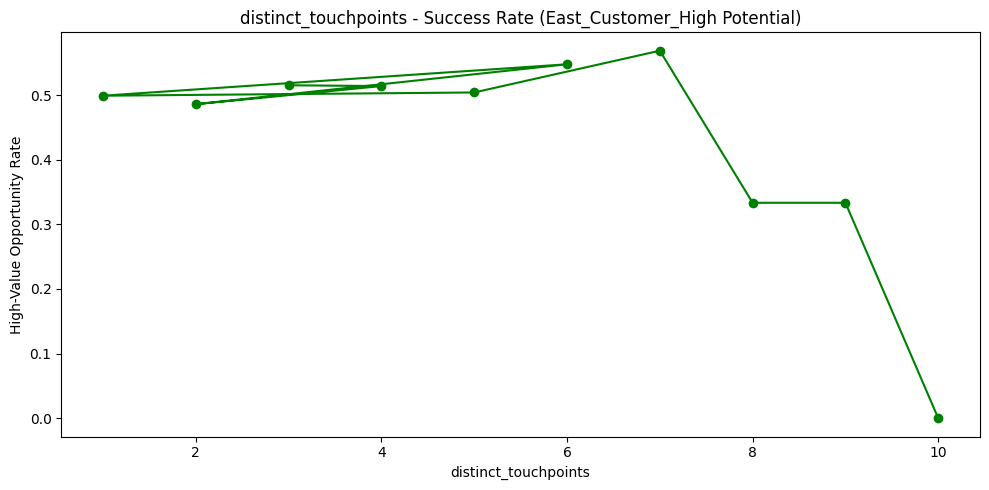


Feature: distinct_touchpoints — East_Customer_High Potential
   distinct_touchpoints      mean  count  composite_score
2                     3  0.515152   1089         0.933856
3                     4  0.513928    718         0.914521
1                     2  0.485871   1097         0.898123
5                     6  0.547619    126         0.881709
0                     1  0.499006    503         0.880928
4                     5  0.504021    373         0.874319
6                     7  0.568627     51         0.869309
7                     8  0.333333      9         0.509009
8                     9  0.333333      3         0.469747
9                    10  0.000000      2         0.047075
✅ Recommended distinct_touchpoints for East_Customer_High Potential: 3.0


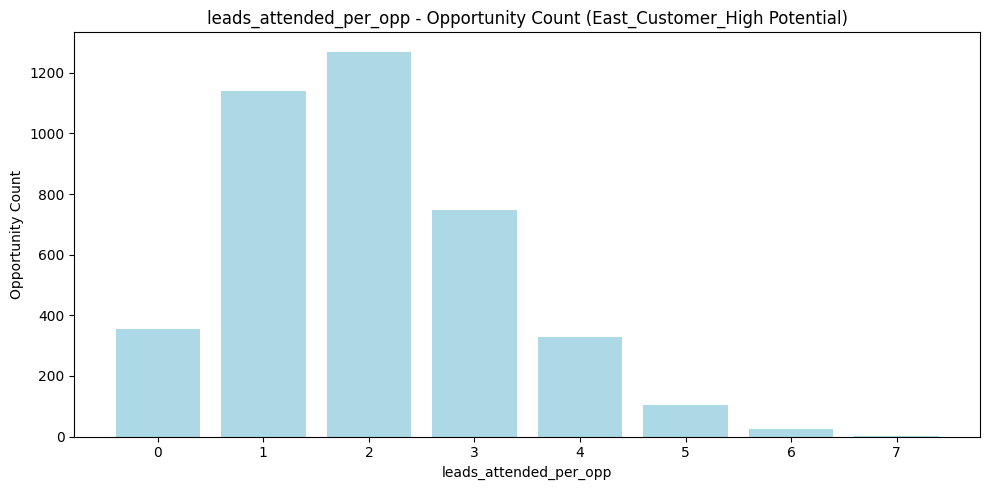

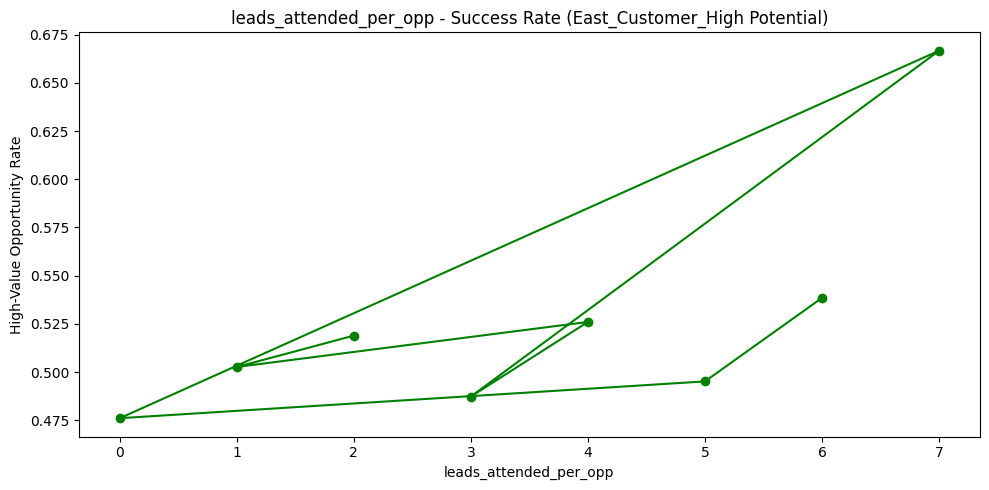


Feature: leads_attended_per_opp — East_Customer_High Potential
   leads_attended_per_opp      mean  count  composite_score
2                     2.0  0.518898   1270         0.844843
1                     1.0  0.502632   1140         0.823234
4                     4.0  0.525994    327         0.795440
3                     3.0  0.487282    747         0.789395
7                     7.0  0.666667      3         0.758186
0                     0.0  0.476056    355         0.746444
5                     5.0  0.495146    103         0.714839
6                     6.0  0.538462     26         0.703719
✅ Recommended leads_attended_per_opp for East_Customer_High Potential: 2.0

📊 Segment: South_Prospect_


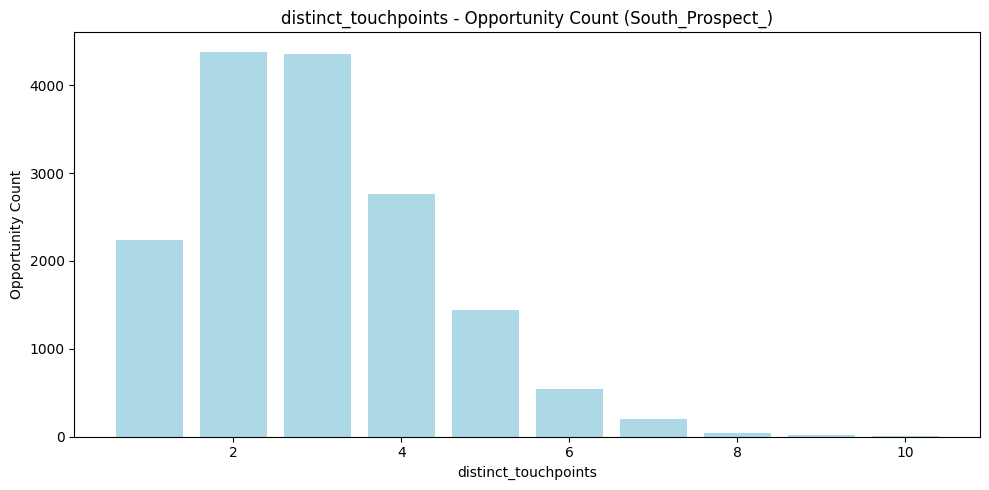

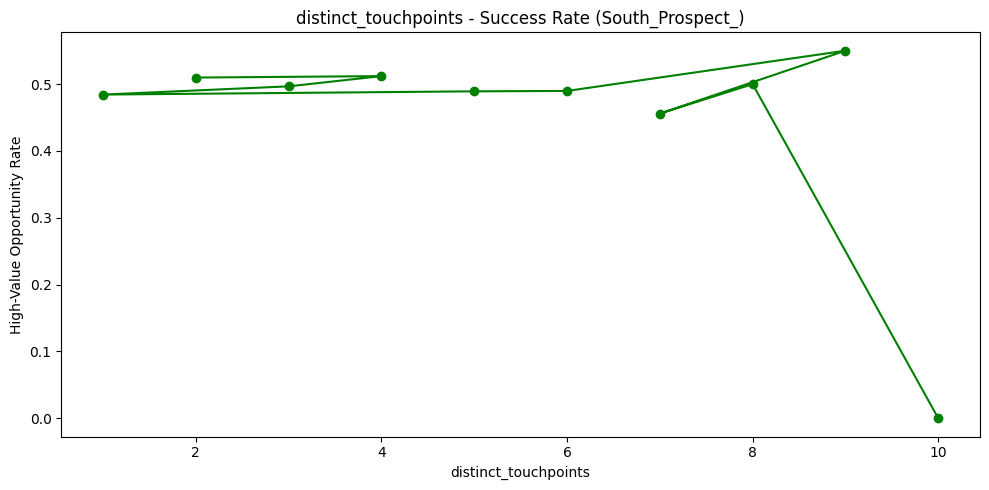


Feature: distinct_touchpoints — South_Prospect_
   distinct_touchpoints      mean  count  composite_score
1                     2  0.509813   4382         0.948853
3                     4  0.511974   2756         0.935018
2                     3  0.496672   4357         0.931923
0                     1  0.484347   2236         0.892379
4                     5  0.489214   1437         0.882764
5                     6  0.489796    539         0.848464
8                     9  0.550000     20         0.808921
6                     7  0.455882    204         0.770650
7                     8  0.500000     40         0.769221
9                    10  0.000000      1         0.024798
✅ Recommended distinct_touchpoints for South_Prospect_: 2.0


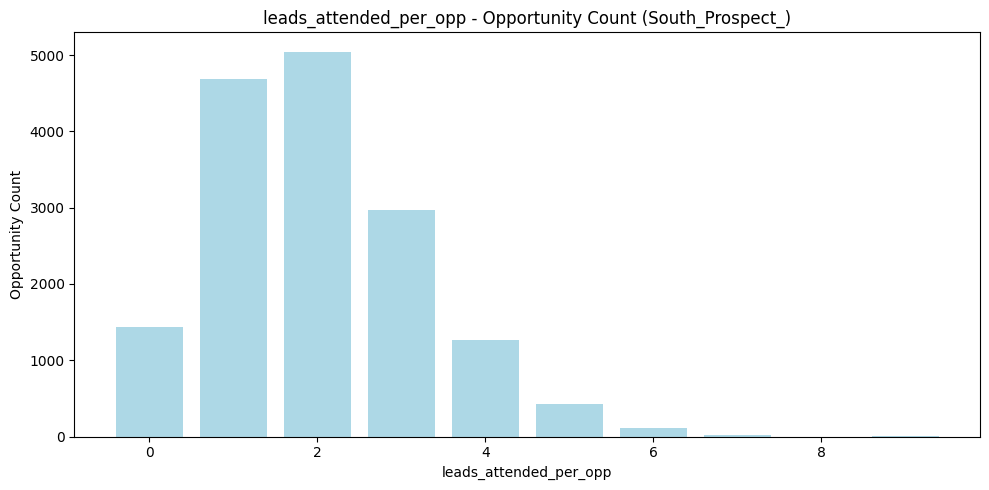

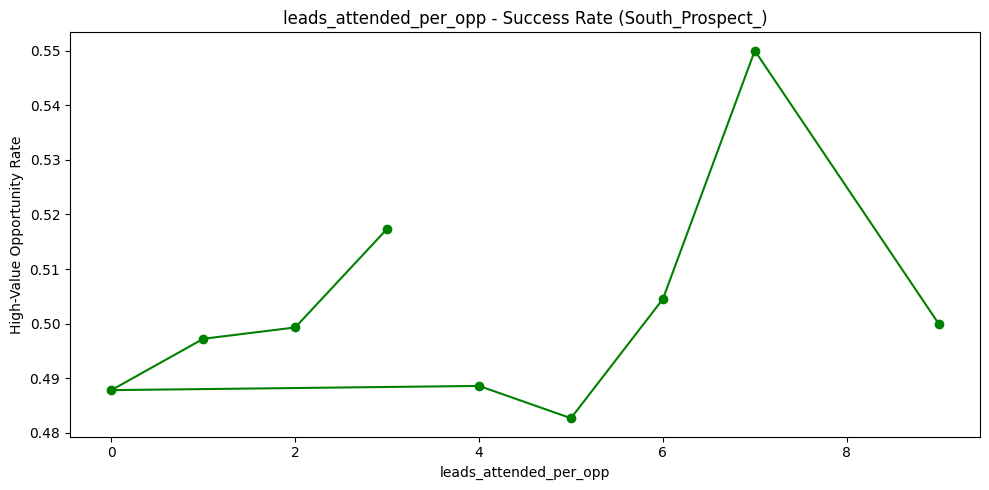


Feature: leads_attended_per_opp — South_Prospect_
   leads_attended_per_opp      mean  count  composite_score
3                     3.0  0.517369   2965         0.939773
2                     2.0  0.499306   5045         0.935481
1                     1.0  0.497227   4688         0.930253
0                     0.0  0.487822   1437         0.876695
4                     4.0  0.488592   1271         0.873359
5                     5.0  0.482679    433         0.827999
6                     6.0  0.504505    111         0.808117
7                     7.0  0.550000     20         0.807122
8                     9.0  0.500000      2         0.675018
✅ Recommended leads_attended_per_opp for South_Prospect_: 3.0

📊 Segment: West_Prospect_


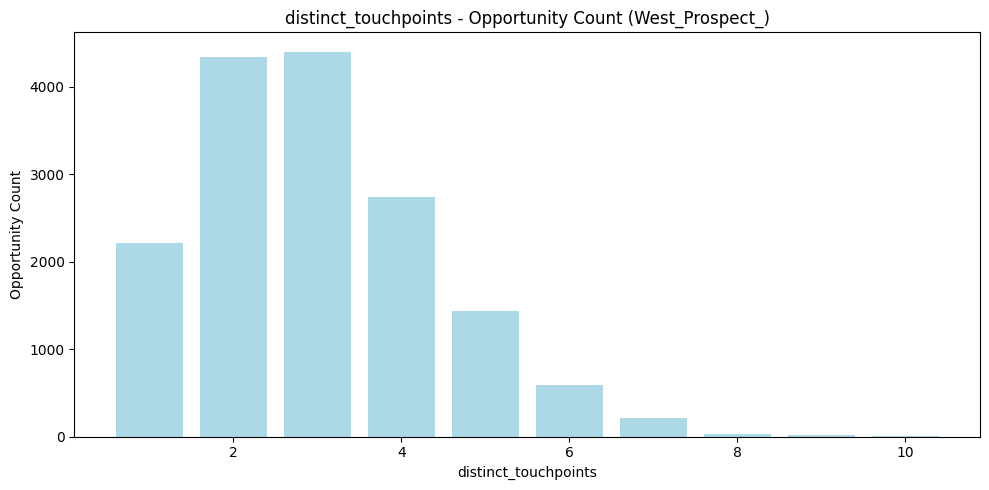

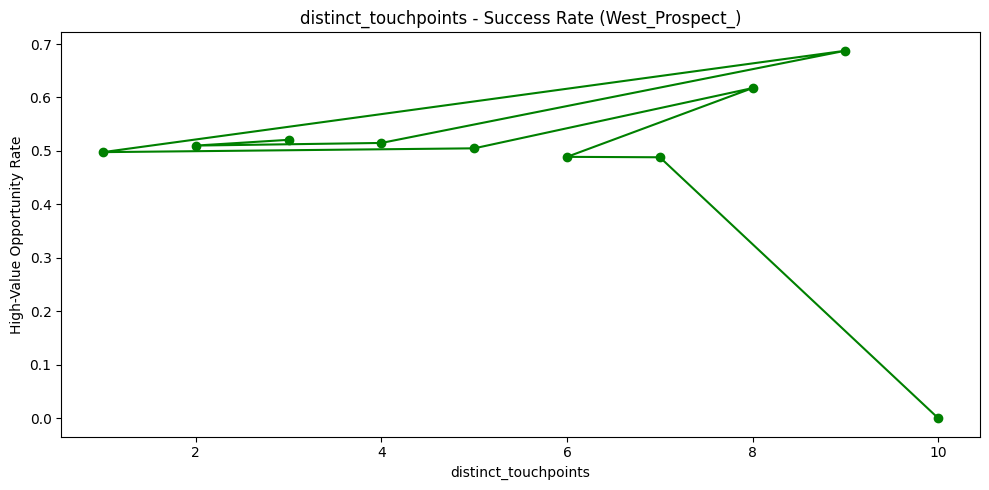


Feature: distinct_touchpoints — West_Prospect_
   distinct_touchpoints      mean  count  composite_score
2                     3  0.520800   4399         0.830269
1                     2  0.510021   4341         0.818819
3                     4  0.514953   2742         0.807417
8                     9  0.687500     16         0.801315
0                     1  0.497744   2216         0.782282
4                     5  0.504881   1434         0.773995
7                     8  0.617647     34         0.756015
5                     6  0.488927    587         0.725845
6                     7  0.488152    211         0.688576
9                    10  0.000000      1         0.024787
✅ Recommended distinct_touchpoints for West_Prospect_: 3.0


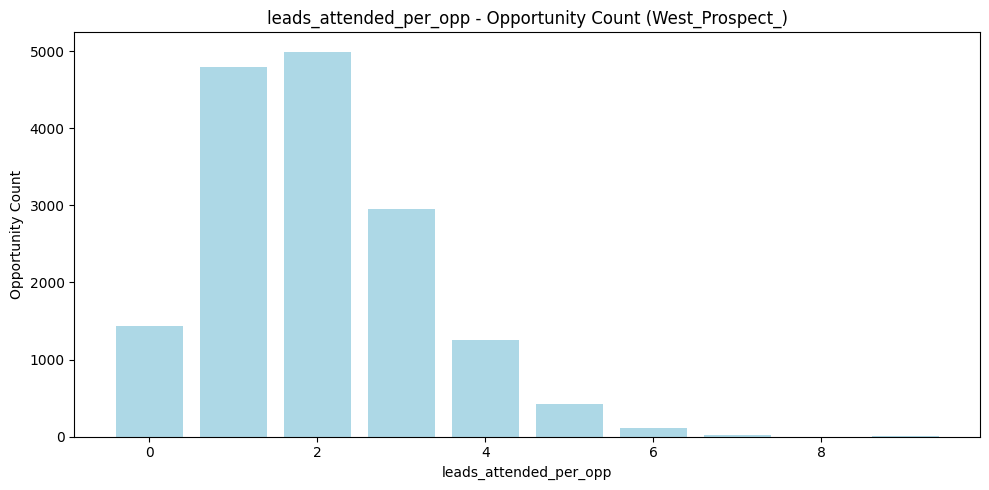

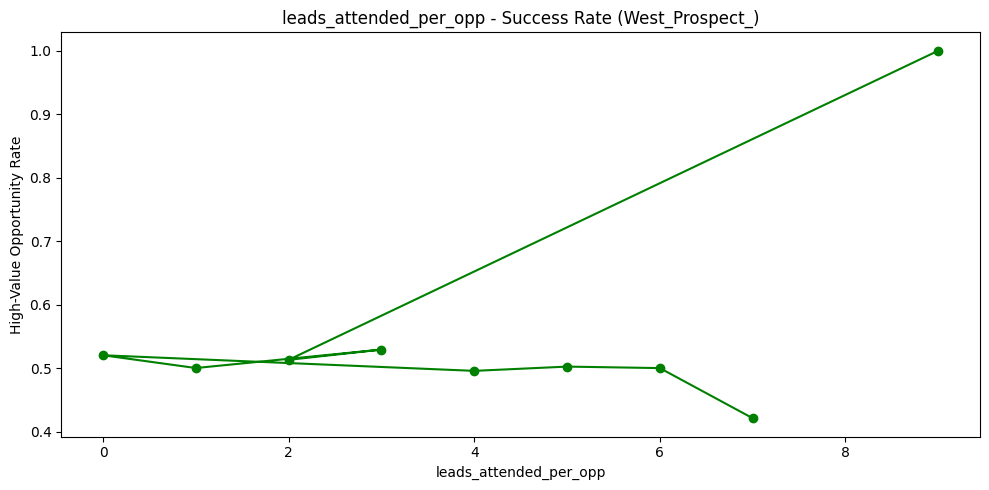


Feature: leads_attended_per_opp — West_Prospect_
   leads_attended_per_opp      mean  count  composite_score
8                     9.0  1.000000      2         0.738699
2                     2.0  0.513010   4996         0.659107
3                     3.0  0.529153   2950         0.651854
1                     1.0  0.500104   4791         0.648597
0                     0.0  0.520223   1434         0.620206
4                     4.0  0.495625   1257         0.598350
5                     5.0  0.502347    426         0.564996
6                     6.0  0.500000    106         0.514602
7                     7.0  0.421053     19         0.400263
✅ Recommended leads_attended_per_opp for West_Prospect_: 9.0

📊 Segment: North_Prospect_


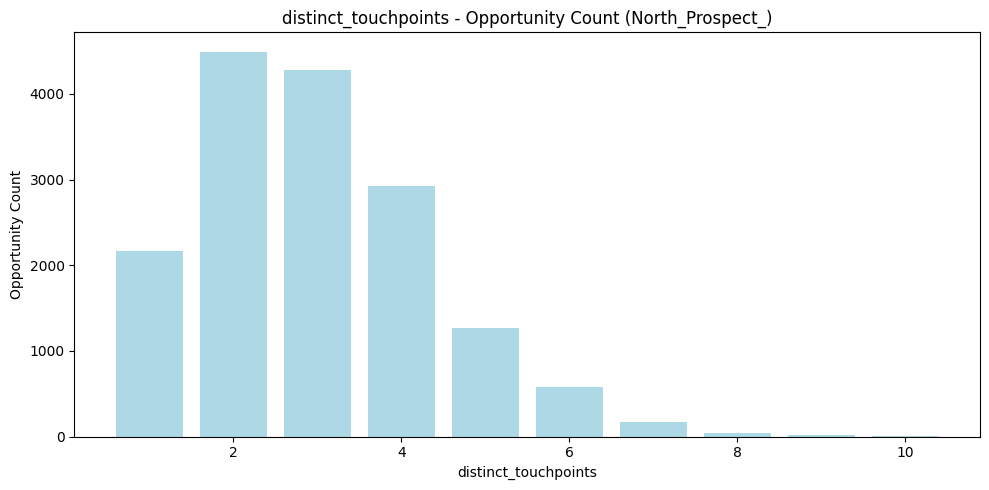

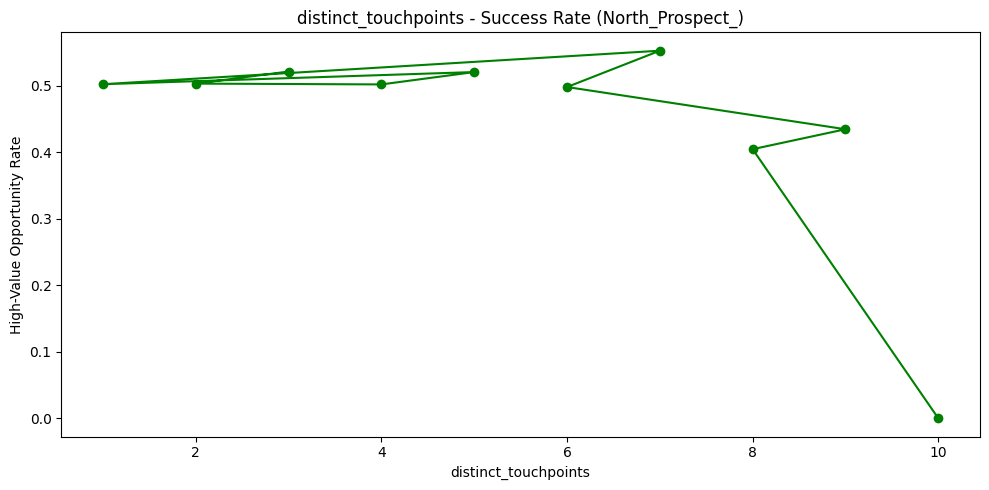


Feature: distinct_touchpoints — North_Prospect_
   distinct_touchpoints      mean  count  composite_score
2                     3  0.521637   4275         0.958597
1                     2  0.503450   4493         0.937346
3                     4  0.502221   2927         0.920508
4                     5  0.520817   1273         0.914368
0                     1  0.502540   2165         0.910161
6                     7  0.552941    170         0.883402
5                     6  0.498288    584         0.858085
8                     9  0.434783     23         0.663777
7                     8  0.404762     42         0.646572
9                    10  0.000000      2         0.039187
✅ Recommended distinct_touchpoints for North_Prospect_: 3.0


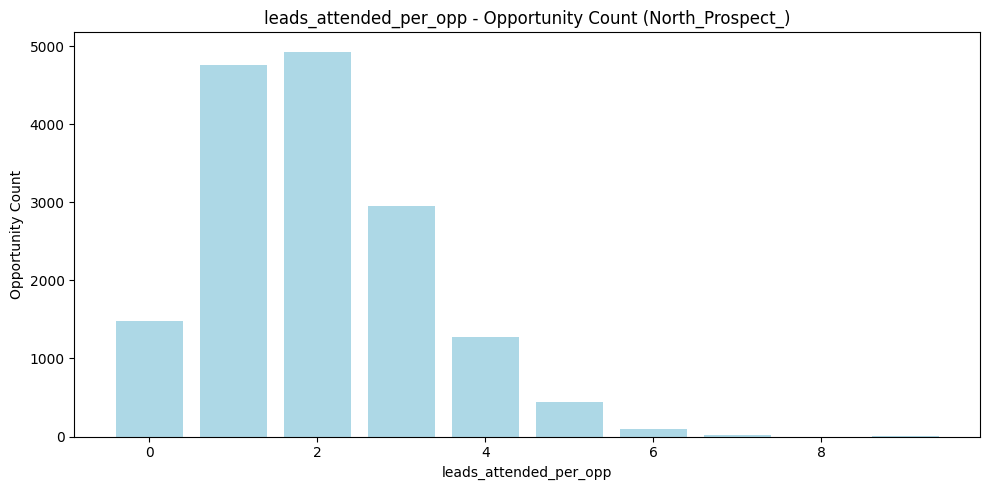

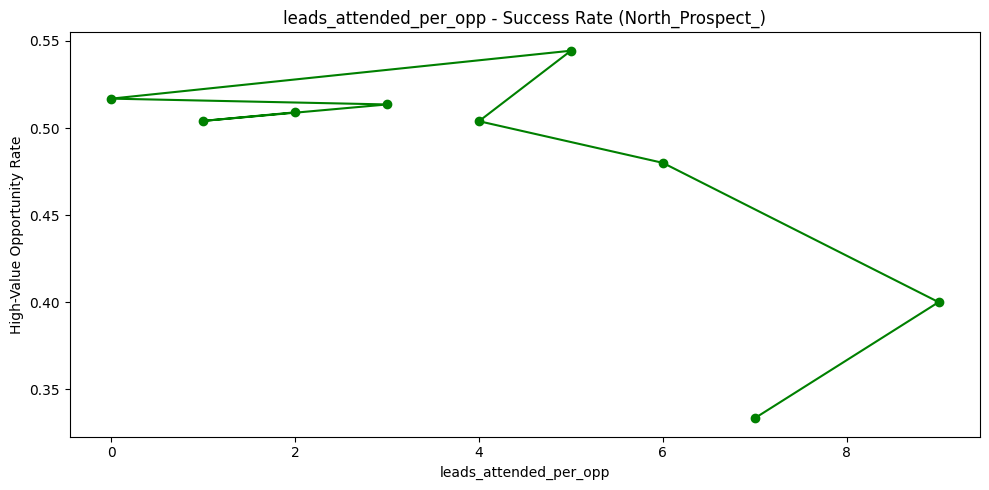


Feature: leads_attended_per_opp — North_Prospect_
   leads_attended_per_opp      mean  count  composite_score
2                     2.0  0.509028   4929         0.954495
1                     1.0  0.504097   4759         0.946917
3                     3.0  0.513550   2952         0.942227
0                     0.0  0.516892   1480         0.922176
5                     5.0  0.544419    439         0.914749
4                     4.0  0.503931   1272         0.900172
6                     6.0  0.480000    100         0.779999
8                     9.0  0.400000      5         0.577525
7                     7.0  0.333333     18         0.532475
✅ Recommended leads_attended_per_opp for North_Prospect_: 2.0

📊 Segment: North_Customer_High Potential


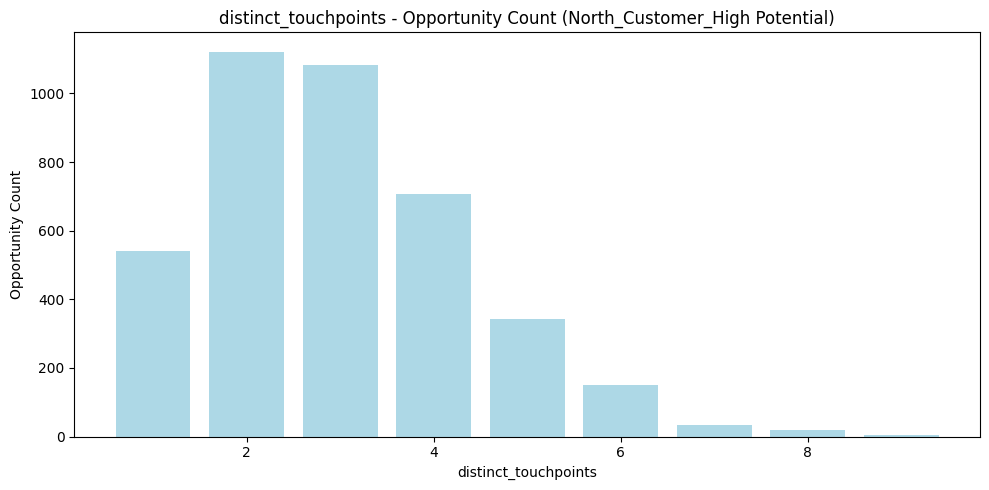

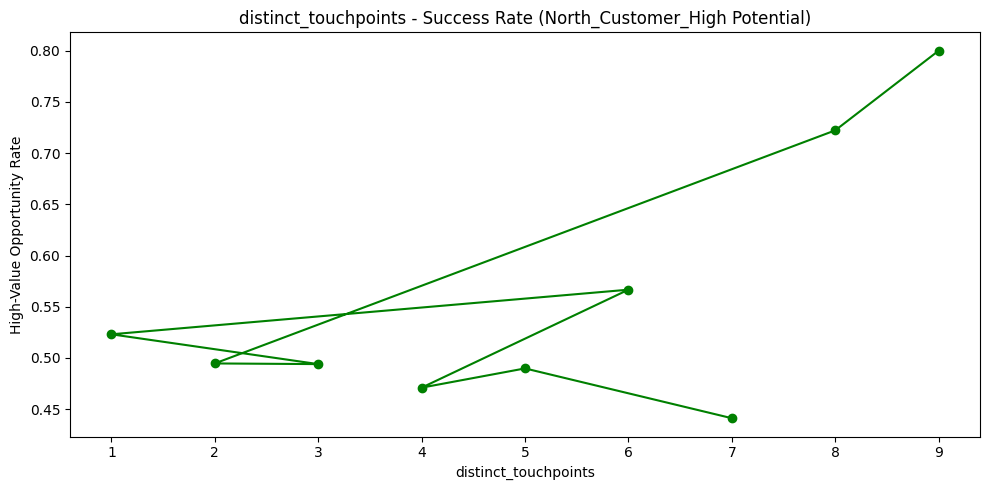


Feature: distinct_touchpoints — North_Customer_High Potential
   distinct_touchpoints      mean  count  composite_score
8                     9  0.800000      5         0.776530
7                     8  0.722222     18         0.757708
1                     2  0.494652   1122         0.732821
2                     3  0.493998   1083         0.730739
0                     1  0.523105    541         0.726602
5                     6  0.566667    150         0.710132
3                     4  0.471004    707         0.692425
4                     5  0.489796    343         0.678038
6                     7  0.441176     34         0.537886
✅ Recommended distinct_touchpoints for North_Customer_High Potential: 9.0


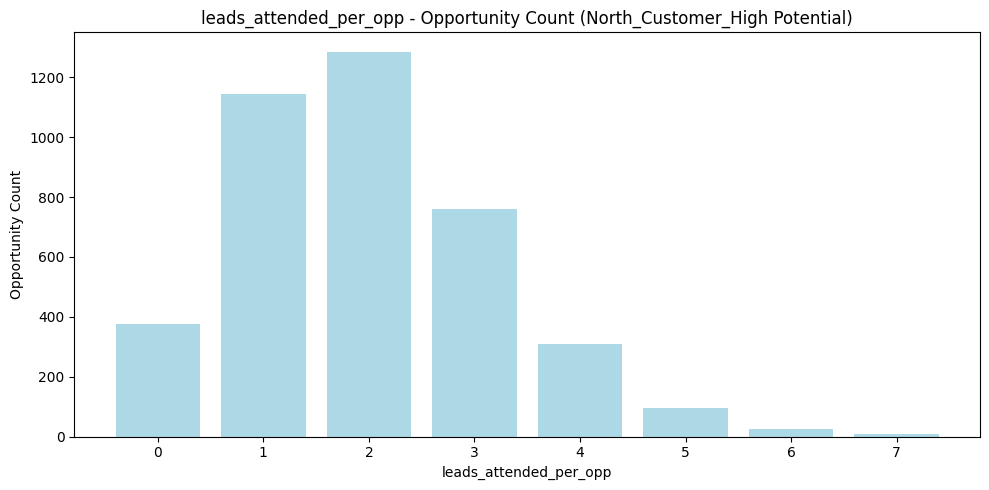

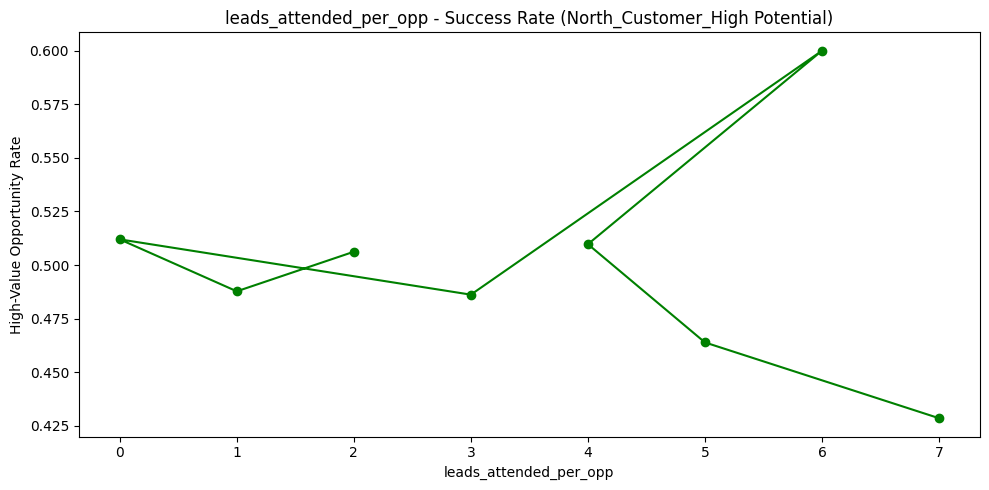


Feature: leads_attended_per_opp — North_Customer_High Potential
   leads_attended_per_opp      mean  count  composite_score
2                     2.0  0.506221   1286         0.890591
1                     1.0  0.487762   1144         0.864158
0                     0.0  0.512000    375         0.845777
3                     3.0  0.486202    761         0.845276
6                     6.0  0.600000     25         0.836511
4                     4.0  0.509740    308         0.834918
5                     5.0  0.463918     97         0.733343
7                     7.0  0.428571      7         0.587127
✅ Recommended leads_attended_per_opp for North_Customer_High Potential: 2.0

📊 Segment: West_Customer_Low Potential


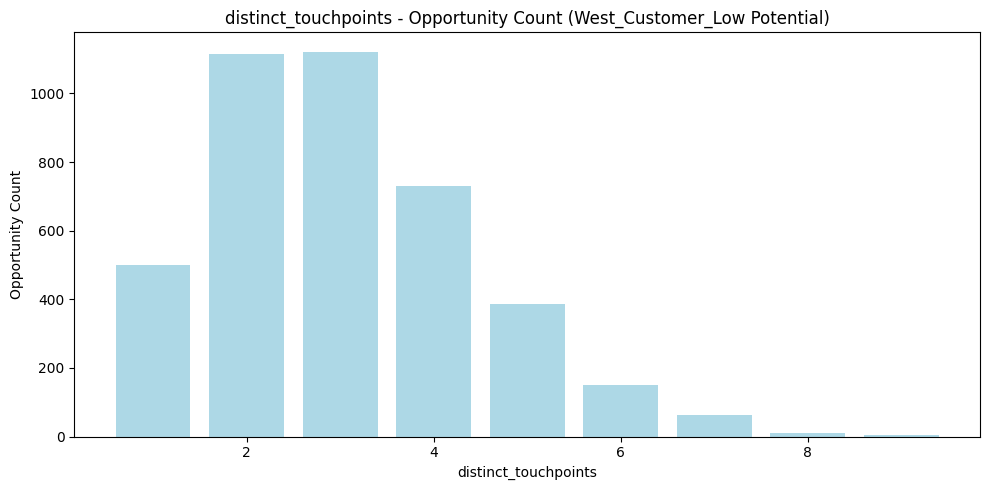

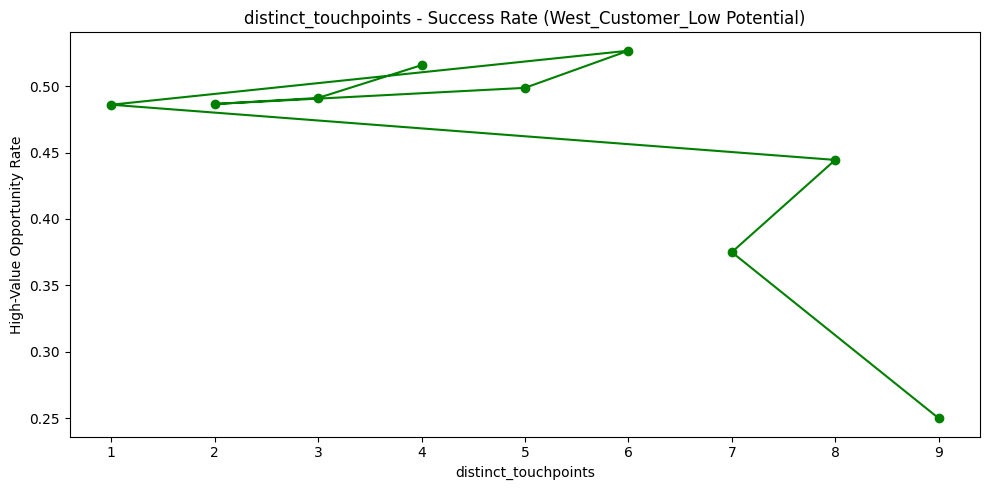


Feature: distinct_touchpoints — West_Customer_Low Potential
   distinct_touchpoints      mean  count  composite_score
3                     4  0.515775    729         0.967127
2                     3  0.491087   1122         0.952711
1                     2  0.486535   1114         0.946355
4                     5  0.498701    385         0.917218
5                     6  0.526667    150         0.914299
0                     1  0.486000    500         0.911474
7                     8  0.444444      9         0.689066
6                     7  0.375000     64         0.676715
8                     9  0.250000      4         0.401021
✅ Recommended distinct_touchpoints for West_Customer_Low Potential: 4.0


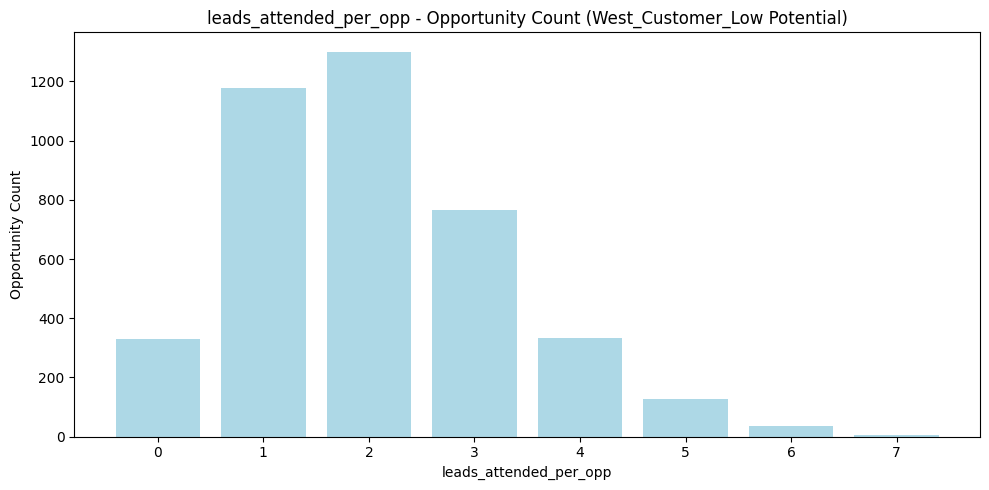

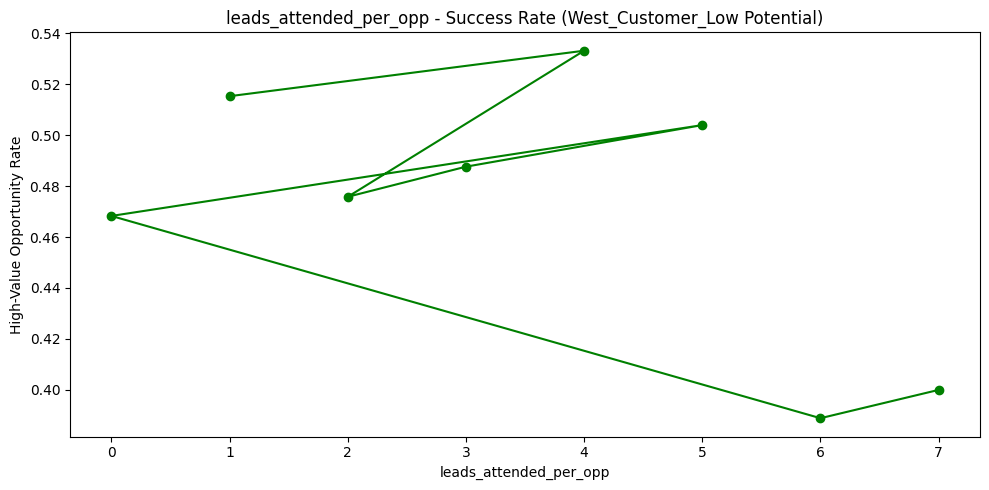


Feature: leads_attended_per_opp — West_Customer_Low Potential
   leads_attended_per_opp      mean  count  composite_score
1                     1.0  0.515280   1178         0.972409
4                     4.0  0.533133    332         0.942962
2                     2.0  0.475788   1301         0.924707
3                     3.0  0.487614    767         0.918153
5                     5.0  0.503937    127         0.864633
0                     0.0  0.468278    331         0.857683
6                     6.0  0.388889     36         0.661658
7                     7.0  0.400000      5         0.600149
✅ Recommended leads_attended_per_opp for West_Customer_Low Potential: 1.0

📊 Segment: East_Prospect_


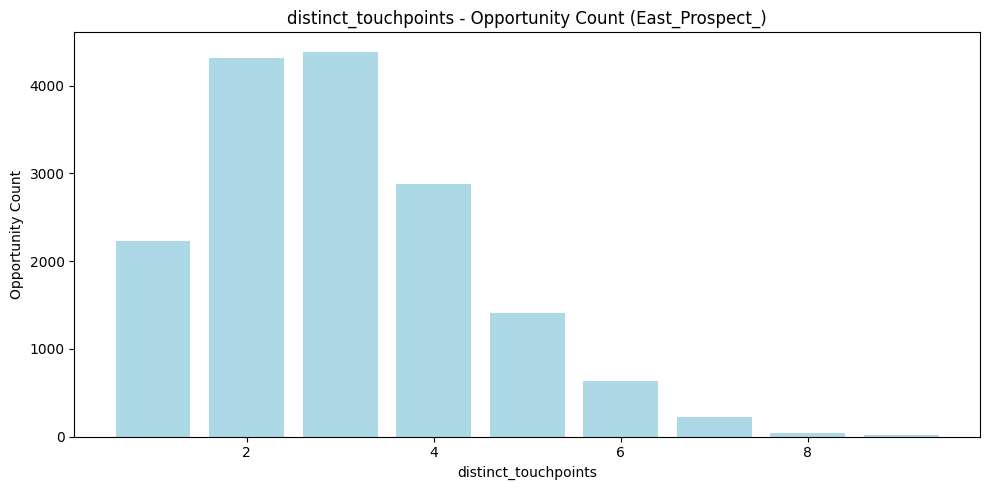

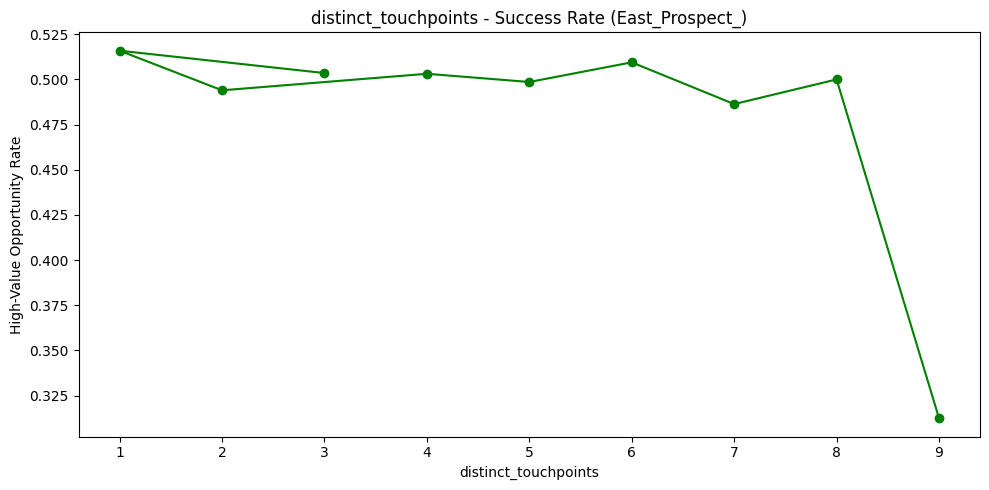


Feature: distinct_touchpoints — East_Prospect_
   distinct_touchpoints      mean  count  composite_score
2                     3  0.503532   4389         0.983221
0                     1  0.515898   2233         0.975837
1                     2  0.493981   4320         0.969696
3                     4  0.503123   2882         0.967625
4                     5  0.498582   1410         0.935905
5                     6  0.509464    634         0.922111
6                     7  0.486364    220         0.853015
7                     8  0.500000     36         0.807589
8                     9  0.312500     16         0.525360
✅ Recommended distinct_touchpoints for East_Prospect_: 3.0


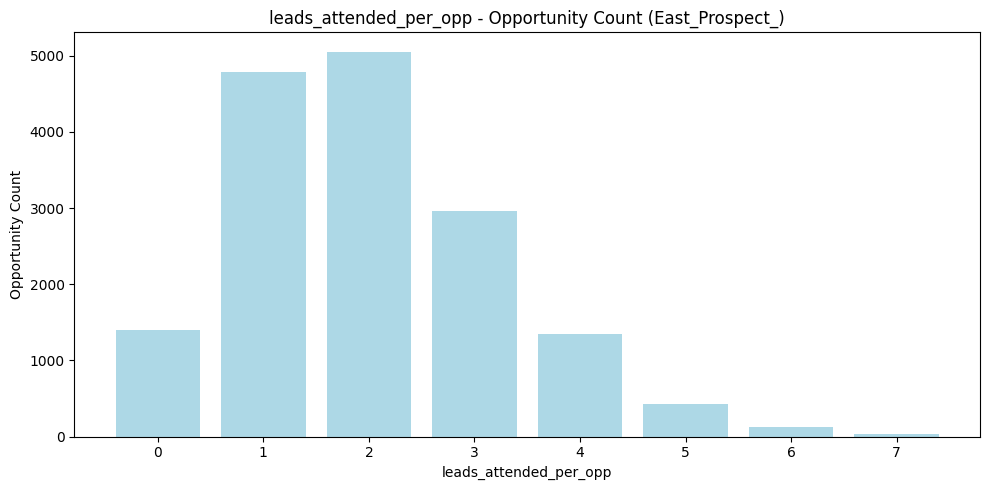

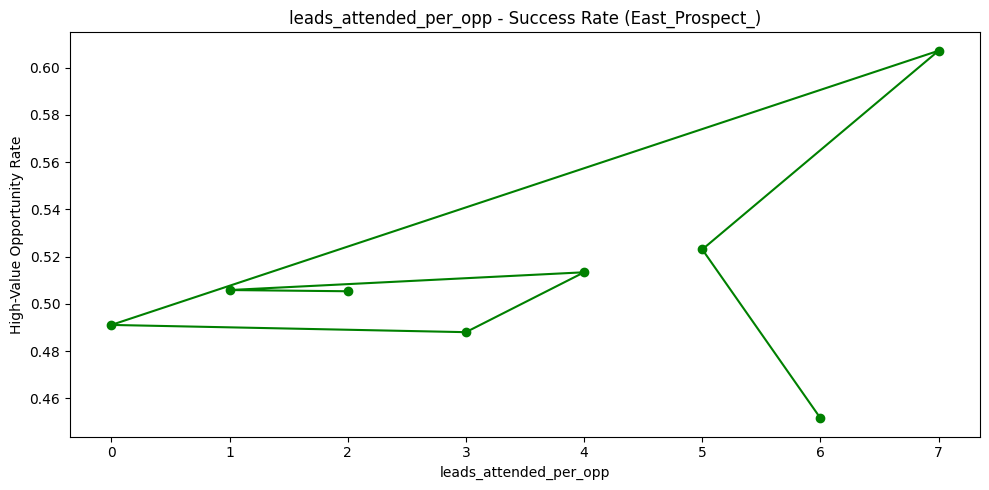


Feature: leads_attended_per_opp — East_Prospect_
   leads_attended_per_opp      mean  count  composite_score
2                     2.0  0.505340   5056         0.882628
1                     1.0  0.505853   4784         0.881274
4                     4.0  0.513373   1346         0.845355
3                     3.0  0.488027   2965         0.843898
0                     0.0  0.491091   1403         0.821122
7                     7.0  0.607143     28         0.818448
5                     5.0  0.523041    434         0.816743
6                     6.0  0.451613    124         0.690524
✅ Recommended leads_attended_per_opp for East_Prospect_: 2.0

📊 Segment: South_Customer_Low Potential


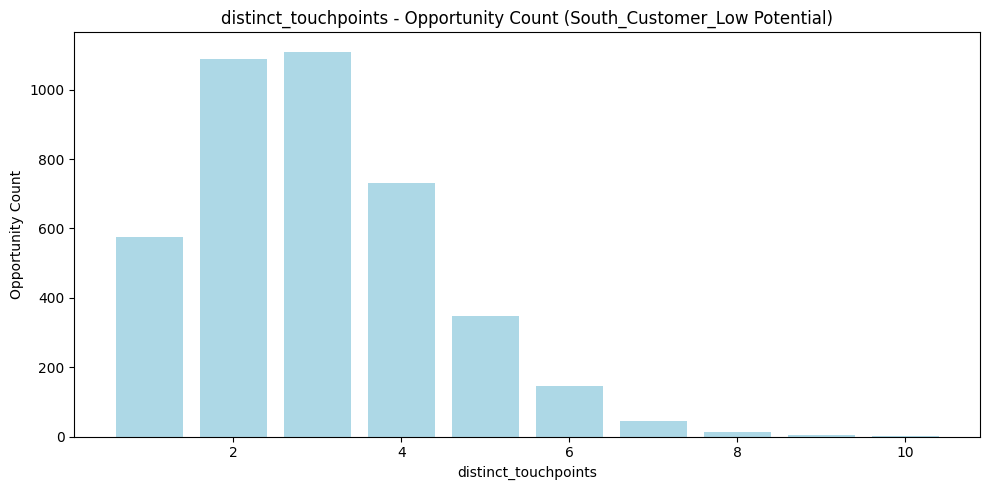

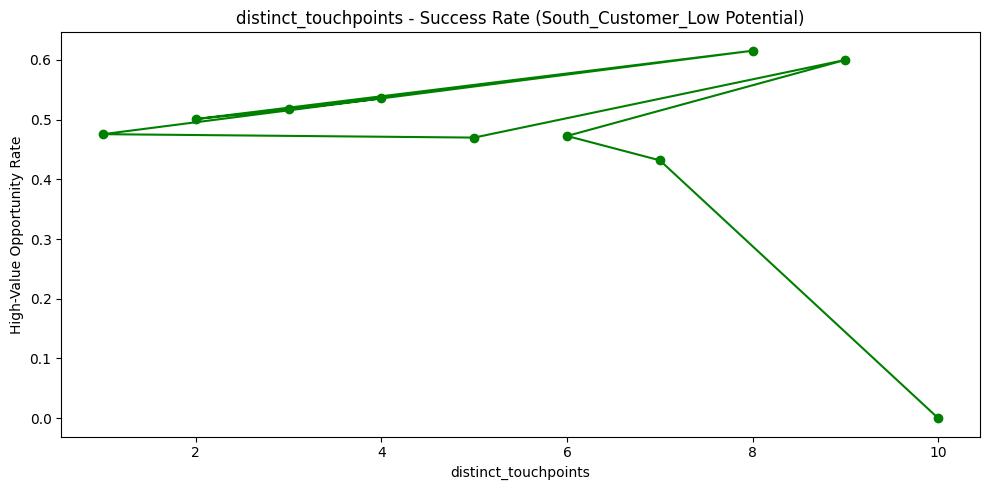


Feature: distinct_touchpoints — South_Customer_Low Potential
   distinct_touchpoints      mean  count  composite_score
3                     4  0.535519    732         0.891363
2                     3  0.517117   1110         0.888221
1                     2  0.500917   1090         0.869016
7                     8  0.615385     13         0.812893
0                     1  0.475610    574         0.812831
4                     5  0.469914    349         0.785116
8                     9  0.600000      5         0.759147
5                     6  0.472603    146         0.751064
6                     7  0.431818     44         0.654033
9                    10  0.000000      1         0.029651
✅ Recommended distinct_touchpoints for South_Customer_Low Potential: 4.0


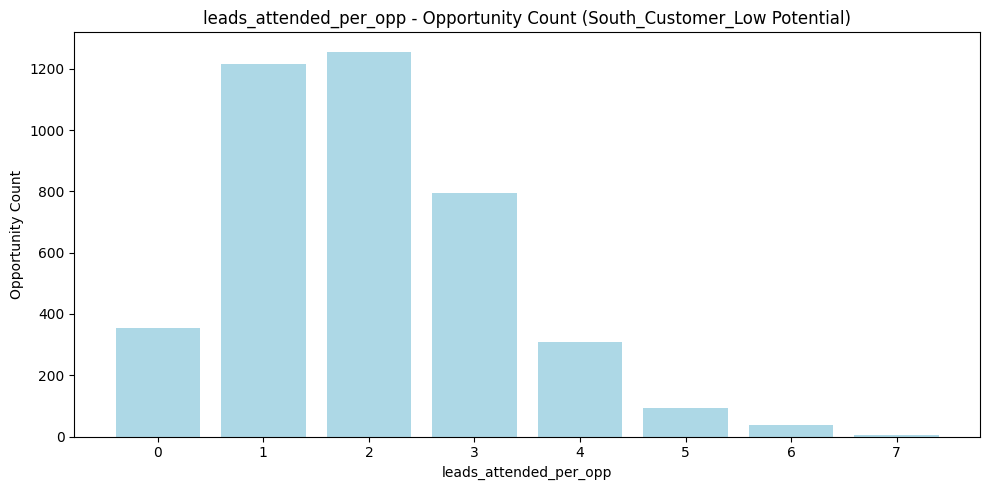

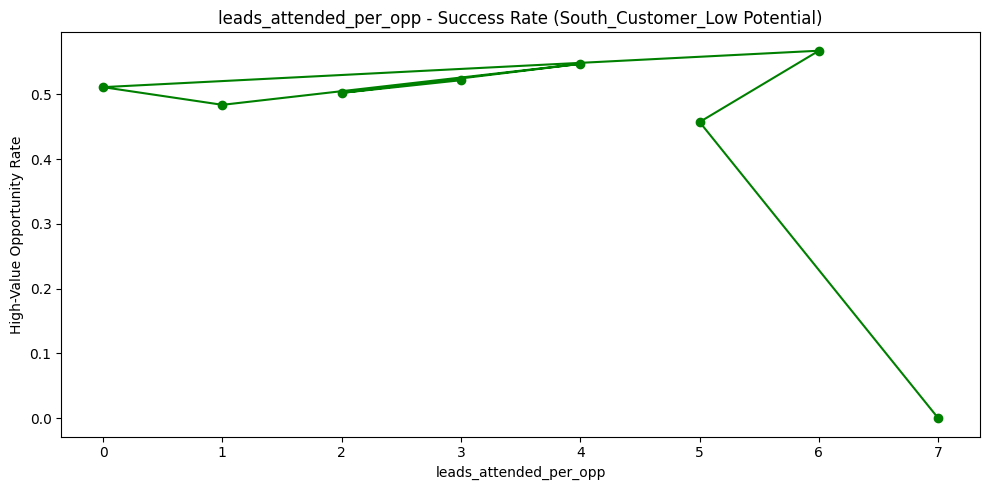


Feature: leads_attended_per_opp — South_Customer_Low Potential
   leads_attended_per_opp      mean  count  composite_score
3                     3.0  0.522013    795         0.924609
2                     2.0  0.502389   1256         0.919613
4                     4.0  0.547231    307         0.915798
1                     1.0  0.483977   1217         0.895580
0                     0.0  0.511299    354         0.877452
6                     6.0  0.567568     37         0.852915
5                     5.0  0.457447     94         0.755618
7                     7.0  0.000000      4         0.067657
✅ Recommended leads_attended_per_opp for South_Customer_Low Potential: 3.0

📊 Segment: South_Customer_High Potential


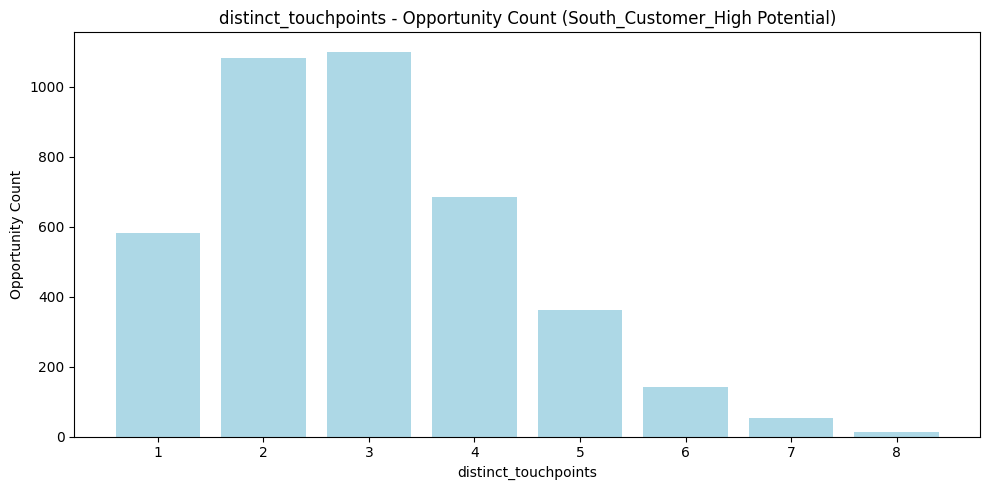

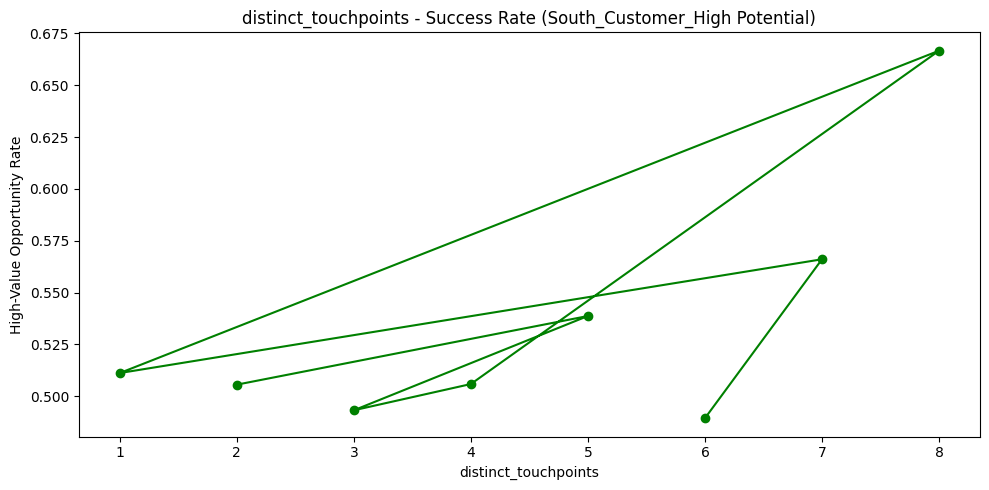


Feature: distinct_touchpoints — South_Customer_High Potential
   distinct_touchpoints      mean  count  composite_score
1                     2  0.505545   1082         0.830078
4                     5  0.538674    362         0.818049
2                     3  0.493188   1101         0.817847
3                     4  0.505848    684         0.810778
7                     8  0.666667     12         0.809850
0                     1  0.511149    583         0.809512
6                     7  0.566038     53         0.765177
5                     6  0.489362    141         0.726074
✅ Recommended distinct_touchpoints for South_Customer_High Potential: 2.0


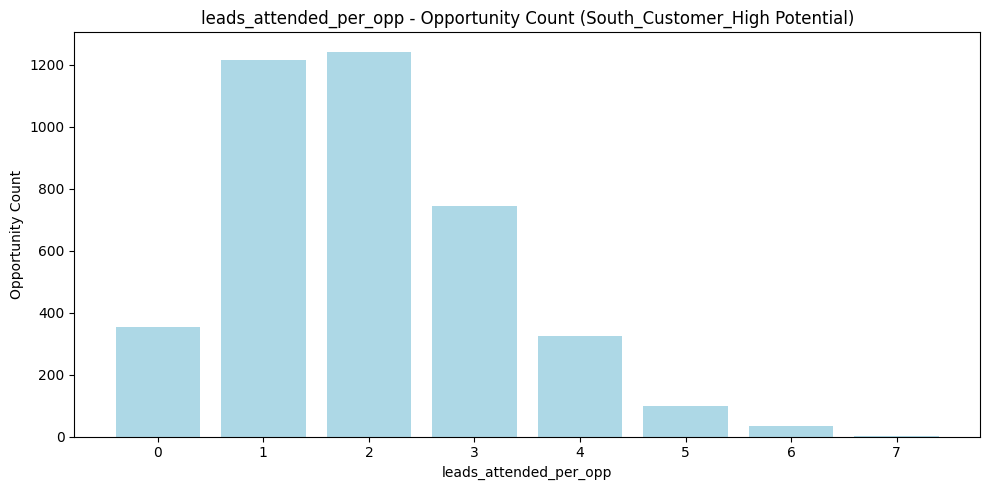

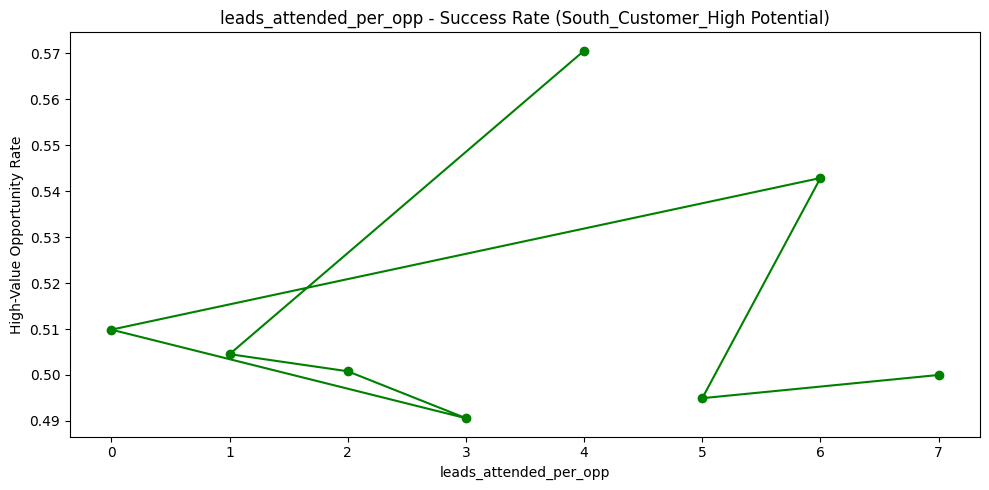


Feature: leads_attended_per_opp — South_Customer_High Potential
   leads_attended_per_opp      mean  count  composite_score
4                     4.0  0.570552    326         0.943778
1                     1.0  0.504527   1215         0.918070
2                     2.0  0.500805   1242         0.914429
3                     3.0  0.490591    744         0.880345
0                     0.0  0.509859    355         0.872893
6                     6.0  0.542857     35         0.816901
5                     5.0  0.494949     99         0.801139
7                     7.0  0.500000      2         0.659696
✅ Recommended leads_attended_per_opp for South_Customer_High Potential: 4.0

📊 Segment: East_Customer_Low Potential


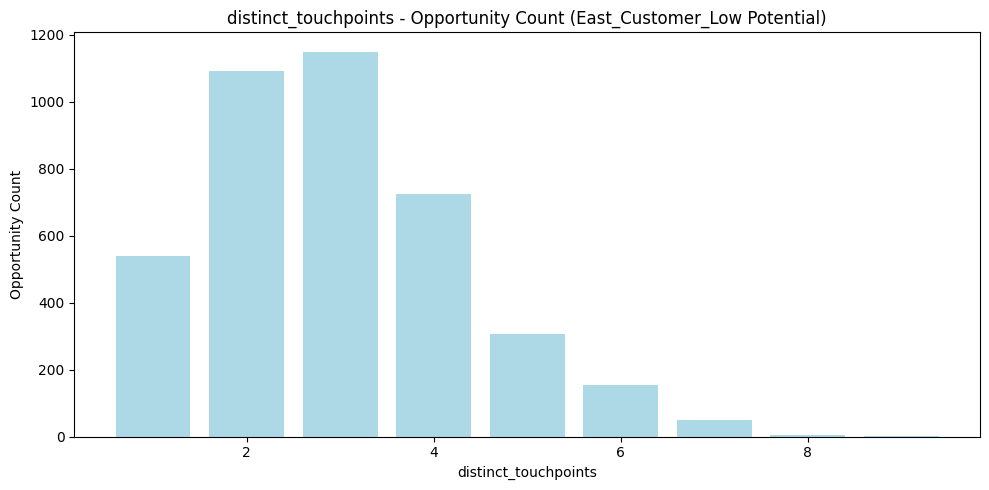

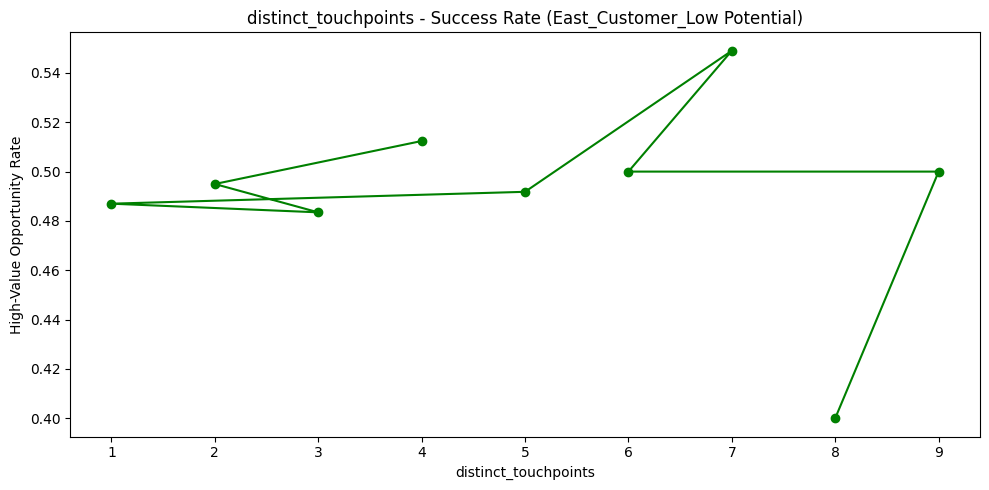


Feature: distinct_touchpoints — East_Customer_Low Potential
   distinct_touchpoints      mean  count  composite_score
3                     4  0.512397    726         0.933750
1                     2  0.494968   1093         0.928922
2                     3  0.483478   1150         0.916435
0                     1  0.486989    538         0.888620
4                     5  0.491803    305         0.870662
6                     7  0.549020     51         0.868177
5                     6  0.500000    154         0.852163
8                     9  0.500000      2         0.684260
7                     8  0.400000      5         0.586263
✅ Recommended distinct_touchpoints for East_Customer_Low Potential: 4.0


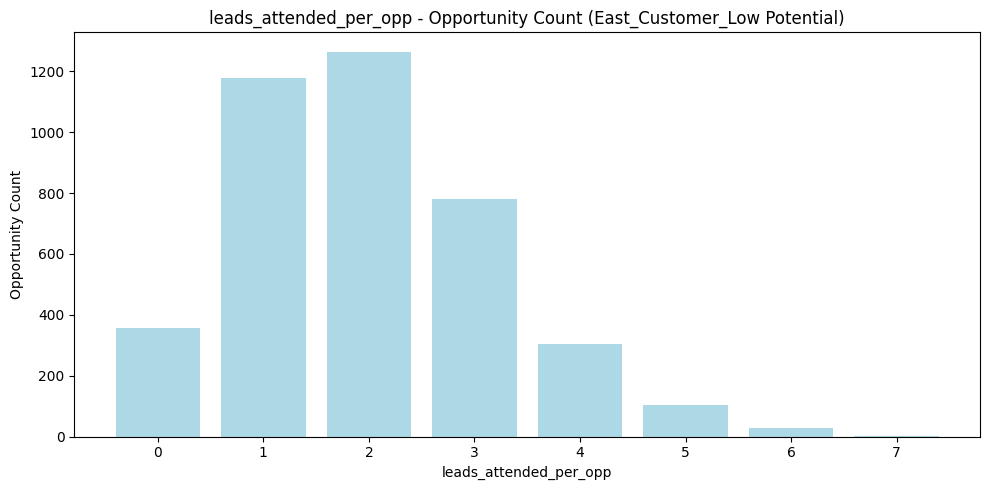

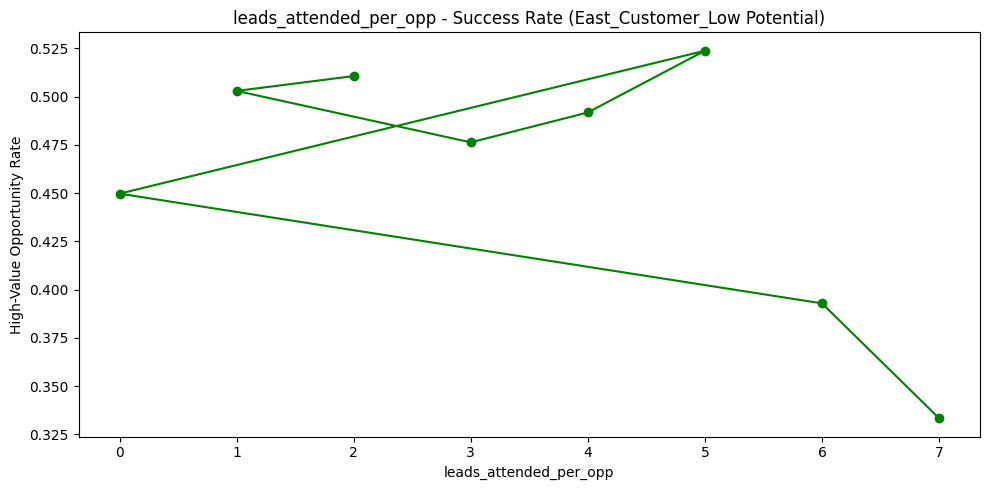


Feature: leads_attended_per_opp — East_Customer_Low Potential
   leads_attended_per_opp      mean  count  composite_score
2                     2.0  0.510672   1265         0.982443
1                     1.0  0.502969   1179         0.969195
3                     3.0  0.476312    781         0.916295
4                     4.0  0.491803    305         0.897593
5                     5.0  0.523810    105         0.895844
0                     0.0  0.449721    358         0.848064
6                     6.0  0.392857     28         0.666411
7                     7.0  0.333333      3         0.503673
✅ Recommended leads_attended_per_opp for East_Customer_Low Potential: 2.0

📊 Segment: West_Customer_High Potential


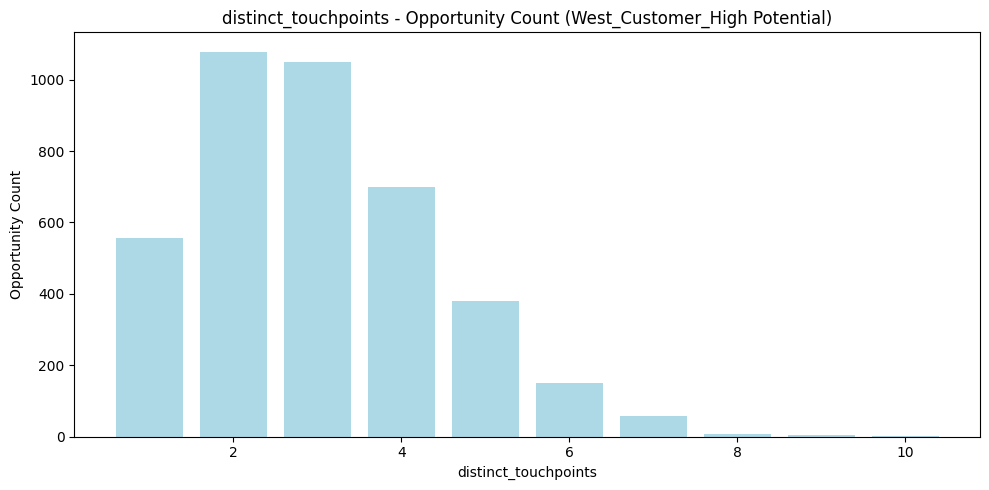

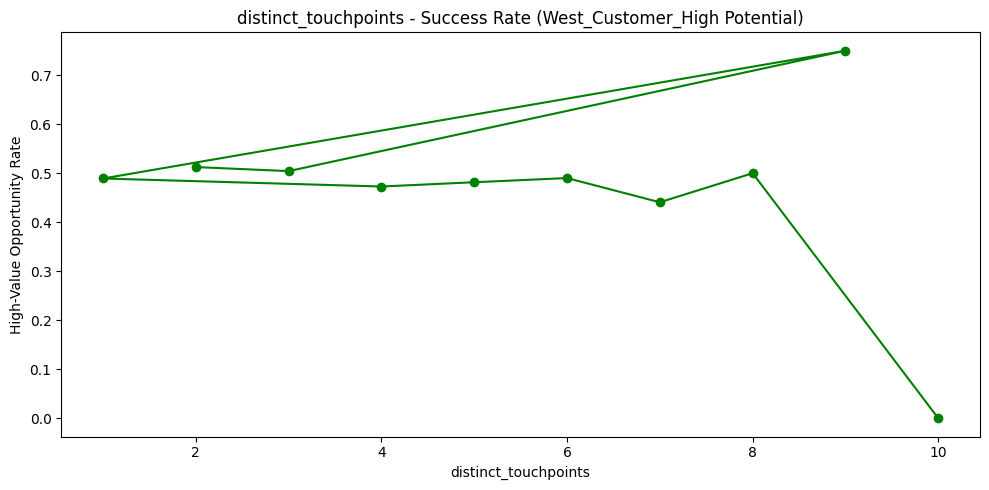


Feature: distinct_touchpoints — West_Customer_High Potential
   distinct_touchpoints      mean  count  composite_score
1                     2  0.512512   1079         0.778344
2                     3  0.504282   1051         0.769535
8                     9  0.750000      4         0.769127
0                     1  0.489209    556         0.728155
3                     4  0.472857    700         0.722770
4                     5  0.481579    380         0.704722
5                     6  0.490066    151         0.673175
6                     7  0.440678     59         0.587155
7                     8  0.500000      8         0.561039
9                    10  0.000000      1         0.029771
✅ Recommended distinct_touchpoints for West_Customer_High Potential: 2.0


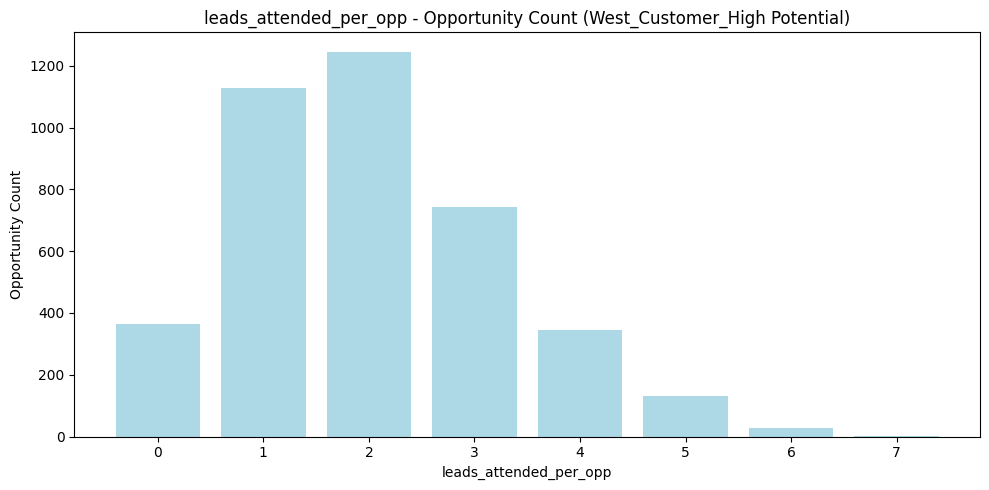

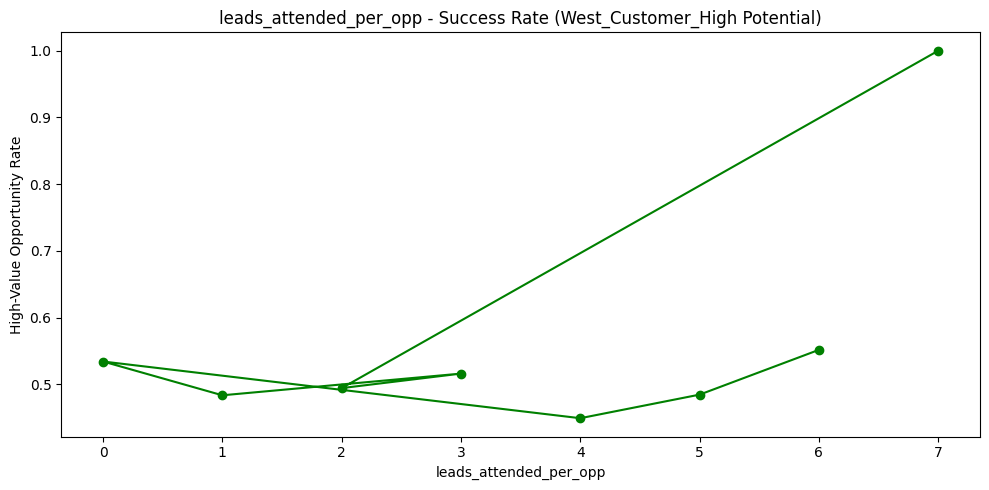


Feature: leads_attended_per_opp — West_Customer_High Potential
   leads_attended_per_opp      mean  count  composite_score
7                     7.0  1.000000      1         0.729171
2                     2.0  0.494382   1246         0.646067
3                     3.0  0.516129    744         0.639612
1                     1.0  0.483614   1129         0.634383
0                     0.0  0.534247    365         0.622383
4                     4.0  0.449275    345         0.560538
5                     5.0  0.484615    130         0.544402
6                     6.0  0.551724     29         0.529345
✅ Recommended leads_attended_per_opp for West_Customer_High Potential: 7.0


In [160]:
optimal_touchpoints_dict, optimal_contacts_dict = analyze_touchpoints_and_leads(df)

### 4.5.4 Segment Confidence Scores for Data Quantity <a id="confidence_scores"></a>

**We'll now calculate and assign confidence scores based on the opportunity samples for each segment.** The confidence level is tied to both the robustness of data and the practical reliability of the model outcomes, making it relevant for decision-making processes.

In [161]:
def calculate_confidence_score(num_samples):
    if num_samples > 5000:
        return 5  # High Confidence
    elif num_samples > 1000:
        return 4  # Confident
    elif num_samples > 500:
        return 3  # Moderately Confident
    elif num_samples > 250:
        return 2  # Somewhat Confident
    else:
        return 1  # Low Confidence

# Initialize confidence_scores_dict
confidence_scores_dict = {}

# Loop through segments and calculate
for segment_key in df['region_type'].unique():
    segment_data = df[df['region_type'] == segment_key]
    num_samples = len(segment_data)

    confidence_score = calculate_confidence_score(num_samples)

    # Save directly into dictionary
    confidence_scores_dict[segment_key] = confidence_score

    # Optional printout
    print(f"Segment: {segment_key} | Sample Size: {num_samples} | Confidence Score: {confidence_score}")

Segment: North_Customer_Low Potential | Sample Size: 4000 | Confidence Score: 4
Segment: East_Customer_High Potential | Sample Size: 3971 | Confidence Score: 4
Segment: South_Prospect_ | Sample Size: 15972 | Confidence Score: 5
Segment: West_Prospect_ | Sample Size: 15981 | Confidence Score: 5
Segment: North_Prospect_ | Sample Size: 15954 | Confidence Score: 5
Segment: North_Customer_High Potential | Sample Size: 4003 | Confidence Score: 4
Segment: West_Customer_Low Potential | Sample Size: 4077 | Confidence Score: 4
Segment: East_Prospect_ | Sample Size: 16140 | Confidence Score: 5
Segment: South_Customer_Low Potential | Sample Size: 4064 | Confidence Score: 4
Segment: South_Customer_High Potential | Sample Size: 4018 | Confidence Score: 4
Segment: East_Customer_Low Potential | Sample Size: 4024 | Confidence Score: 4
Segment: West_Customer_High Potential | Sample Size: 3989 | Confidence Score: 4


### 4.5.5 Vertical Analysis <a id="vertical_analysis"></a>

Same code as for program_mix and leads attended/touchpoints, but for vertical to see which verticals are best for high-value opps. 

Same weighted scoring using Composite Score as before. 

In [162]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from numpy import log1p

# Initialize dictionary
top_verticals_dict = {}

def analyze_verticals(df):
    # Ensure outcome is numeric
    if df['outcome'].dtype.name == 'category':
        df['outcome'] = df['outcome'].cat.codes

    for segment_key in df['region_type'].unique():
        segment_data = df[df['region_type'] == segment_key]

        if segment_data.empty:
            continue

        print(f"\n📊 Segment: {segment_key}")

        # Group by vertical
        grouped = segment_data.groupby('vertical')['outcome'].agg(['mean', 'count']).reset_index()

        # Normalize + Composite Score
        grouped['normalized_success'] = grouped['mean'] / grouped['mean'].max()
        grouped['normalized_count'] = log1p(grouped['count']) / log1p(grouped['count'].max())
        grouped['composite_score'] = (0.7 * grouped['normalized_success']) + (0.3 * grouped['normalized_count'])
        grouped.sort_values(by='composite_score', ascending=False, inplace=True)

        # 📊 Plot opportunity counts
        plt.figure(figsize=(10, 5))
        sns.barplot(data=grouped, x='vertical', y='count', color='lightblue')
        plt.xticks(rotation=45, ha='right')
        plt.ylabel('Opportunity Count')
        plt.title(f'Opportunity Count by Vertical – {segment_key}')
        plt.tight_layout()
        plt.show()

        # 📈 Plot success rate
        plt.figure(figsize=(10, 5))
        sns.lineplot(data=grouped, x='vertical', y='mean', marker='o', color='green')
        plt.xticks(rotation=45, ha='right')
        plt.ylabel('High-Value Opportunity Rate')
        plt.title(f'Success Rate by Vertical – {segment_key}')
        plt.tight_layout()
        plt.show()

        # 📄 Display table
        print("\nVertical Analysis Table:")
        print(grouped[['vertical', 'mean', 'count', 'composite_score']])

        # 🏆 Save top 1-3 verticals
        top_verticals = grouped['vertical'].head(3).tolist()
        top_verticals_dict[segment_key] = top_verticals

        print(f"✅ Recommended Verticals for {segment_key}: {top_verticals}")

    return top_verticals_dict


📊 Segment: North_Customer_Low Potential


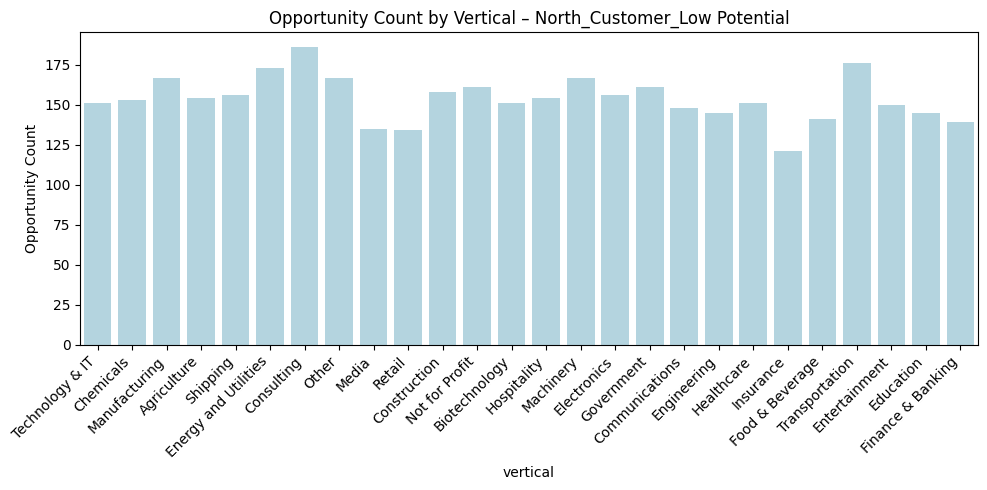

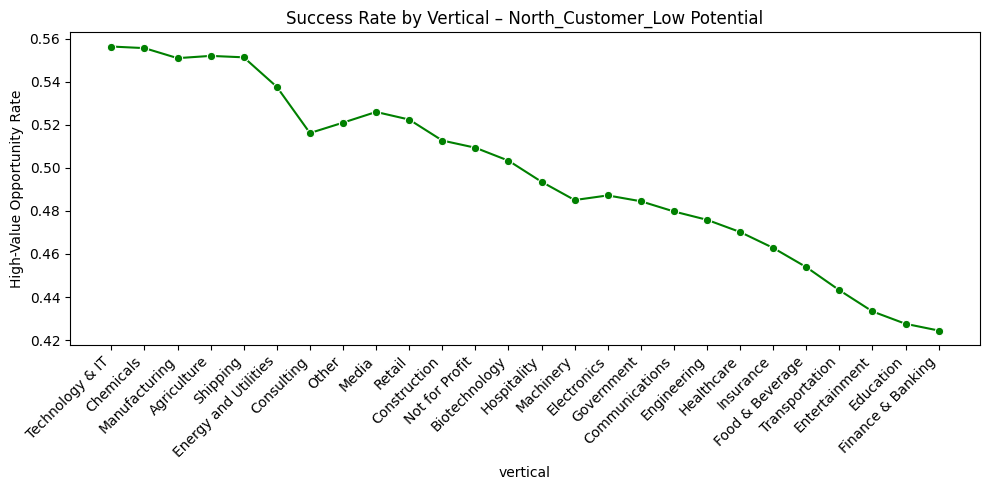


Vertical Analysis Table:
                vertical      mean  count  composite_score
24       Technology & IT  0.556291    151         0.988116
2              Chemicals  0.555556    153         0.987939
18         Manufacturing  0.550898    167         0.987069
0            Agriculture  0.551948    154         0.983771
23              Shipping  0.551282    156         0.983668
8   Energy and Utilities  0.537572    173         0.972313
5             Consulting  0.516129    186         0.949462
21                 Other  0.520958    167         0.949394
19                 Media  0.525926    135         0.943527
22                Retail  0.522388    134         0.938652
4           Construction  0.512658    158         0.935793
20        Not for Profit  0.509317    161         0.932660
1          Biotechnology  0.503311    151         0.921449
15           Hospitality  0.493506    154         0.910232
17             Machinery  0.485030    167         0.904185
7            Electronics  0.48

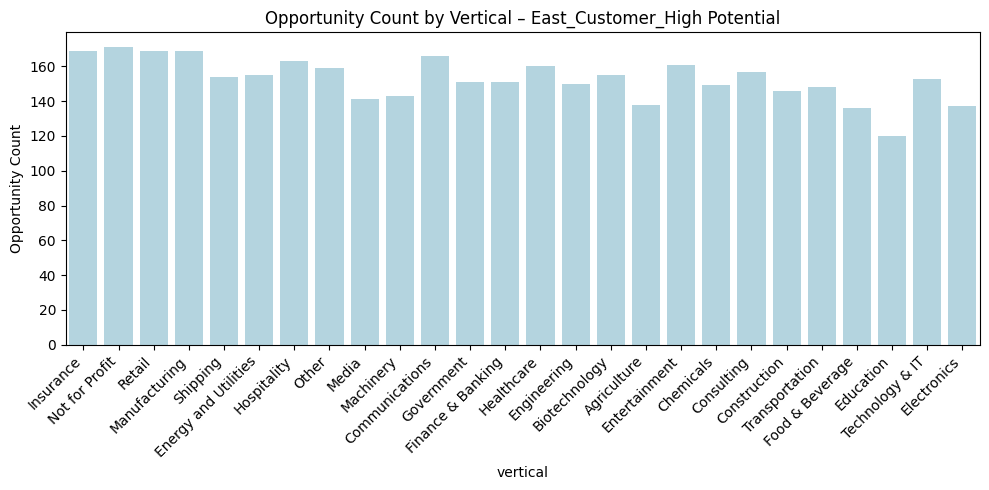

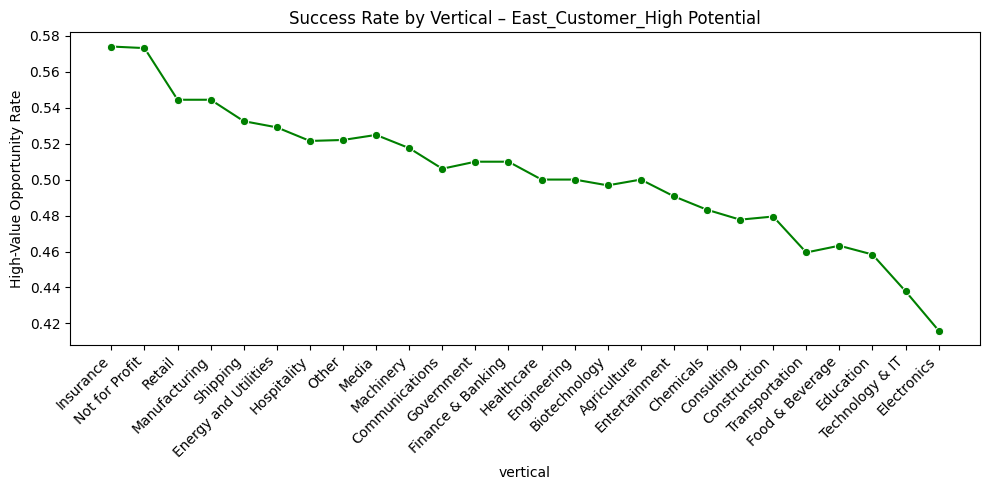


Vertical Analysis Table:
                vertical      mean  count  composite_score
16             Insurance  0.573964    169         0.999318
20        Not for Profit  0.573099    171         0.998945
22                Retail  0.544379    169         0.963236
18         Manufacturing  0.544379    169         0.963236
23              Shipping  0.532468    154         0.943326
8   Energy and Utilities  0.529032    155         0.939511
15           Hospitality  0.521472    163         0.933205
21                 Other  0.522013    159         0.932425
19                 Media  0.524823    141         0.928897
17             Machinery  0.517483    143         0.920760
3         Communications  0.506024    166         0.915421
13            Government  0.509934    151         0.914705
11     Finance & Banking  0.509934    151         0.914705
14            Healthcare  0.500000    160         0.905942
9            Engineering  0.500000    150         0.902205
1          Biotechnology  0.49

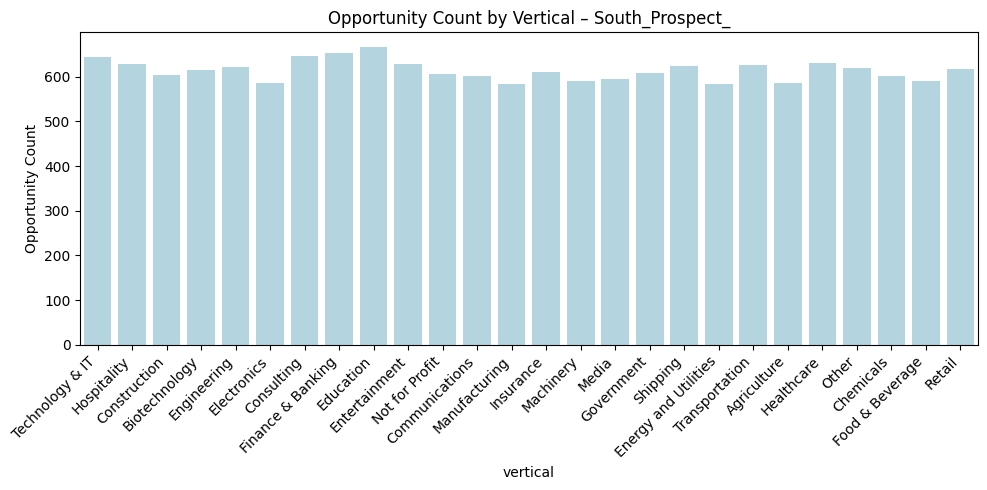

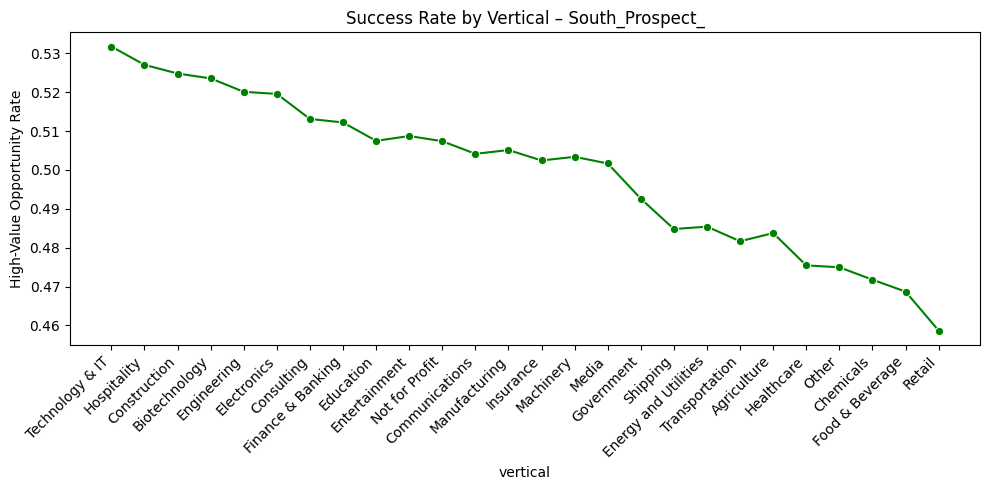


Vertical Analysis Table:
                vertical      mean  count  composite_score
24       Technology & IT  0.531783    645         0.998524
15           Hospitality  0.527070    628         0.991090
4           Construction  0.524834    604         0.986353
1          Biotechnology  0.523577    615         0.985529
9            Engineering  0.520129    621         0.981437
7            Electronics  0.519591    587         0.978136
5             Consulting  0.513138    647         0.974123
11     Finance & Banking  0.512232    654         0.973428
6              Education  0.507508    666         0.968046
10         Entertainment  0.508744    629         0.967040
20        Not for Profit  0.507414    607         0.963649
3         Communications  0.504160    601         0.958909
18         Manufacturing  0.505137    584         0.958873
16             Insurance  0.502455    611         0.957425
17             Machinery  0.503390    590         0.957044
19                 Media  0.50

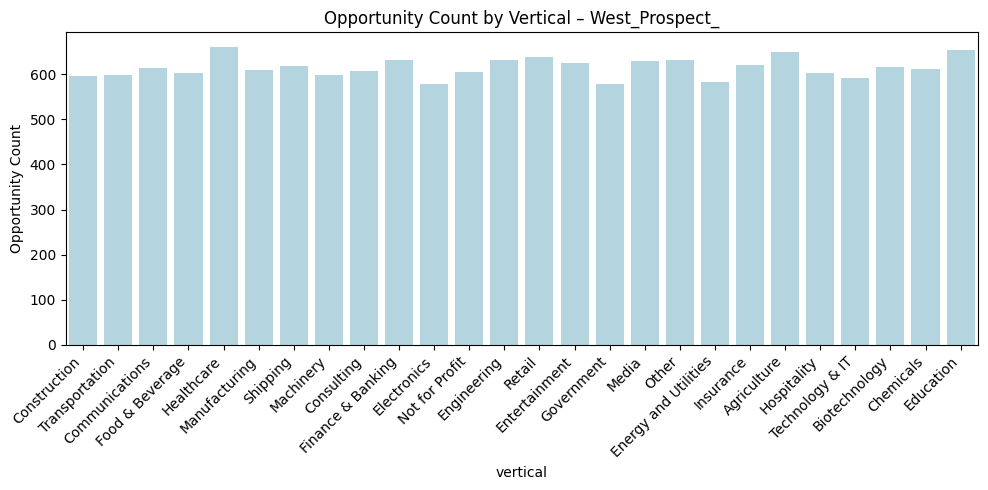

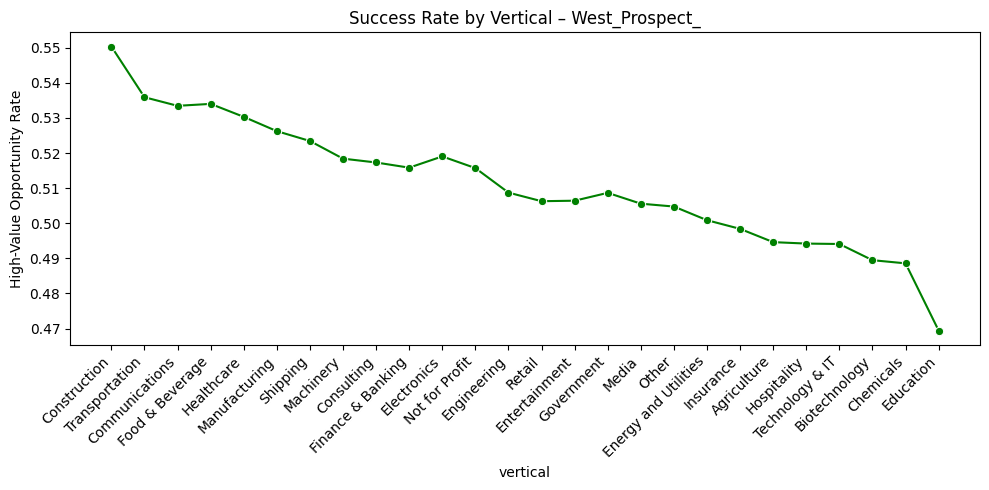


Vertical Analysis Table:
                vertical      mean  count  composite_score
4           Construction  0.550336    596         0.995295
25        Transportation  0.535893    599         0.977157
3         Communications  0.533442    613         0.975105
12       Food & Beverage  0.533997    603         0.975052
14            Healthcare  0.530303    660         0.974520
18         Manufacturing  0.526230    610         0.965704
23              Shipping  0.523425    619         0.962813
17             Machinery  0.518395    598         0.954823
5             Consulting  0.517298    607         0.954117
11     Finance & Banking  0.515823    632         0.954102
7            Electronics  0.519031    578         0.954063
20        Not for Profit  0.515702    605         0.951935
9            Engineering  0.508716    631         0.944990
22                Retail  0.506270    638         0.942386
10         Entertainment  0.506410    624         0.941542
13            Government  0.50

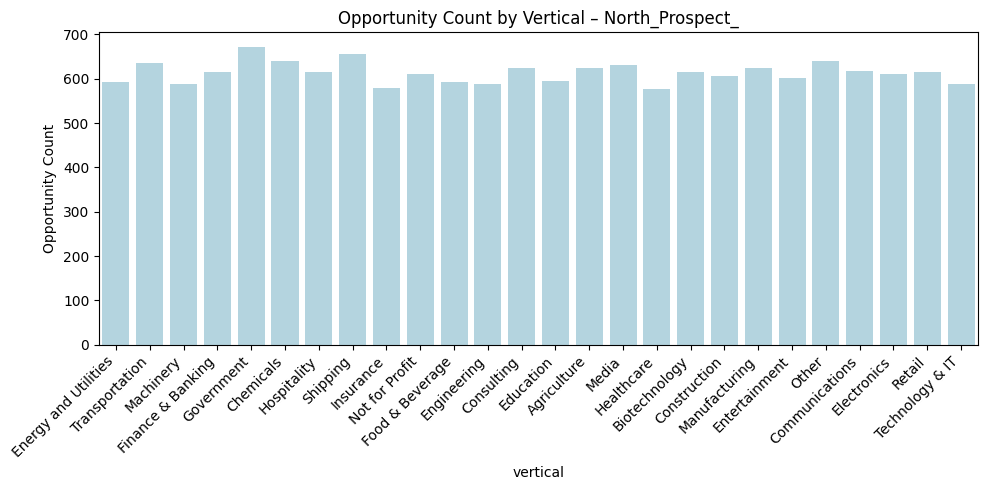

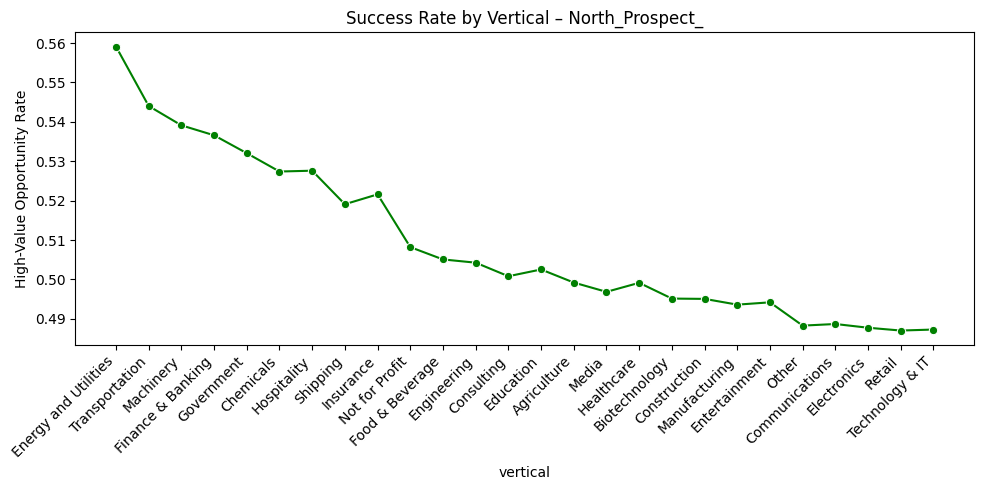


Vertical Analysis Table:
                vertical      mean  count  composite_score
8   Energy and Utilities  0.559122    592         0.994237
25        Transportation  0.544025    636         0.978635
17             Machinery  0.539116    588         0.968878
11     Finance & Banking  0.536585    615         0.967776
13            Government  0.532042    671         0.966097
2              Chemicals  0.527387    639         0.958021
15           Hospitality  0.527597    616         0.956598
23              Shipping  0.519084    655         0.948764
16             Insurance  0.521589    579         0.946226
20        Not for Profit  0.508197    610         0.931859
12       Food & Beverage  0.505068    592         0.926563
9            Engineering  0.504244    589         0.925299
5             Consulting  0.500800    625         0.923716
6              Education  0.502521    595         0.923608
0            Agriculture  0.499197    623         0.921562
19                 Media  0.49

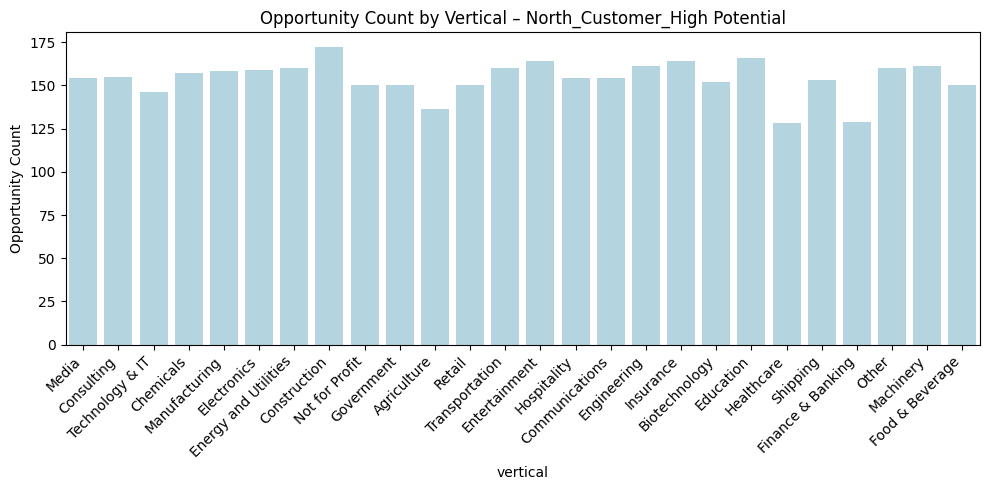

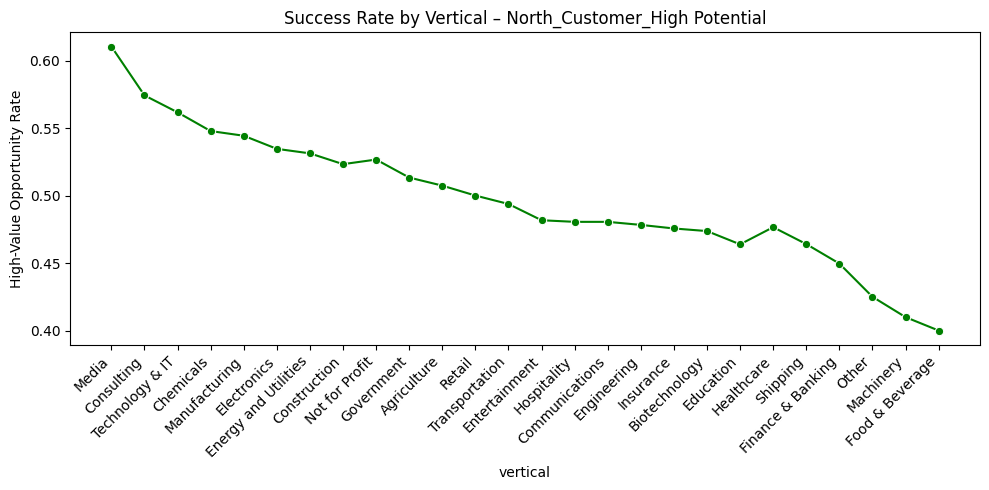


Vertical Analysis Table:
                vertical      mean  count  composite_score
19                 Media  0.610390    154         0.993604
5             Consulting  0.574194    155         0.952469
24       Technology & IT  0.561644    146         0.934617
2              Chemicals  0.547771    157         0.922908
18         Manufacturing  0.544304    158         0.919300
7            Electronics  0.534591    159         0.908526
8   Energy and Utilities  0.531250    160         0.905057
4           Construction  0.523256    172         0.900074
20        Not for Profit  0.526667    150         0.896068
13            Government  0.513333    150         0.880777
0            Agriculture  0.507353    136         0.868254
22                Retail  0.500000    150         0.865486
25        Transportation  0.493750    160         0.862052
10         Entertainment  0.481707    164         0.849670
15           Hospitality  0.480519    154         0.844668
3         Communications  0.48

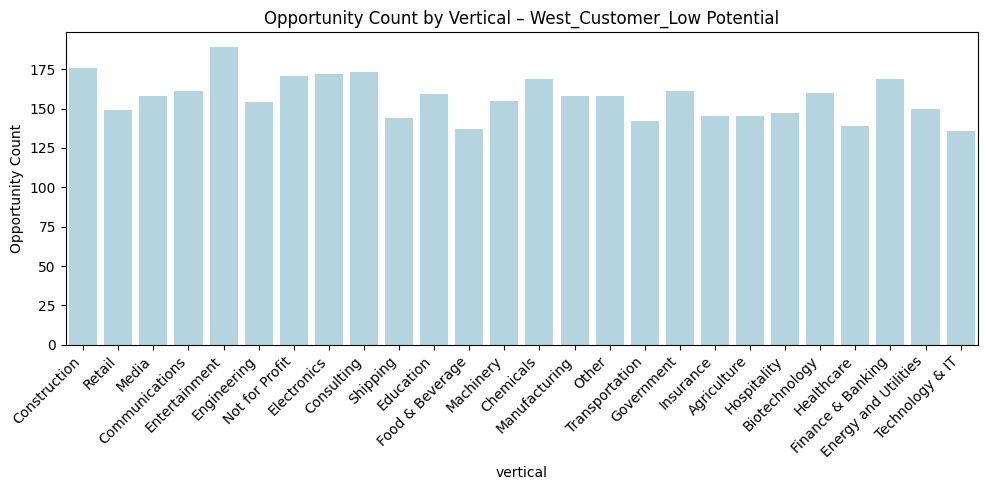

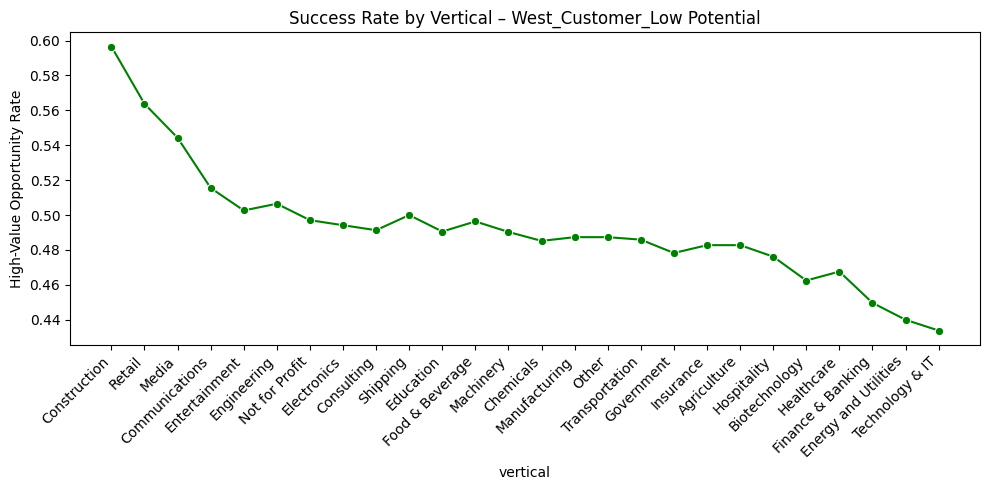


Vertical Analysis Table:
                vertical      mean  count  composite_score
4           Construction  0.596591    176         0.995948
22                Retail  0.563758    149         0.947961
19                 Media  0.544304    158         0.928466
3         Communications  0.515528    161         0.895771
10         Entertainment  0.502646    189         0.889771
9            Engineering  0.506494    154         0.882645
20        Not for Profit  0.497076    171         0.877545
7            Electronics  0.494186    172         0.874486
5             Consulting  0.491329    173         0.871464
23              Shipping  0.500000    144         0.871213
6              Education  0.490566    159         0.865772
12       Food & Beverage  0.496350    137         0.864101
17             Machinery  0.490323    155         0.864039
2              Chemicals  0.485207    169         0.862950
18         Manufacturing  0.487342    158         0.861630
21                 Other  0.48

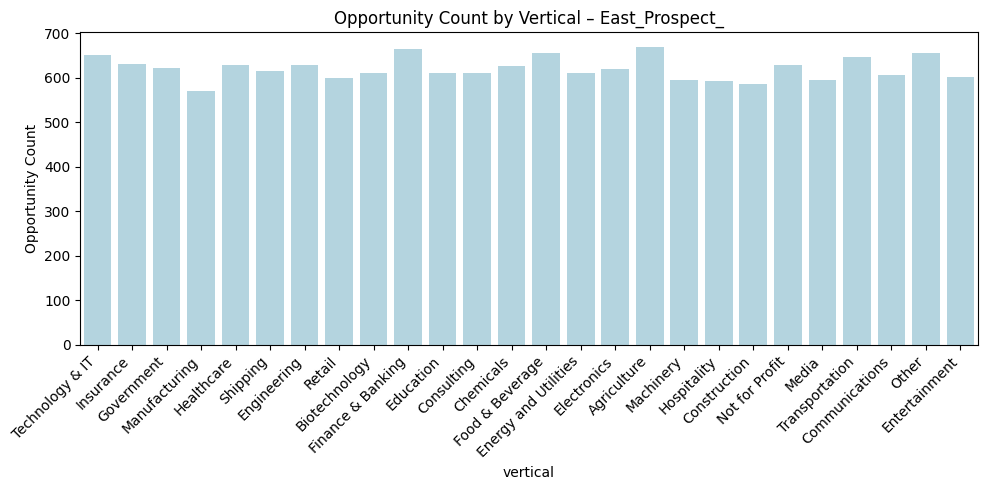

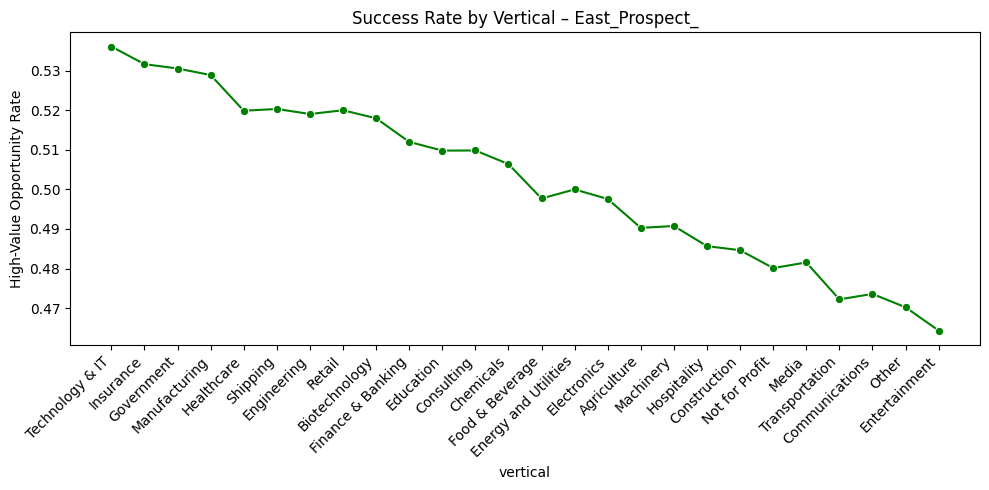


Vertical Analysis Table:
                vertical      mean  count  composite_score
24       Technology & IT  0.536098    651         0.998744
16             Insurance  0.531646    632         0.991567
13            Government  0.530547    622         0.989398
18         Manufacturing  0.528897    571         0.983306
14            Healthcare  0.519873    629         0.975976
23              Shipping  0.520325    615         0.975531
9            Engineering  0.519048    630         0.974972
22                Retail  0.520000    600         0.973969
1          Biotechnology  0.517974    612         0.972235
11     Finance & Banking  0.512012    666         0.968343
6              Education  0.509804    612         0.961568
5             Consulting  0.509836    610         0.961459
2              Chemicals  0.506390    626         0.958151
12       Food & Beverage  0.497710    655         0.948902
8   Energy and Utilities  0.500000    610         0.948616
7            Electronics  0.49

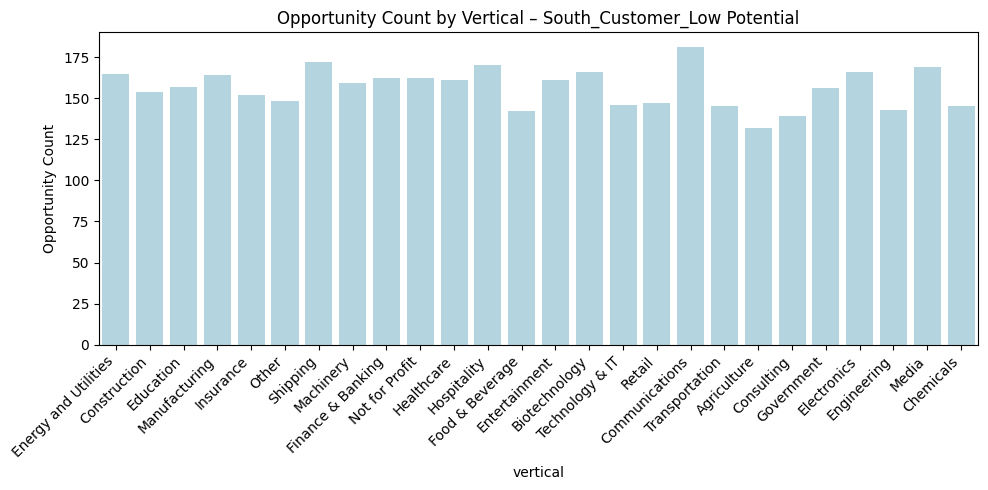

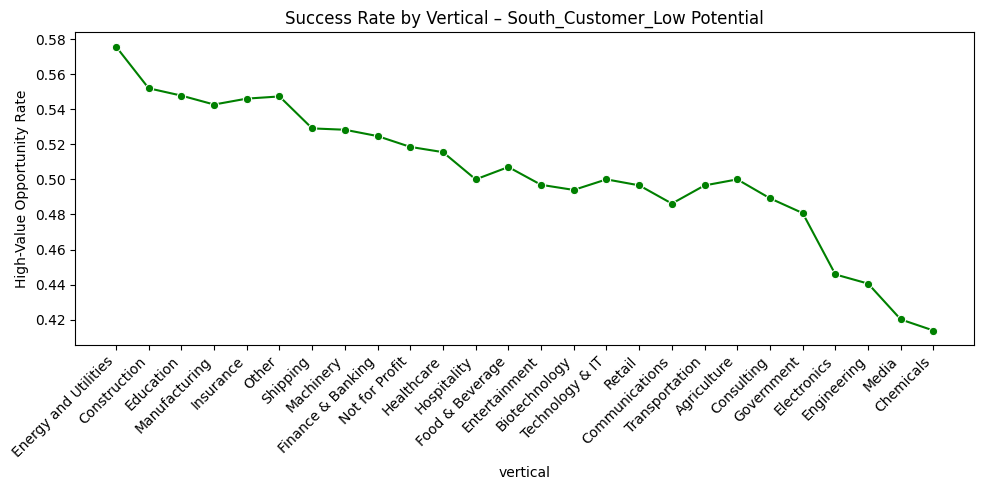


Vertical Analysis Table:
                vertical      mean  count  composite_score
8   Energy and Utilities  0.575758    165         0.994695
4           Construction  0.551948    154         0.961795
6              Education  0.547771    157         0.957822
18         Manufacturing  0.542683    164         0.954135
16             Insurance  0.546053    152         0.953879
21                 Other  0.547297    148         0.953865
23              Shipping  0.529070    172         0.940314
17             Machinery  0.528302    159         0.934877
11     Finance & Banking  0.524691    162         0.931558
20        Not for Profit  0.518519    162         0.924053
14            Healthcare  0.515528    161         0.920063
15           Hospitality  0.500000    170         0.904301
12       Food & Beverage  0.507042    142         0.902554
10         Entertainment  0.496894    161         0.897408
1          Biotechnology  0.493976    166         0.895612
24       Technology & IT  0.50

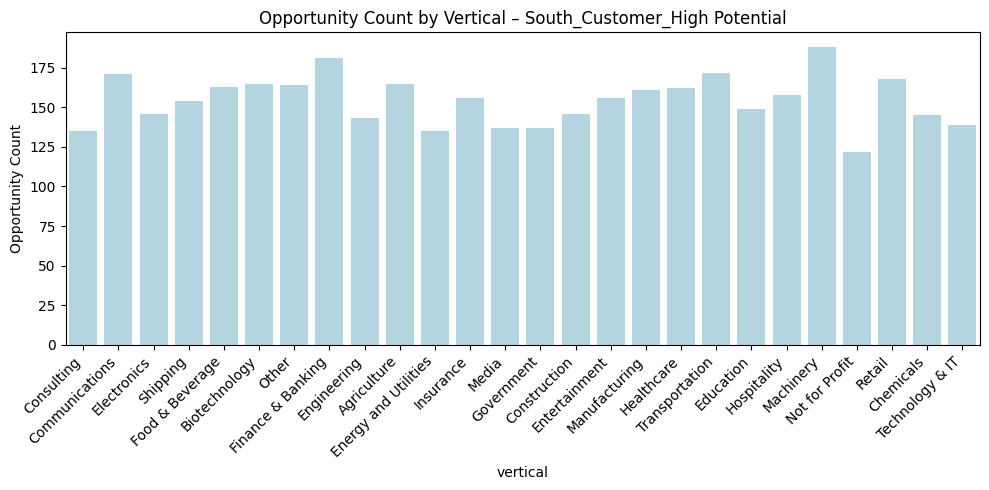

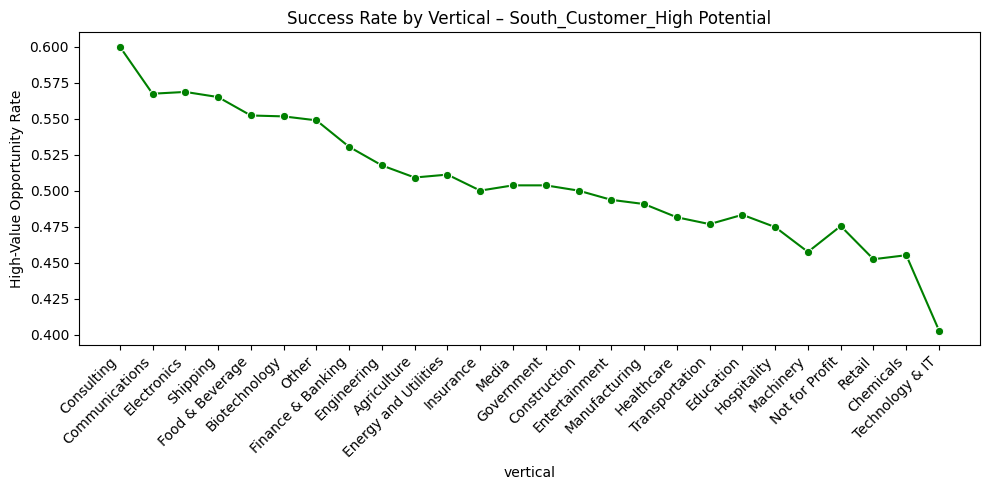


Vertical Analysis Table:
                vertical      mean  count  composite_score
5             Consulting  0.600000    135         0.981165
3         Communications  0.567251    171         0.956399
7            Electronics  0.568493    146         0.948859
23              Shipping  0.564935    154         0.947740
12       Food & Beverage  0.552147    163         0.936052
1          Biotechnology  0.551515    165         0.936008
21                 Other  0.548780    164         0.932472
11     Finance & Banking  0.530387    181         0.916625
9            Engineering  0.517483    143         0.888166
0            Agriculture  0.509091    165         0.886513
8   Energy and Utilities  0.511111    135         0.877461
16             Insurance  0.500000    156         0.872717
19                 Media  0.503650    137         0.869592
13            Government  0.503650    137         0.869592
4           Construction  0.500000    146         0.868950
10         Entertainment  0.49

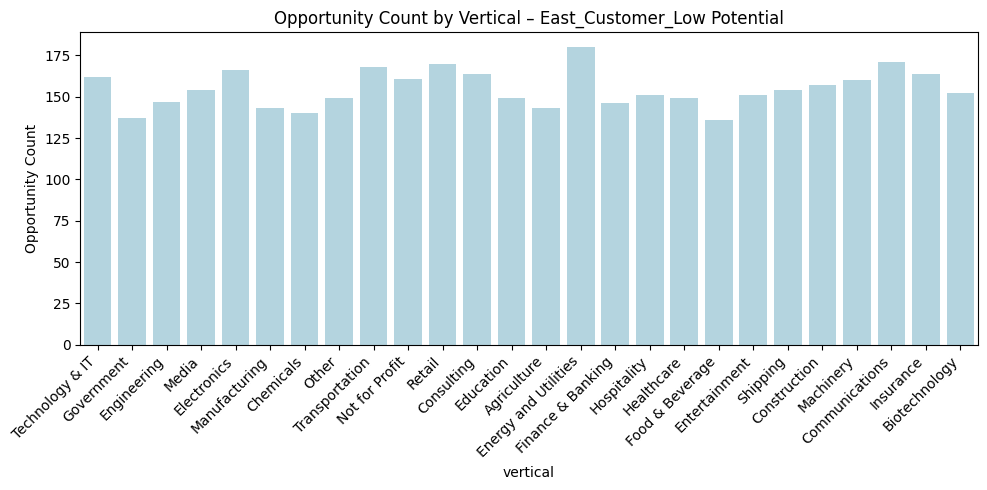

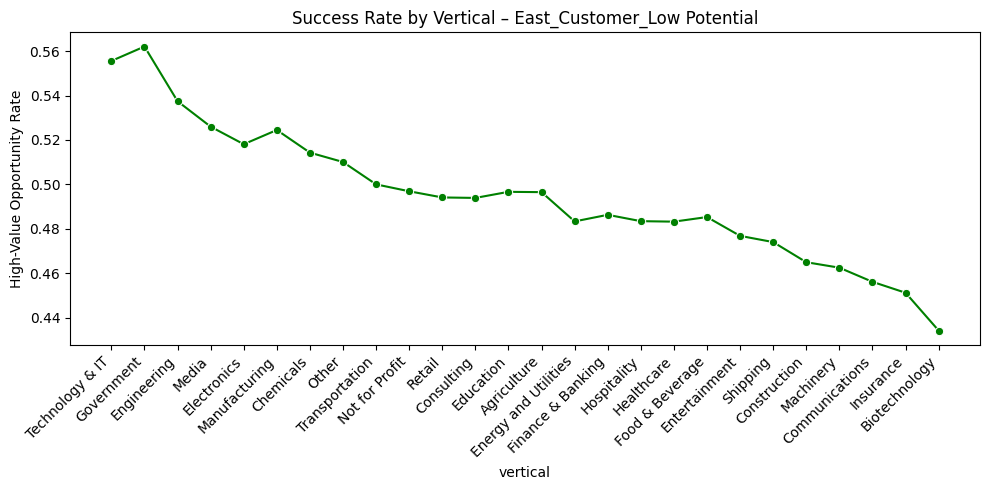


Vertical Analysis Table:
                vertical      mean  count  composite_score
24       Technology & IT  0.555556    162         0.985874
13            Government  0.562044    137         0.984347
9            Engineering  0.537415    147         0.957710
19                 Media  0.525974    154         0.946128
7            Electronics  0.518072    166         0.940590
18         Manufacturing  0.524476    143         0.940013
2              Chemicals  0.514286    140         0.926107
21                 Other  0.510067    149         0.924424
25        Transportation  0.500000    168         0.918769
20        Not for Profit  0.496894    161         0.912459
22                Retail  0.494118    170         0.912121
5             Consulting  0.493902    164         0.909792
6              Education  0.496644    149         0.907707
0            Agriculture  0.496503    143         0.905175
8   Energy and Utilities  0.483333    180         0.901970
11     Finance & Banking  0.48

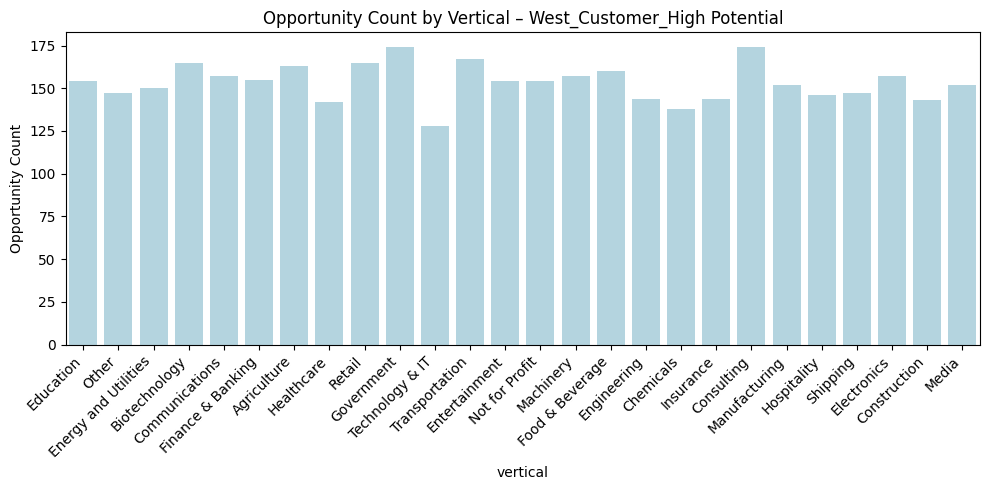

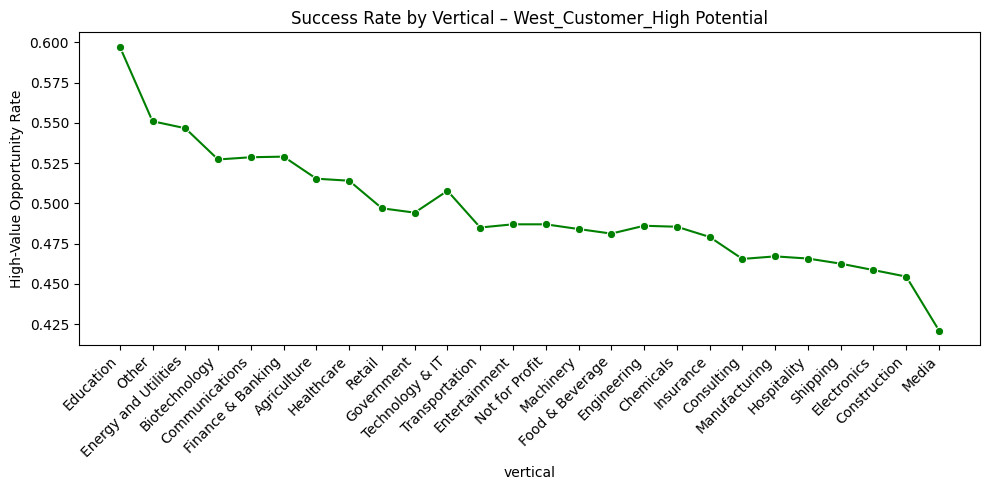


Vertical Analysis Table:
                vertical      mean  count  composite_score
6              Education  0.597403    154         0.992951
21                 Other  0.551020    147         0.935919
8   Energy and Utilities  0.546667    150         0.931983
1          Biotechnology  0.527273    165         0.914759
3         Communications  0.528662    157         0.913519
11     Finance & Banking  0.529032    155         0.913212
0            Agriculture  0.515337    163         0.900070
14            Healthcare  0.514085    142         0.890643
22                Retail  0.496970    165         0.879252
13            Government  0.494253    174         0.879135
24       Technology & IT  0.507812    128         0.877309
25        Transportation  0.485030    167         0.865957
10         Entertainment  0.487013    154         0.863603
20        Not for Profit  0.487013    154         0.863603
17             Machinery  0.484076    157         0.861275
12       Food & Beverage  0.48

In [163]:
top_verticals_dict = analyze_verticals(df)

## 4.6 All-In-One Recommendation Generator <a id="rec_generator"></a>

In [164]:
counts_by_segment = df.groupby('region_type')['opportunity_id'].count()
print(counts_by_segment)

region_type
East_Customer_High Potential      3971
East_Customer_Low Potential       4024
East_Prospect_                   16140
North_Customer_High Potential     4003
North_Customer_Low Potential      4000
North_Prospect_                  15954
South_Customer_High Potential     4018
South_Customer_Low Potential      4064
South_Prospect_                  15972
West_Customer_High Potential      3989
West_Customer_Low Potential       4077
West_Prospect_                   15981
Name: opportunity_id, dtype: int64


Below is a cohesive recommendation engine that will:
1. Loop through each region_type segment.
2. Generate persona-specific recommendations based on:
- Optimal distinct_touchpoints.
- Optimal leads_attended_per_opp.
- Recommended program_mix.
- Top verticals.
- Include confidence score based on opportunity count.

3. Output everything into a single recommendation table.

In [165]:
def generate_recommendation_table(region_types,
                                  persona_types,
                                  touchpoints_dict,
                                  contacts_attended_dict,
                                  program_mix_dict,
                                  top_verticals_dict,
                                  confidence_scores_dict):
    
    recommendations = []

    for segment_key in region_types:
        for persona in persona_types:
            
            # Fetch insights
            min_touchpoints = touchpoints_dict.get(segment_key, 4)
            min_contacts_attended = contacts_attended_dict.get(segment_key, 2)
            recommended_mix = program_mix_dict.get(segment_key, "2 Events & 2 Webinars & 1 Pathfactory")
            top_verticals = ", ".join(top_verticals_dict.get(segment_key, ["N/A"]))
            confidence_score = confidence_scores_dict.get(segment_key, 1)

            # Persona adjustments (if desired)
            if persona == "Technical":
                min_contacts_attended = max(3, min_contacts_attended)
            elif persona == "Exec Decision Makers":
                min_contacts_attended = max(2, min_contacts_attended)
                # Optionally adjust program_mix for execs if desired

            # Build recommendation row
            recommendations.append({
                'Region Type': segment_key,
                'Persona Type': persona,
                'Min Touchpoints': min_touchpoints,
                'Min Contacts Attended': f"{min_contacts_attended}+",
                'Recommended Program Mix': recommended_mix,
                'Top Verticals': top_verticals,
                'Confidence Score': confidence_score
            })

    # Convert to DataFrame
    recommendations_df = pd.DataFrame(recommendations)

    return recommendations_df

In [166]:
persona_types = ['Technical', 'Exec Decision Makers']

recommendation_df = generate_recommendation_table(
    region_types = df['region_type'].unique(),
    persona_types = persona_types,
    touchpoints_dict = optimal_touchpoints_dict,
    contacts_attended_dict = optimal_contacts_dict,
    program_mix_dict = recommended_program_mix_dict,
    top_verticals_dict = top_verticals_dict,
    confidence_scores_dict = confidence_scores_dict
)

# View or save
print(recommendation_df)
recommendation_df.to_csv('final_recommendation_table.csv', index=False)

                      Region Type          Persona Type  Min Touchpoints  \
0    North_Customer_Low Potential             Technical             10.0   
1    North_Customer_Low Potential  Exec Decision Makers             10.0   
2    East_Customer_High Potential             Technical              3.0   
3    East_Customer_High Potential  Exec Decision Makers              3.0   
4                 South_Prospect_             Technical              2.0   
5                 South_Prospect_  Exec Decision Makers              2.0   
6                  West_Prospect_             Technical              3.0   
7                  West_Prospect_  Exec Decision Makers              3.0   
8                 North_Prospect_             Technical              3.0   
9                 North_Prospect_  Exec Decision Makers              3.0   
10  North_Customer_High Potential             Technical              9.0   
11  North_Customer_High Potential  Exec Decision Makers              9.0   
12    West_C

## 4.7 Summary <a id="summary"></a>

**We began this project with the goal of predicting which features were most predictive of high-value opps and providing strategic recommendations for stakeholders**. To do this, we loaded 2.5 years of historical opps and marketing data (July 2022 - 2024), **cleaned** it, performed **exploratory data analysis (EDA)**, and did extensive **data preprocessing**, which included: 
- Engineering helpful features: marketing touchpoints timing, marketing touchpoints per opp, leads engaged per opp, outcome target variable, target segments, verticals, program mix.
- Defining preprocessor and pipeline
- Training/testing splits
- Applying pipeline (scaling, encoding, model training)

We then moved on to **modeling**, building a number of statistical models (Log Reg, RF, GBM, SVM) and testing out each to determine the highest performer. We then: 
- Tuned the hyperparameters
- Trained the best model
- Adjusted the classification threshold to boost recall
- Performed cross validation (CV)
- Visualized Feature Importances

Then, we **built separate RF models for each individual region_type segment**, where we performed multiple **analyses to determine specific data recommendations** per segment: 
- Program Mix Outcomes
- Distinct Touchpoints & Leads Attended
- Segment Confidence Scores for Data Quantity
- Verticals

Finally, we **built a recommendation engine: a system that generates persona-targeted, segment-specific marketing recommendations based on predictive modeling outcomes and historical engagement data.** 

Ultimately, this was an end-to-end data science project that accomplished its goal: **we now have data-driven recommendations that act as a predictive guide for marketers in developing strategies for opening high-value opps**. 